In [1]:
#for reading files
import glob
import tifffile

#math computation and data organization
import numpy as np
import math
import scipy
from scipy.ndimage import binary_erosion, binary_fill_holes
from scipy import optimize
from scipy.optimize import curve_fit
import pandas as pd

# For loading bars
from tqdm.notebook import tqdm as tqdm

#For image plotting
import skimage.io
from skimage import restoration

#For identifying aster center
from skimage.filters import threshold_otsu, gaussian, threshold_mean
from skimage.measure import regionprops
import cv2

#for fitting
from lmfit import minimize, Parameters, fit_report

#for image registration
from skimage.registration import phase_cross_correlation
import os

#Matplotlib plotting packages
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
import matplotlib.colors as mcolors
import matplotlib.cm as cm
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import patches
from matplotlib import gridspec

import seaborn as sns
sns.set_context("poster")
sns.set_style("ticks")

#Movie
import celluloid as cell
import matplotlib.animation as animation

#for saving data
import csv
import h5py

#for abel transform
import abel

# #custom analysis packages
# import aster_packages as ap #### commented out 20241114 since lucida fonts are not installed...

# Thing to enable lovely parallelization
import concurrent.futures

# Enable repeat from itertools for parallel
import itertools

#time elements for testing runtimes and using todays date
import time
from datetime import datetime

In [2]:
######### gabe hacky styling to emulate some of PBoC Phillips lab style conventions, however hacky. tries to make easier for nigel++
## Styling
import matplotlib
import matplotlib.ticker as ticker
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_context("poster")
# sns.set_style('ticks')

import matplotlib.colors as mcolors
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Set the property to save figures with text as text, not paths
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

# default good PBoC colors
baseBlendColor=(224/255, 219/255, 209/255,1) # default background for plots
contrastColor=(209/255, 193/255, 171/255,1) # slightly darker tan for contrasts, e.g. in inset boxes
yellowTanHighlightBoxColor='#FEF0C6'
goodGreyGreenArrowColor='#CCD4C9'

### Griffin style invocation

from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.path import Path
from matplotlib.patches import BoxStyle
from matplotlib.offsetbox import AnchoredText

def plotting_style(grid=False):
    """
    Sets the style to the publication style. To instantiate, simply call
    plotting_style() at the beginning of your script or notebook to force
    all matplotlib plots to adopt the scheme.

    Parameters
    ----------
    grid: bool
      If True, plots will have a thin, white grid in the background. Default
      is False.

    Returns
    -------
    colors: dict
      Returns a dictionary of the standard PBoC 2e color palette.
    """
    rc = {'axes.facecolor': '#E3DCD0',
#               'axes.spines.top': False,
#               'axes.spines.right': False,
#               'axes.spines.left': False,  # Ensure left spine is present
#               'axes.spines.bottom': False,  # Ensure bottom spine is present
#               'axes.spines.left': False, #{'color': '#E3DCD0', 'linewidth': 1.5},  # Set the spine color to the background color
#               'axes.spines.bottom': False, #{'color': '#E3DCD0', 'linewidth': 1.5},  # Set the spine color to the background color
          #'font.family': '/usr/share/fonts/truetype/LucidaSansOT.otf', #'LucidaSansOT.otf',
          'grid.linestyle': '-',
          'grid.linewidth': 0.5,
          'grid.alpha': 0.75,
          'grid.color': '#ffffff',
          'axes.grid': grid,
          'ytick.direction': 'in',
          'xtick.direction': 'in',
          'xtick.gridOn': grid,
          'ytick.gridOn': grid,
#               'ytick.major.width':8,
#               'xtick.major.width':8,
#               'ytick.major.size': 8,
#               'xtick.major.size': 8,
          'mathtext.fontset': 'stixsans',
          'mathtext.sf': 'sans',
          'legend.frameon': True,
          'legend.facecolor': '#FFEDCE',
          'figure.dpi': 150,
          'xtick.color': 'k',
          'ytick.color': 'k'
         }
    plt.rc('text.latex', preamble=r'\usepackage{sfmath}')
    plt.rc('mathtext', fontset='stixsans', sf='sans')
    sns.set_style('darkgrid', rc=rc)
    return color_palette()

def color_palette():
    """
    Returns a dictionary of the PBOC color palette
    """
    return {'green': '#7AA974', 'light_green': '#BFD598',
              'pale_green': '#DCECCB', 'yellow': '#EAC264',
              'light_yellow': '#F3DAA9', 'pale_yellow': '#FFEDCE',
              'blue': '#738FC1', 'light_blue': '#A9BFE3',
              'pale_blue': '#C9D7EE', 'red': '#D56C55', 'light_red': '#E8B19D',
              'pale_red': '#F1D4C9', 'purple': '#AB85AC',
              'light_purple': '#D4C2D9', 'dark_green':'#7E9D90', 'dark_brown':'#905426'}
pboc_colors = color_palette()

def titlebox(
    ax, text, color, bgcolor=None, size=8, boxsize=0.1, pad=0.05, **kwargs
):
    """
    Sets a colored title box above the plot, spanning the entire plot width.

    Parameters
    ----------
    ax : matplotlib axis object
      The axis on which you want to add the titlebox.
    text: str
      The title tect
    bgcolor: str or None
      The background color of the title box. Default is no color (blank).
    size:  int
      Size of the text font
    boxsize: float [0, 1]
      Fraction of the total plot height to be occupied by the box. Default is 10% (0.1).
    pad: float
      The padding space between the title box and the top of the plot.

    """
    boxsize=str(boxsize * 100)  + '%'
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("top", size=boxsize, pad=pad)
    cax.get_xaxis().set_visible(False)
    cax.get_yaxis().set_visible(False)
    cax.spines["top"].set_visible(False)
    cax.spines["right"].set_visible(False)
#     cax.spines["bottom"].set_visible(False)
#     cax.spines["left"].set_visible(False)

#     cax.spines["bottom"].set_visible(True)
#     cax.spines["left"].set_visible(True)
#     cax.spines["left"].set_color("white")
#     cax.spines["bottom"].set_color("white")
#     cax.spines["bottom"].set_color("white")

#     cax.set_ticks_position('both')  # Adding ticks to both top and bottom
#     cax.yaxis.set_tick_params(direction='in', which='both', color='white')  # The bottom will maintain the default of 'out'


    plt.setp(cax.spines.values(), color=color)
    if bgcolor != None:
        cax.set_facecolor(bgcolor)
    else:
        cax.set_facecolor("white")
    at = AnchoredText(text, loc=10, frameon=False, prop=dict(size=size, color=color))
    cax.add_artist(at)


### Now actually call it
plotting_style()

import matplotlib.patheffects as pe
matplotlib.rcParams['axes.autolimit_mode'] = 'data'

# Relevant Functions

In [589]:
def parse_ome(file, channel_list=['YFP', 'MT']):
    """
    Extracts image arrays from an ome.tif file.
    
    Parameters:
    file (string): Data file path.
    channel_list (list of strings): Names of fluorescent channels taken in this dataset
    
    Returns:
    (list): List of images (as 3D numpy.ndarrays) for each fluorescent channel with shape (# images, m, n).
    """
    
    images = []
    # Open and read the OME-TIFF file
    with tifffile.TiffFile(file) as tif:

        for i, page in enumerate(tif.pages):
            image_data = page.asarray()
            images.append(image_data)

        # Access the OME metadata if needed
        ome_metadata = tif.ome_metadata

    print(len(images))
    
    ch1 = images[0::2]
    ch2 = images[1::2]
    
    return [np.array(ch1), np.array(ch2)]

In [4]:
### hackish binning alternative
## assume square
def cartesianToPolar(image):
    """ Assumes image is a m x m (square, 2d) array, and the origin is the closest-to-central pixel.
        Returns:
            list of all r values of each pixel
    """
    
    m = image.shape[0]
    center = (m // 2, m // 2)
    
    # Create grid of coordinates
    y, x = np.indices((m, m))
    x = x - center[1]
    y = y - center[0]
    
    # Convert to polar coordinates
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    
    return r, theta

def polarAverage(image, bins=20, rTraceMode=np.nanmean):
    r, theta = cartesianToPolar(image)
    
    if type(bins)==int:
        # if just an integer, automatically find the radial bins
        max_radius = np.max(r)
        radial_bins = np.linspace(0, max_radius, bins)
        radial_profile = np.zeros(bins - 1) #preallocate
    
    else:
        # else, if bins is an array, assume that the bin edges are supplied explicitly.
        radial_bins=bins;
        radial_profile = np.zeros(bins.shape[0] - 1)
    
    for i in range(len(radial_bins) - 1):
        mask = (r >= radial_bins[i]) & (r < radial_bins[i + 1])
        radial_profile[i] = rTraceMode(image[mask])
    
    return (radial_bins[:-1]+radial_bins[1:])/2, radial_profile # this returns the MIDPOINT of the radii defining the annuli bins

def getSensibleBins(image, numBins=15):
    rmax=image.shape[0]//2
    return np.linspace(0, rmax, numBins)

# Import images

In [5]:
176.57/300

0.5885666666666667

In [198]:
# read in tif stacks from nov 7
fpathnov7 = '../../data/aster/zstacks/Decovolution/Nov7_2022/'
motStacknov7 = tifffile.imread(fpathnov7+'MotorStack.tif')
psfStacknov7 = tifffile.imread(fpathnov7+'PSF BW.tif')
#deconvolved im
deconvImsnov7 = tifffile.imread('../../data/aster/zstacks/Decovolution/Nov7_2022/RL1000.tif')

# read in tif stacks from nov2
fpathnov2 = '../../data/aster/zstacks/Decovolution/Nov2_2022/'
motStacknov2 = tifffile.imread(fpathnov2+'2022-Nov-02_YFP-Ncd_R5_NextDayZstack_4_MMStack_Pos0.ome.tif')
psfStacknov2 = tifffile.imread(fpathnov2+'PSF BW.tif')
deconvnov2 = tifffile.imread(fpathnov2+'Final Display of RL.tif')
#image dimentions listed in voxel size in "show info" part of fiji
umperpxXYnov2 = 282.52/480
umperpxZnov2 = 60.5/121
xyextnov2 = (-motStacknov2.shape[1]//2*umperpxXYnov2, motStacknov2.shape[1]//2*umperpxXYnov2, -motStacknov2.shape[2]//2*umperpxXYnov2, motStacknov2.shape[2]//2*umperpxXYnov2)
xzextnov2 = (-motStacknov2.shape[1]//2*umperpxXYnov2, motStacknov2.shape[1]//2*umperpxXYnov2, -motStacknov2.shape[0]//2*umperpxZnov2, motStacknov2.shape[0]//2*umperpxZnov2)

#for sure raw nov 7
rawIms = parse_ome('../../data/aster/zstacks/2022-Nov-07_YFP-Ncd_R1_Zstack_2/2022-Nov-07_YFP-Ncd_R1_Zstack_2_MMStack_Pos0.ome.tif', channel_list=['YFP', 'MT'])
#split channels
rawIms_mot = tifffile.imread('../../data/aster/zstacks/ADGSedits/C1-2022-Nov-07_YFP-Ncd_R1_Zstack_2_MMStack_Pos0.ome.tif')
rawIms_mt = tifffile.imread('../../data/aster/zstacks/ADGSedits/C2-2022-Nov-07_YFP-Ncd_R1_Zstack_2_MMStack_Pos0.ome.tif')

#RL 2D plane (just the center frame deconvolved)
twoDRLnov7 = tifffile.imread('../../data/aster/zstacks/Decovolution/Nov7_2022/substacks/RL1000_2Dframe60.tif')
# #RL 2D plane (just the center frame deconvolved)
# twoDRLnov2 = tifffile.imread('../../data/aster/zstacks/Decovolution/Nov7_2022/substacks/RL1000_2Dframe60.tif')


#image dimentions listed in voxel size in "show info" part of fiji
umperpxXYnov7 = 296.14/512
umperpxZnov7 = 60/120
xyext = (-motStacknov7.shape[1]//2*umperpxXYnov7, motStacknov7.shape[1]//2*umperpxXYnov7, -motStacknov7.shape[2]//2*umperpxXYnov7, motStacknov7.shape[2]//2*umperpxXYnov7)
xzext = (-motStacknov7.shape[1]//2*umperpxXYnov7, motStacknov7.shape[1]//2*umperpxXYnov7, -motStacknov7.shape[0]//2*umperpxZnov7, motStacknov7.shape[0]//2*umperpxZnov7)

322


In [100]:
motStacknov7.min(), motStacknov7.max()

(np.uint16(4688), np.uint16(59456))

(array([5.7681600e+05, 1.1918211e+07, 1.4232424e+07, 3.0098120e+06,
        1.3358400e+05, 8.9019000e+04, 6.7756000e+04, 5.5647000e+04,
        4.9761000e+04, 4.0733000e+04, 3.6519000e+04, 3.2833000e+04,
        3.0124000e+04, 2.7549000e+04, 2.5624000e+04, 2.3932000e+04,
        2.2607000e+04, 2.2382000e+04, 2.0122000e+04, 1.9156000e+04,
        1.8422000e+04, 1.7573000e+04, 1.7047000e+04, 1.6363000e+04,
        1.5814000e+04, 1.5022000e+04, 1.5859000e+04, 1.4028000e+04,
        1.3825000e+04, 1.3604000e+04, 1.2812000e+04, 1.2593000e+04,
        1.2594000e+04, 1.2189000e+04, 1.2172000e+04, 1.1677000e+04,
        1.1347000e+04, 1.0852000e+04, 1.1004000e+04, 1.0741000e+04,
        1.0321000e+04, 1.0142000e+04, 1.0108000e+04, 1.0577000e+04,
        9.5460000e+03, 9.5060000e+03, 9.4740000e+03, 9.3750000e+03,
        9.2010000e+03, 8.7330000e+03, 9.1130000e+03, 8.6450000e+03,
        9.1900000e+03, 8.6610000e+03, 8.4350000e+03, 8.3850000e+03,
        8.1380000e+03, 8.2170000e+03, 7.9820000e

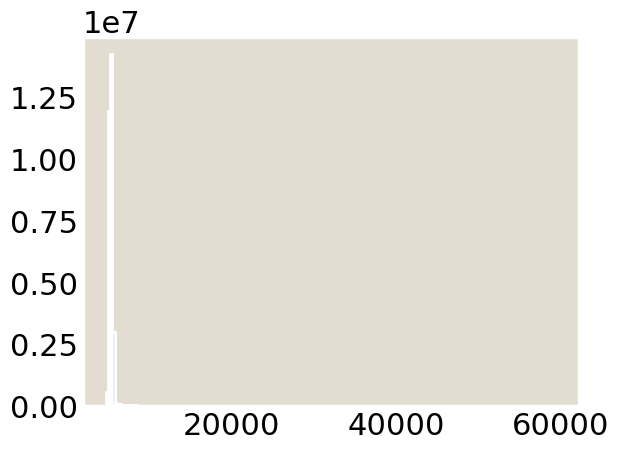

In [156]:
plt.hist(motStacknov7.flatten(),bins=200)


In [102]:
np.median(motStacknov7.flatten())

np.float64(5296.0)

In [157]:
np.std(motStacknov7.flatten())

np.float64(4338.272718868694)

# Raw from ome.tiff

Visualize them in each dimension

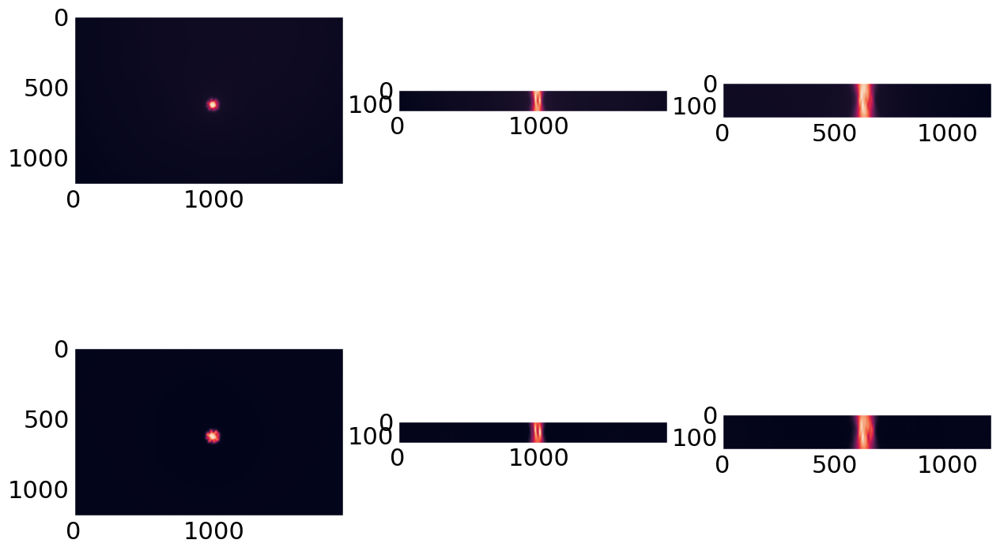

In [7]:
fig, ax=plt.subplots(2, 3, figsize=(15,10))
ax[0,0].imshow(rawIms_mot[rawIms_mot.shape[0]//2])
ax[0,1].imshow(rawIms_mot[:, rawIms_mot.shape[1]//2, :])
ax[0,2].imshow(rawIms_mot[:, :, rawIms_mot.shape[2]//2])

ax[1,0].imshow(rawIms_mt[rawIms_mt.shape[0]//2])
ax[1,1].imshow(rawIms_mt[:, rawIms_mt.shape[1]//2, :])
ax[1,2].imshow(rawIms_mt[:, :, rawIms_mt.shape[2]//2])

Use the correct scalling

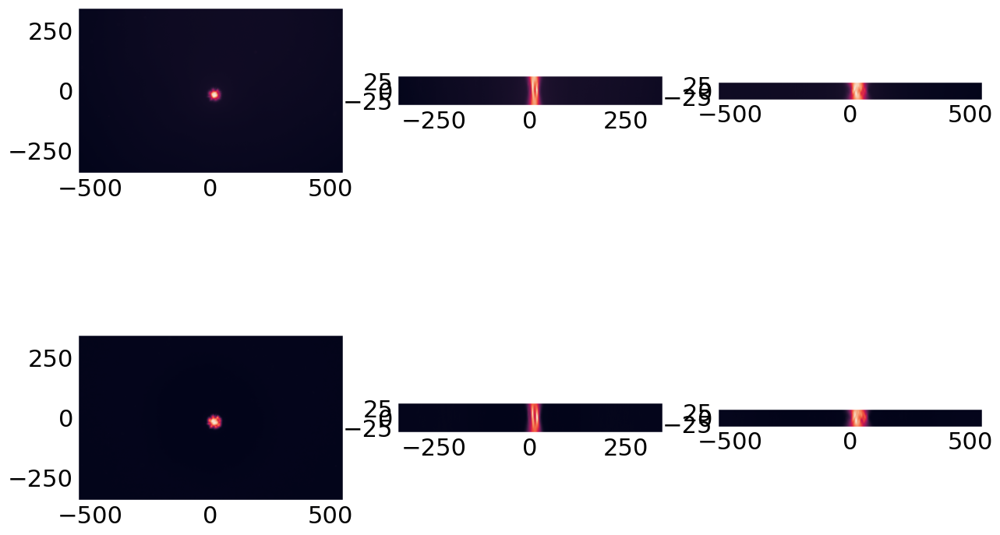

In [8]:
#image dimentions listed in voxel size in "show info" part of fiji
umperpxXY = 296.14/512
umperpxZ = 60/120
xyextraw = (-rawIms_mot.shape[2]//2*umperpxXY, rawIms_mot.shape[2]//2*umperpxXY, -rawIms_mot.shape[1]//2*umperpxXY, rawIms_mot.shape[1]//2*umperpxXY)
yzextraw = (-rawIms_mot.shape[1]//2*umperpxXY, rawIms_mot.shape[1]//2*umperpxXY, -rawIms_mot.shape[0]//2*umperpxZ, rawIms_mot.shape[0]//2*umperpxZ)
xzextraw = (-rawIms_mot.shape[2]//2*umperpxXY, rawIms_mot.shape[2]//2*umperpxXY, -rawIms_mot.shape[0]//2*umperpxZ, rawIms_mot.shape[0]//2*umperpxZ)


fig, ax=plt.subplots(2, 3, figsize=(15,10))
ax[0,0].imshow(rawIms_mot[rawIms_mot.shape[0]//2], extent = xyextraw)
ax[0,1].imshow(rawIms_mot[:, rawIms_mot.shape[1]//2, :], extent=yzextraw)
ax[0,2].imshow(rawIms_mot[:, :, rawIms_mot.shape[2]//2], extent=xzextraw)

ax[1,0].imshow(rawIms_mt[rawIms_mt.shape[0]//2], extent = xyextraw)
ax[1,1].imshow(rawIms_mt[:, rawIms_mt.shape[1]//2, :], extent=yzextraw)
ax[1,2].imshow(rawIms_mt[:, :, rawIms_mt.shape[2]//2], extent=xzextraw)

Crop and also show the MT channel

Text(0, 0.5, 'MT')

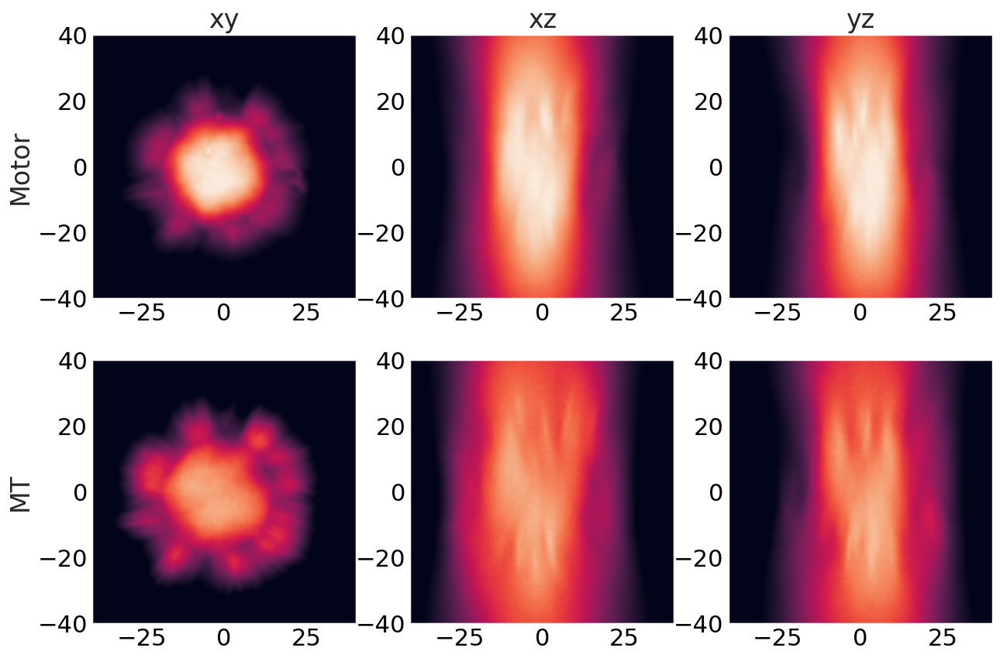

In [9]:
###### image dimentions listed in voxel size in "show info" part of fiji
umperpxXY = 296.14/512
umperpxZ = 60/120

xcent = 993
ycent = 630
zcent = int(161//2)

numum = 161*umperpxZ
zl = int(zcent - numum/(2*umperpxZ))
zh = int(zcent + numum/(2*umperpxZ))
xl = int(xcent - numum/(2*umperpxXY))
xh = int(xcent + numum/(2*umperpxXY))
yl = int(ycent - numum/(2*umperpxXY))
yh = int(ycent + numum/(2*umperpxXY))

extent=(-numum/2, numum/2, -numum/2, numum/2)
        
fig, ax=plt.subplots(2, 3, figsize=(15,10))
ax[0,0].imshow(rawIms_mot[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=50000)
ax[0,1].imshow(rawIms_mot[zl:zh, ycent, xl:xh], extent=extent, vmin=10000,  vmax=50000)
ax[0,2].imshow(rawIms_mot[zl:zh, yl:yh, xcent], extent=extent, vmin=10000,  vmax=50000)

ax[1,0].imshow(rawIms_mt[zcent, yl:yh, xl:xh], extent = extent, vmin=5000,  vmax=25000)
ax[1,1].imshow(rawIms_mt[zl:zh, ycent, xl:xh], extent=extent, vmin=5000,  vmax=25000)
ax[1,2].imshow(rawIms_mt[zl:zh, yl:yh, xcent], extent=extent, vmin=5000,  vmax=25000)

ax[0,0].set_title('xy')
ax[0,1].set_title('xz')
ax[0,2].set_title('yz')

ax[0,0].set_ylabel('Motor')
ax[1,0].set_ylabel('MT')

# Nov 7 aster
Deconvolution process through fiji and deconvolution lab2 performed by HJ

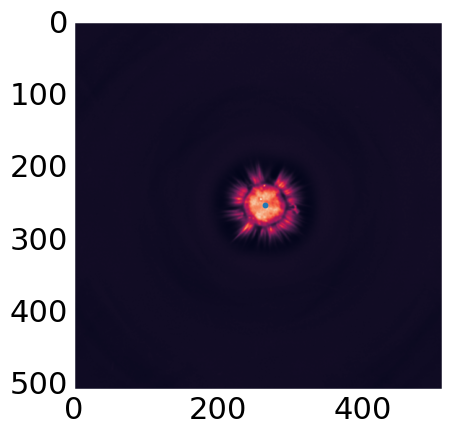

In [10]:
plt.imshow(deconvImsnov7[60])
plt.scatter(265, 255, s=5)

Text(0, 0.5, 'Motor')

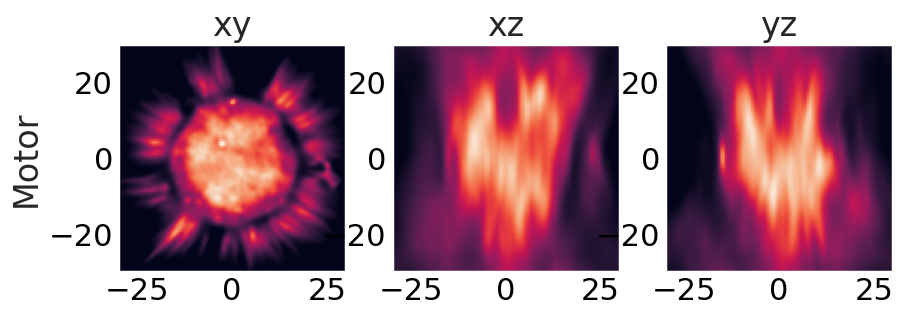

In [83]:
###### image dimentions listed in voxel size in "show info" part of fiji
umperpxXY = 296.14/512
umperpxZ = 60/120

xcent = 265
ycent = 255
zcent = int(len(deconvImsnov7)//2)

numum = len(deconvImsnov7)*umperpxZ
zl = int(zcent - numum/(2*umperpxZ))
zh = int(zcent + numum/(2*umperpxZ))
xl = int(xcent - numum/(2*umperpxXY))
xh = int(xcent + numum/(2*umperpxXY))
yl = int(ycent - numum/(2*umperpxXY))
yh = int(ycent + numum/(2*umperpxXY))

extent=(-numum/2, numum/2, -numum/2, numum/2)
        
fig, ax=plt.subplots(1, 3, figsize=(10,5))
ax[0].imshow(deconvImsnov7[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=100000)
ax[1].imshow(deconvImsnov7[zl:zh, ycent, xl:xh], extent=extent, vmin=10000,  vmax=100000)
ax[2].imshow(deconvImsnov7[zl:zh, yl:yh, xcent], extent=extent, vmin=10000,  vmax=100000)

ax[0].set_title('xy')
ax[1].set_title('xz')
ax[2].set_title('yz')

ax[0].set_ylabel('Motor')

Text(0, 0.5, 'deconvolved image')

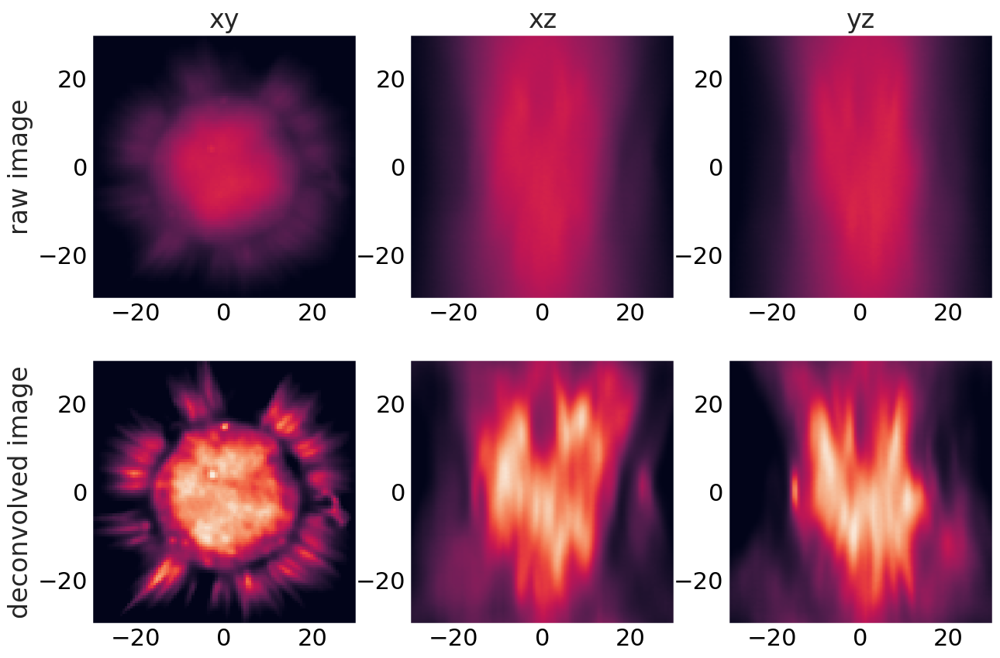

In [84]:
###### image dimentions listed in voxel size in "show info" part of fiji
fig, ax=plt.subplots(2, 3, figsize=(15,10))
ax[0,0].imshow(motStacknov7[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=100000)
ax[0,1].imshow(motStacknov7[zl:zh, ycent, xl:xh], extent=extent, vmin=10000,  vmax=100000)
ax[0,2].imshow(motStacknov7[zl:zh, yl:yh, xcent], extent=extent, vmin=10000,  vmax=100000)

ax[1,0].imshow(deconvImsnov7[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=100000)
ax[1,1].imshow(deconvImsnov7[zl:zh, ycent, xl:xh], extent=extent, vmin=10000,  vmax=100000)
ax[1,2].imshow(deconvImsnov7[zl:zh, yl:yh, xcent], extent=extent, vmin=10000,  vmax=100000)


ax[0,0].set_title('xy')
ax[0,1].set_title('xz')
ax[0,2].set_title('yz')

ax[0,0].set_ylabel('raw image')
ax[1,0].set_ylabel('deconvolved image')

#plt.savefig('../../analyzed_data/aster/zstacks/20250721_nov7RLDeconvIms.pdf', bbox_inches='tight')

In [ ]:
###### image dimentions listed in voxel size in "show info" part of fiji
fig, ax=plt.subplots(2, 3, figsize=(15,10))
ax[0,0].imshow(motStacknov7[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=100000)
ax[0,1].imshow(motStacknov7[zl:zh, ycent, xl:xh], extent=extent, vmin=10000,  vmax=100000)
ax[0,2].imshow(motStacknov7[zl:zh, yl:yh, xcent], extent=extent, vmin=10000,  vmax=100000)

ax[1,0].imshow(deconvImsnov7[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=100000)
ax[1,1].imshow(deconvImsnov7[zl:zh, ycent, xl:xh], extent=extent, vmin=10000,  vmax=100000)
ax[1,2].imshow(deconvImsnov7[zl:zh, yl:yh, xcent], extent=extent, vmin=10000,  vmax=100000)


ax[0,0].set_title('xy')
ax[0,1].set_title('xz')
ax[0,2].set_title('yz')

ax[0,0].set_ylabel('raw image')
ax[1,0].set_ylabel('deconvolved image')

#plt.savefig('../../analyzed_data/aster/zstacks/20250721_nov7RLDeconvIms.pdf', bbox_inches='tight')

In [86]:
np.sum(motStacknov7[zcent, yl:yh, xl:xh]), np.sum(deconvImsnov7[zcent, yl:yh, xl:xh])

(np.uint64(240222496), np.float32(320052350.0))

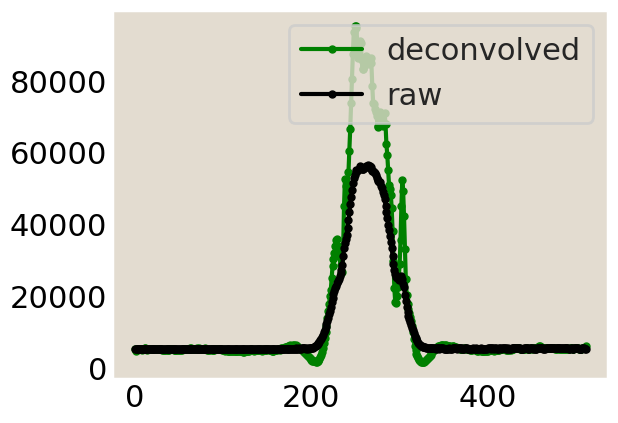

In [13]:
plt.plot(deconvImsnov7[zcent, (yl+yh)//2, :], 'go-', label='deconvolved', ms=5)
plt.plot(motStacknov7[zcent, (yl+yh)//2, :], 'ko-', label='raw', ms=5)
plt.legend()

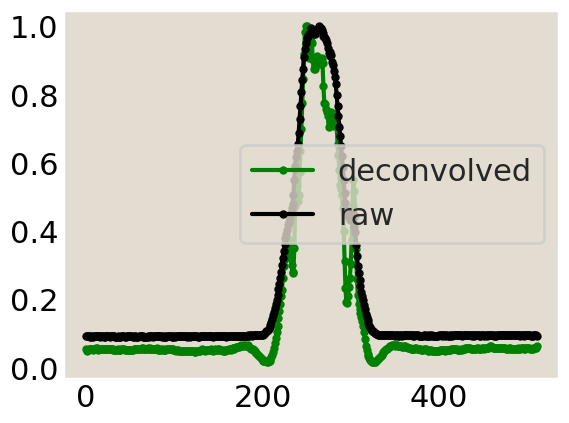

In [14]:
plt.plot(deconvImsnov7[zcent, (yl+yh)//2, :]/max(deconvImsnov7[zcent, (yl+yh)//2, :]), 'go-', label='deconvolved', ms=5)
plt.plot(motStacknov7[zcent, (yl+yh)//2, :]/max(motStacknov7[zcent, (yl+yh)//2, :]), 'ko-', label='raw', ms=5)
plt.legend()

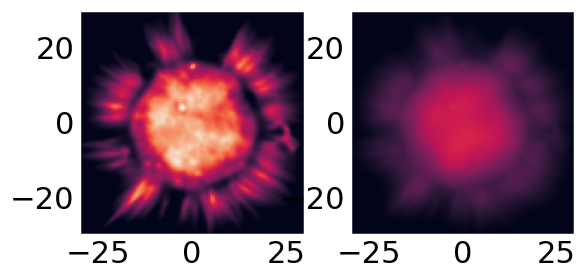

In [15]:
umperpxXY = 296.14/512
umperpxZ = 60/120

xcent = 265
ycent = 255
zcent = int(len(deconvImsnov7)//2)

numum = len(deconvImsnov7)*umperpxZ
zl = int(zcent - numum/(2*umperpxZ))
zh = int(zcent + numum/(2*umperpxZ))
xl = int(xcent - numum/(2*umperpxXY))
xh = int(xcent + numum/(2*umperpxXY))
yl = int(ycent - numum/(2*umperpxXY))
yh = int(ycent + numum/(2*umperpxXY))

extent=(-numum/2, numum/2, -numum/2, numum/2)
        
fig, ax = plt.subplots(1,2)
ax[0].imshow(deconvImsnov7[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=100000)
ax[1].imshow(motStacknov7[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=100000)

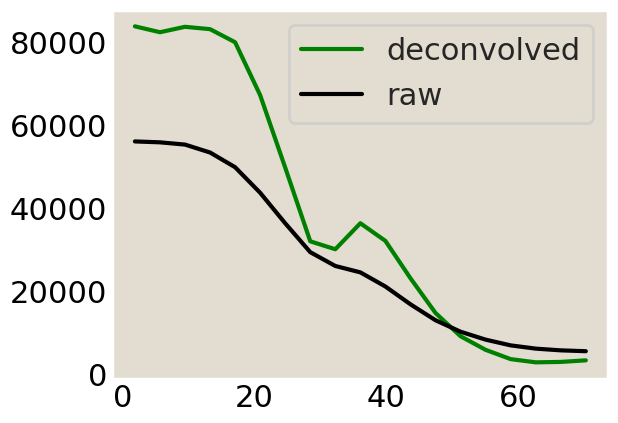

In [16]:
#radially average

plt.plot(*polarAverage(deconvImsnov7[zcent, yl:yh, xl:xh]), color='green', label='deconvolved')
plt.plot(*polarAverage(motStacknov7[zcent, yl:yh, xl:xh]), color='k', label='raw')
plt.legend()

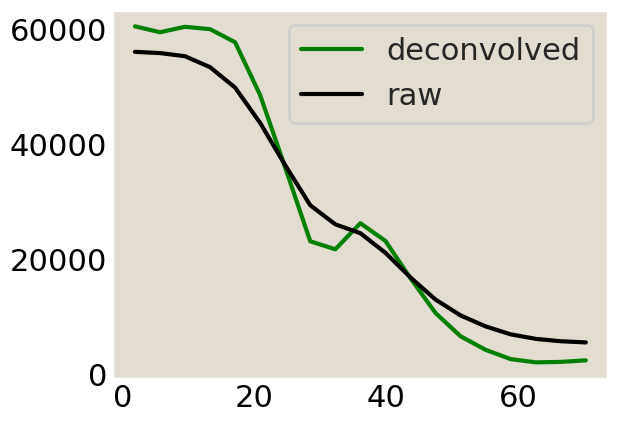

In [88]:
#radially average
scalefacnov7 = np.sum(polarAverage(motStacknov7[zcent, yl:yh, xl:xh])[1])/np.sum(polarAverage(deconvImsnov7[zcent, yl:yh, xl:xh])[1])
rDecnov7, rAvgDecsnov7=polarAverage(deconvImsnov7[zcent, yl:yh, xl:xh])
plt.plot(rDecnov7, rAvgDecsnov7*scalefacnov7, color='green', label='deconvolved')
plt.plot(*polarAverage(motStacknov7[zcent, yl:yh, xl:xh]), color='k', label='raw')
plt.legend()

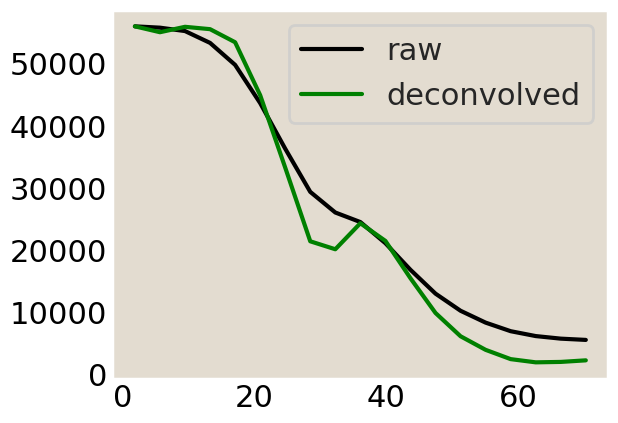

In [89]:
#radially average
rRawnov7, rAvgRawsnov7=polarAverage(motStacknov7[zcent, yl:yh, xl:xh])
plt.plot(rRawnov7, rAvgRawsnov7, color='k', label='raw')

rDecnov7, rAvgDecsnov7=polarAverage(deconvImsnov7[zcent, yl:yh, xl:xh])
plt.plot(rDecnov7, rAvgDecsnov7/rAvgDecsnov7.max()*rAvgRawsnov7.max(), color='green', label='deconvolved')
plt.legend()

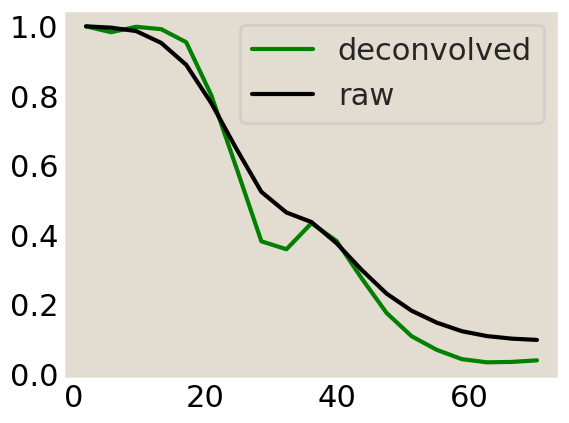

In [17]:
#radially average
rDecnov7, rAvgDecsnov7=polarAverage(deconvImsnov7[zcent, yl:yh, xl:xh])
plt.plot(rDecnov7, rAvgDecsnov7/rAvgDecsnov7.max(), color='green', label='deconvolved')
rRawnov7, rAvgRawsnov7=polarAverage(motStacknov7[zcent, yl:yh, xl:xh])
plt.plot(rRawnov7, rAvgRawsnov7/rAvgRawsnov7.max(), color='k', label='raw')
plt.legend()

Text(0, 0.5, 'deconvolved image')

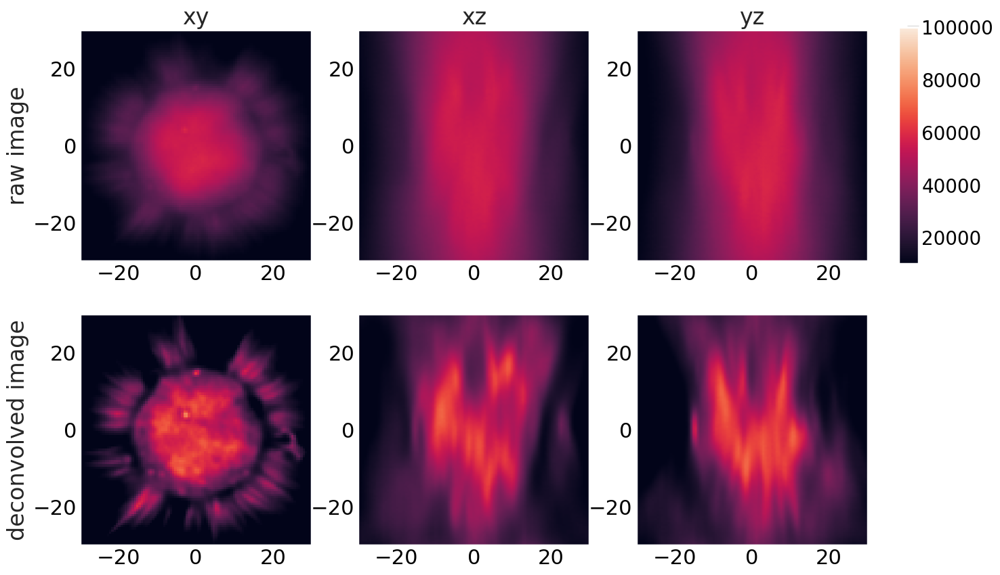

In [96]:
###### image dimentions listed in voxel size in "show info" part of fiji
fig, ax=plt.subplots(2, 3, figsize=(15,10))
ax[0,0].imshow(motStacknov7[zcent, yl:yh, xl:xh], extent = extent, vmin=10000,  vmax=100000)
ax[0,1].imshow(motStacknov7[zl:zh, ycent, xl:xh], extent=extent, vmin=10000,  vmax=100000)
ax[0,2].imshow(motStacknov7[zl:zh, yl:yh, xcent], extent=extent, vmin=10000,  vmax=100000)

ax[1,0].imshow(deconvImsnov7[zcent, yl:yh, xl:xh]*scalefacnov7, extent = extent, vmin=10000,  vmax=100000)
ax[1,1].imshow(deconvImsnov7[zl:zh, ycent, xl:xh]*scalefacnov7, extent=extent, vmin=10000,  vmax=100000)
ax[1,2].imshow(deconvImsnov7[zl:zh, yl:yh, xcent]*scalefacnov7, extent=extent, vmin=10000,  vmax=100000)

#### Top Colorbar ####
caxtop = fig.add_axes([0.93, 0.53, 0.02, 0.35])  # horizontal [left, bottom, width, height]
cbartop = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=10000,  vmax=100000)),
                    cax=caxtop, 
                    orientation='vertical')
cbartop.ax.tick_params(labelsize=20)


ax[0,0].set_title('xy')
ax[0,1].set_title('xz')
ax[0,2].set_title('yz')

ax[0,0].set_ylabel('raw image')
ax[1,0].set_ylabel('deconvolved image')

#plt.savefig('../../analyzed_data/aster/zstacks/20250721_nov7RLDeconvIms.pdf', bbox_inches='tight')

# Nov 7 2D plane
Explore a 2D convolution only looking at one plane

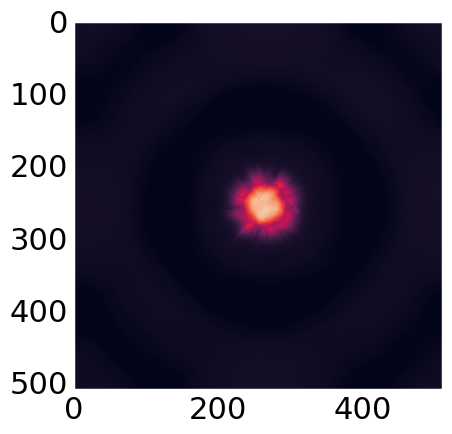

In [18]:
plt.imshow(twoDRL)

In [19]:
zcent, len(deconvImsnov7)//2

(60, 60)

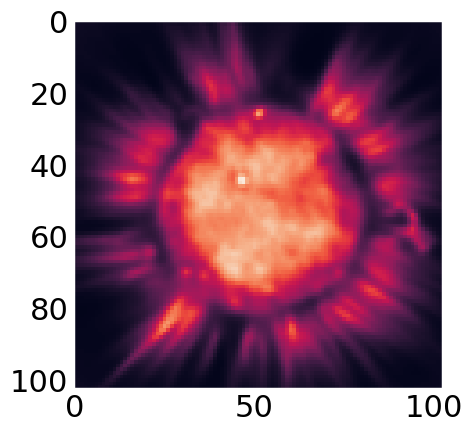

In [20]:
plt.imshow(deconvImsnov7[zcent, yl:yh, xl:xh])

In [21]:
deconvImsnov7.shape

(120, 512, 512)

Text(0, 0.5, 'intensity (a.u.)')

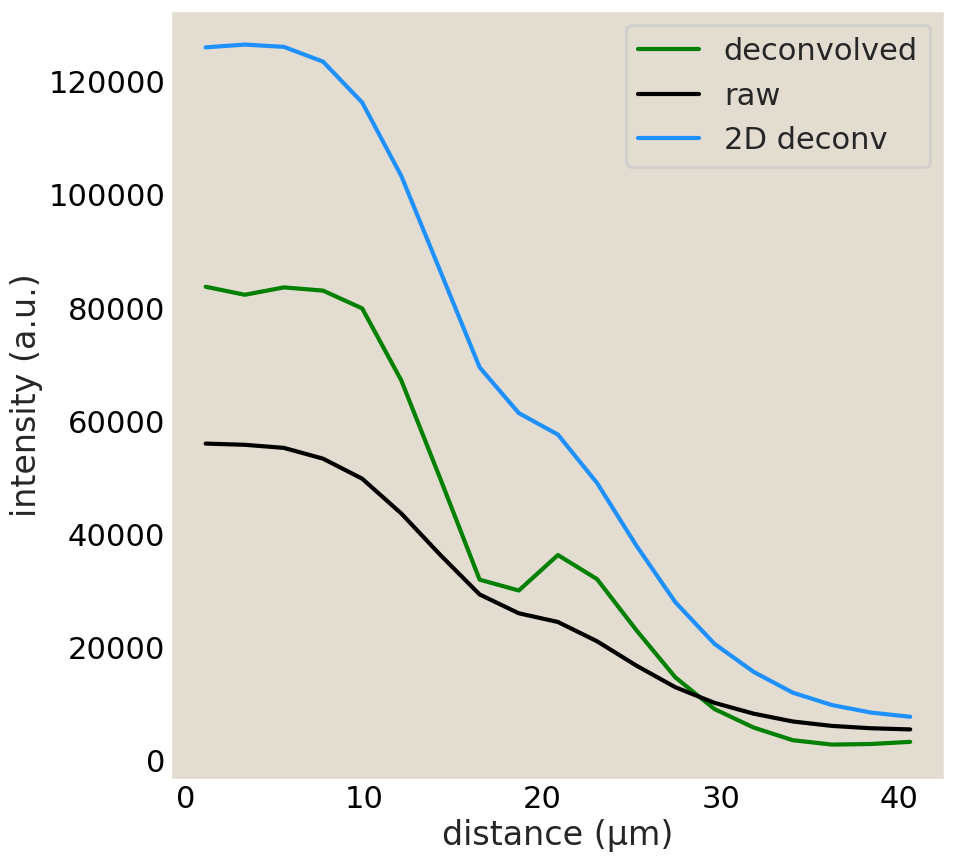

In [22]:
### what happens when we deconvolve just in the transverse plane?



fig, ax = plt.subplots(figsize=(10,10))
#radially average
#rDecnov7, rAvgDecsnov7=polarAverage(deconvImsnov7[len(deconvImsnov7)//2, yl:yh, xl:xh])
plt.plot(rDecnov7*umperpxXY, rAvgDecsnov7, color='green', label='deconvolved')
#plt.plot(rDec, rAvgDecs/rAvgDecs.max(), color='green', label='3d-deconvolved')
#rRawnov7, rAvgRawsnov7=polarAverage(motStacknov7[len(deconvImsnov7)//2, yl:yh, xl:xh])
plt.plot(rRawnov7*umperpxXY, rAvgRawsnov7, color='k', label='raw')
#plt.plot(rRaw, rAvgRaws/rAvgRaws.max(), color='k', label='raw')

rDec2D, rAvgDecs2D=polarAverage(twoDRL[yl:yh, xl:xh])
plt.plot(rDec2D*umperpxXY, rAvgDecs2D, color='dodgerblue', label='2D deconv')
#plt.plot(rDec2D, rAvgDecs2D/rAvgDecs2D.max(), color='dodgerblue', label='2d-deconvolved')
plt.legend()

plt.xlabel('distance (µm)')
plt.ylabel('intensity (a.u.)')

# plt.savefig('../../analyzed_data/aster/zstacks/20250721_deconvRadialTraceUnnormalized.pdf', 
#            bbox_inches='tight')

Text(0, 0.5, 'normalized intensity (a.u.)')

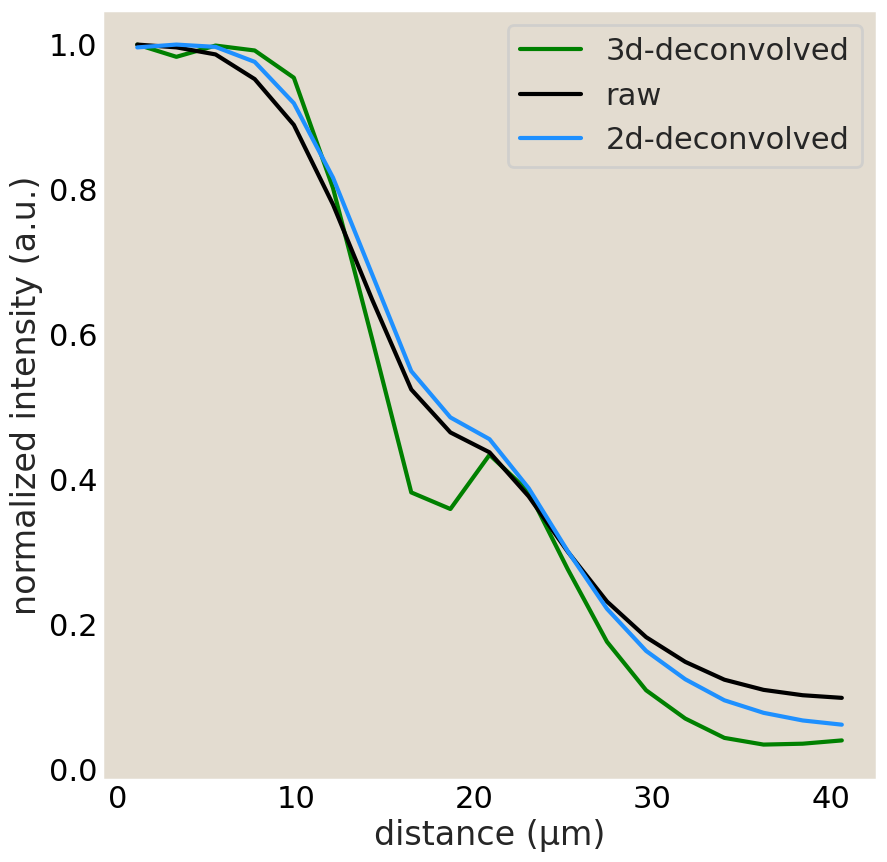

In [23]:
### what happens when we deconvolve just in the transverse plane?



fig, ax = plt.subplots(figsize=(10,10))
#radially average
#rDec, rAvgDecs=polarAverage(deconvIms[60, yl:yh, xl:xh])
#plt.plot(rDec, rAvgDecs, color='green')
plt.plot(rDecnov7*umperpxXY, rAvgDecsnov7/rAvgDecsnov7.max(), color='green', label='3d-deconvolved')
#rRaw, rAvgRaws=polarAverage(motStack[60, yl:yh, xl:xh])
#plt.plot(rRaw, rAvgRaws, color='k')
plt.plot(rRawnov7*umperpxXY, rAvgRawsnov7/rAvgRawsnov7.max(), color='k', label='raw')

#rDec2D, rAvgDecs2D=polarAverage(twoDRL[yl:yh, xl:xh])
#plt.plot(rDec2D, rAvgDecs2D, color='dodgerblue')
plt.plot(rDec2D*umperpxXY, rAvgDecs2D/rAvgDecs2D.max(), color='dodgerblue', label='2d-deconvolved')
plt.legend()

plt.xlabel('distance (µm)')
plt.ylabel('normalized intensity (a.u.)')

# plt.savefig('../../analyzed_data/aster/zstacks/20250721_deconvRadialTrace.pdf', 
#            bbox_inches='tight')

Text(0, 0.5, 'intensity derivative w.r.t radius (µm$^{-1}$)')

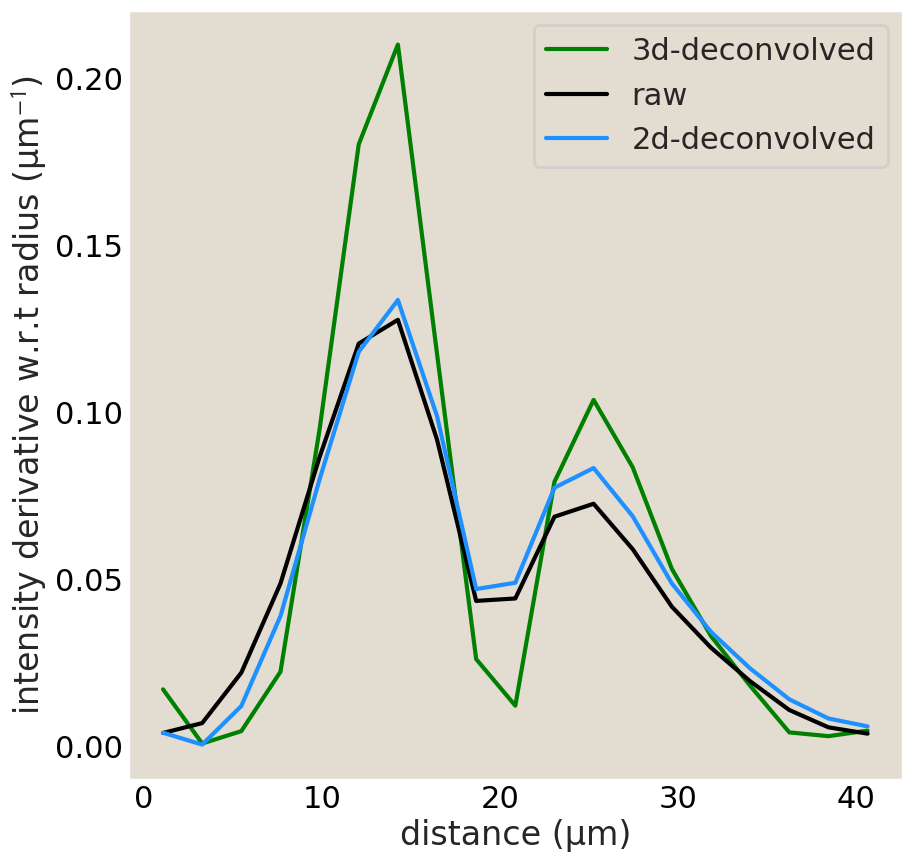

In [24]:
### NORMALIZED plot the local spatial derivatives [what happens when we deconvolve just in the transverse plane?]



fig, ax = plt.subplots(figsize=(10,10))
#radially average
#rDec, rAvgDecs=polarAverage(deconvIms[60, yl:yh, xl:xh])
#plt.plot(rDec, rAvgDecs, color='green')
plt.plot(rDecnov7*umperpxXY, np.abs(np.gradient(rAvgDecsnov7/rAvgDecsnov7.max())), color='green', label='3d-deconvolved')
#rRaw, rAvgRaws=polarAverage(motStack[60, yl:yh, xl:xh])
#plt.plot(rRaw, rAvgRaws, color='k')
plt.plot(rRawnov7*umperpxXY, np.abs(np.gradient(rAvgRawsnov7/rAvgRawsnov7.max())), color='k', label='raw')

#rDec2D, rAvgDecs2D=polarAverage(twoDRL[yl:yh, xl:xh])
#plt.plot(rDec2D, rAvgDecs2D, color='dodgerblue')
plt.plot(rDec2D*umperpxXY, np.abs(np.gradient(rAvgDecs2D/rAvgDecs2D.max())), color='dodgerblue', label='2d-deconvolved')
plt.legend()
plt.xlabel('distance (µm)')
plt.ylabel(r'intensity derivative w.r.t radius (µm$^{-1}$)')

# plt.savefig('../../analyzed_data/aster/zstacks/20250721_nov7RLfirstDerivrho.pdf', 
#            bbox_inches='tight')

Text(0, 0.5, 'intensity derivative w.r.t radius (µm$^{-1}$)')

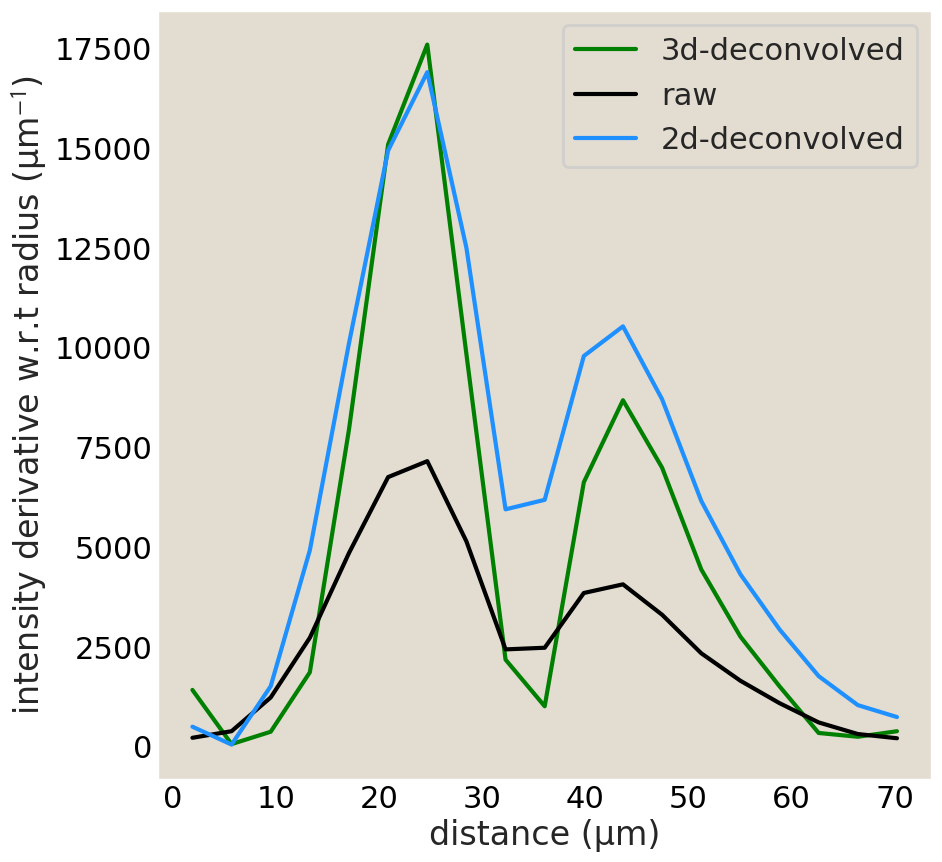

In [25]:
### plot the local spatial derivatives with the absolute value [what happens when we deconvolve just in transverse plane?]

fig, ax = plt.subplots(figsize=(10,10))
#radially average
#rDec, rAvgDecs=polarAverage(deconvIms[60, yl:yh, xl:xh])
#plt.plot(rDec, rAvgDecs, color='green')
plt.plot(rDecnov7, np.abs(np.gradient(rAvgDecsnov7)), color='green', label='3d-deconvolved')
#rRaw, rAvgRaws=polarAverage(motStack[60, yl:yh, xl:xh])
#plt.plot(rRaw, rAvgRaws, color='k')
plt.plot(rRawnov7, np.abs(np.gradient(rAvgRawsnov7)), color='k', label='raw')

#rDec2D, rAvgDecs2D=polarAverage(twoDRL[yl:yh, xl:xh])
#plt.plot(rDec2D, rAvgDecs2D, color='dodgerblue')
plt.plot(rDec2D, np.abs(np.gradient(rAvgDecs2D)), color='dodgerblue', label='2d-deconvolved')
plt.legend()

plt.xlabel('distance (µm)')
plt.ylabel(r'intensity derivative w.r.t radius (µm$^{-1}$)')

# plt.savefig('../../analyzed_data/aster/zstacks/20250721_nov7RLfirstDerivrhoUnnormalized.pdf', 
#            bbox_inches='tight')

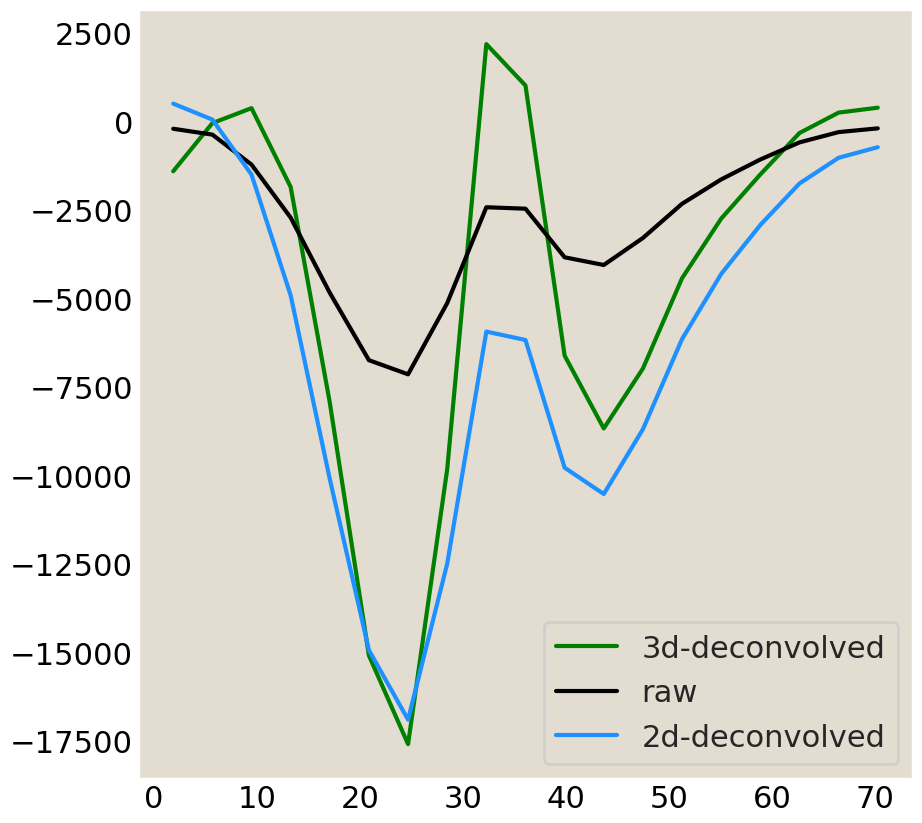

In [26]:
### NO abs
### plot the local spatial derivatives [what happens when we deconvolve just in lateral direction?]

fig, ax = plt.subplots(figsize=(10,10))
#radially average
plt.plot(rDecnov7, np.gradient(rAvgDecsnov7), color='green', label='3d-deconvolved')
plt.plot(rRawnov7, np.gradient(rAvgRawsnov7), color='k', label='raw')
plt.plot(rDec2D, np.gradient(rAvgDecs2D), color='dodgerblue', label='2d-deconvolved')
plt.legend()

/tmp/ipykernel_66965/586904347.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10,10))


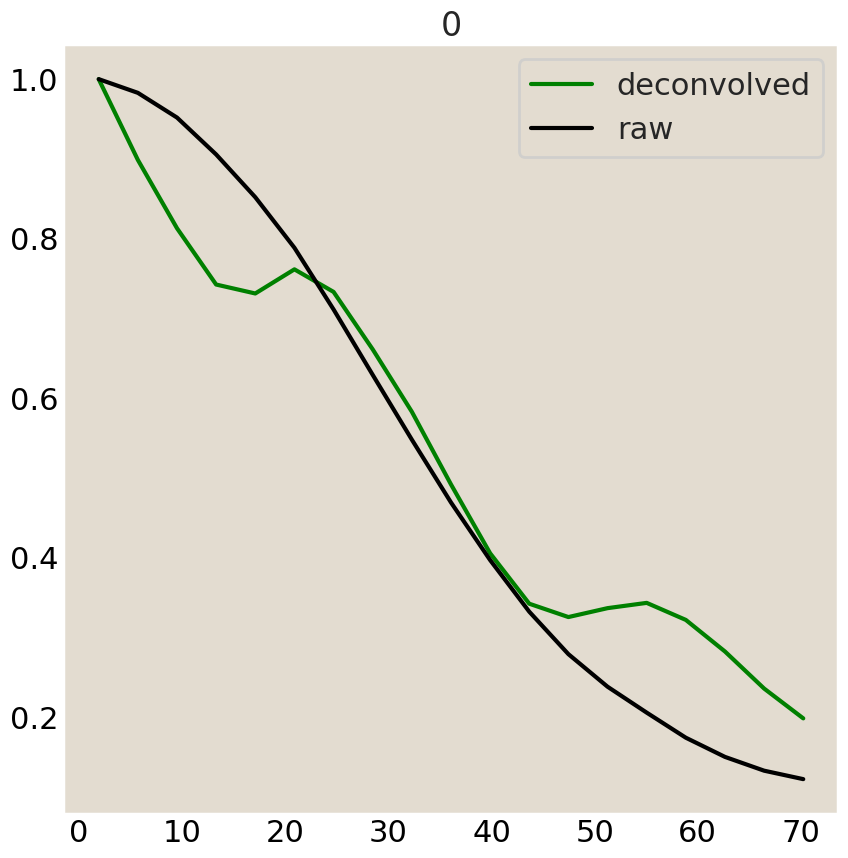

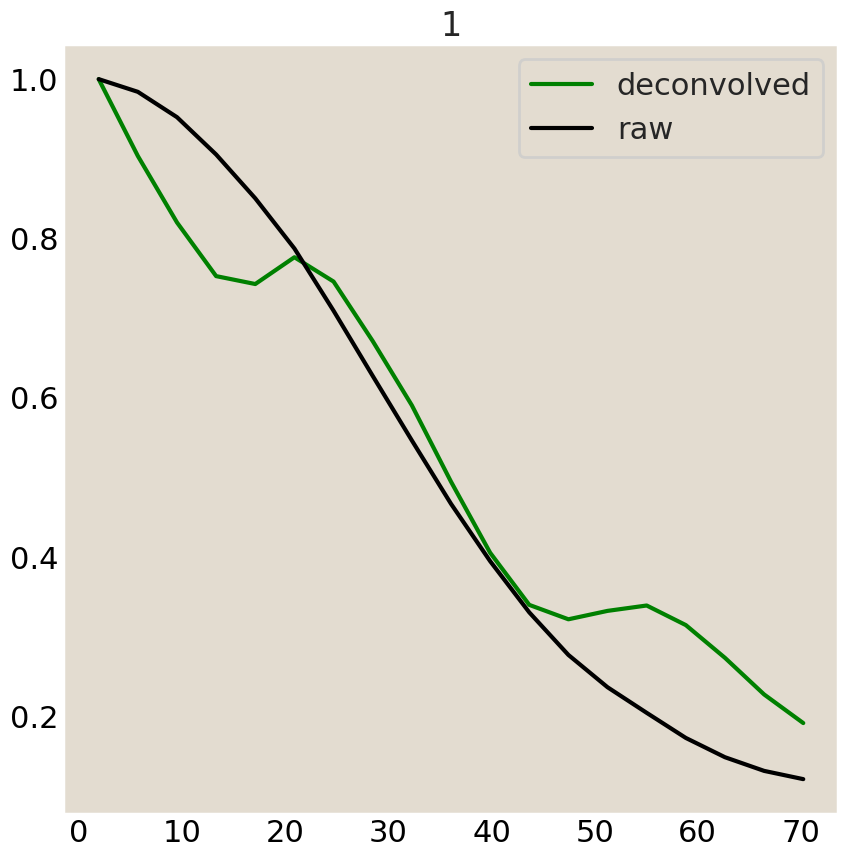

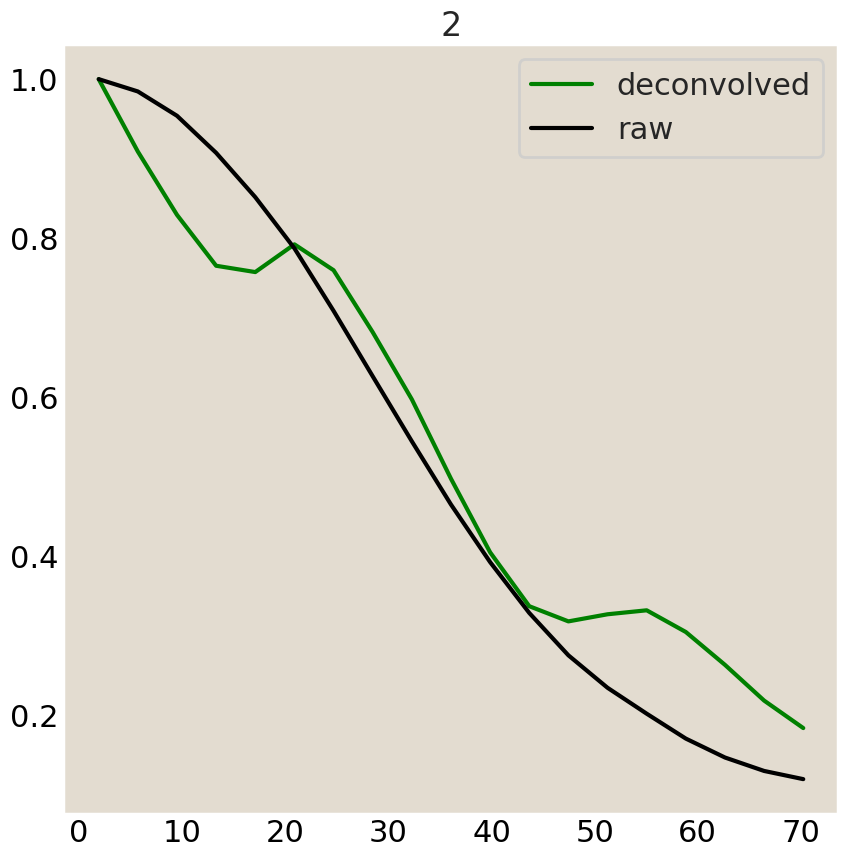

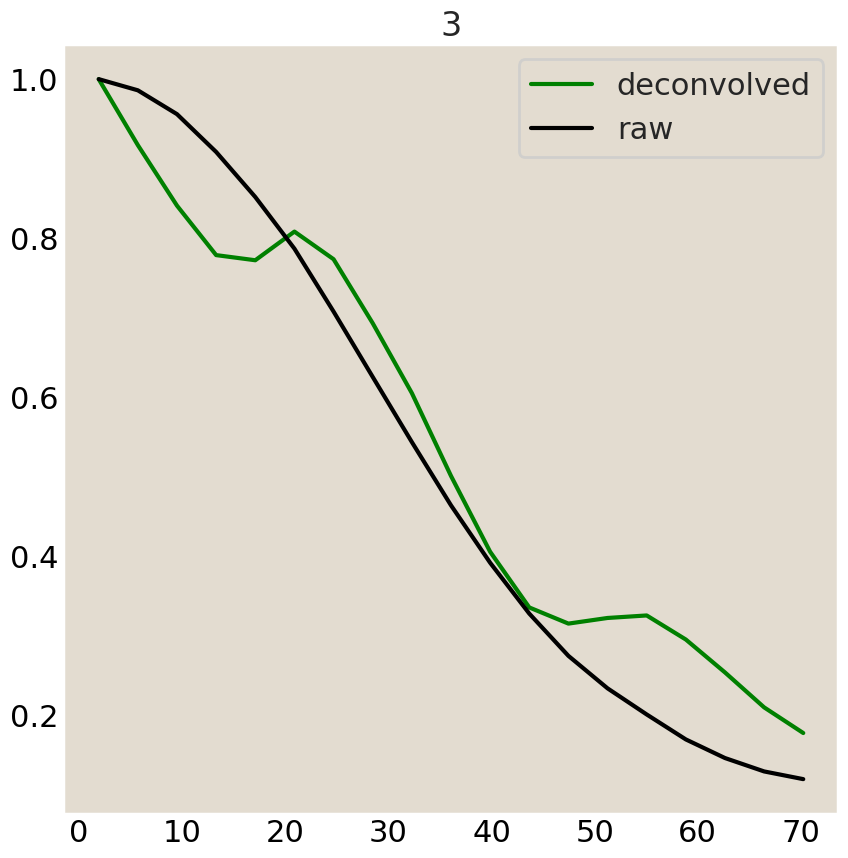

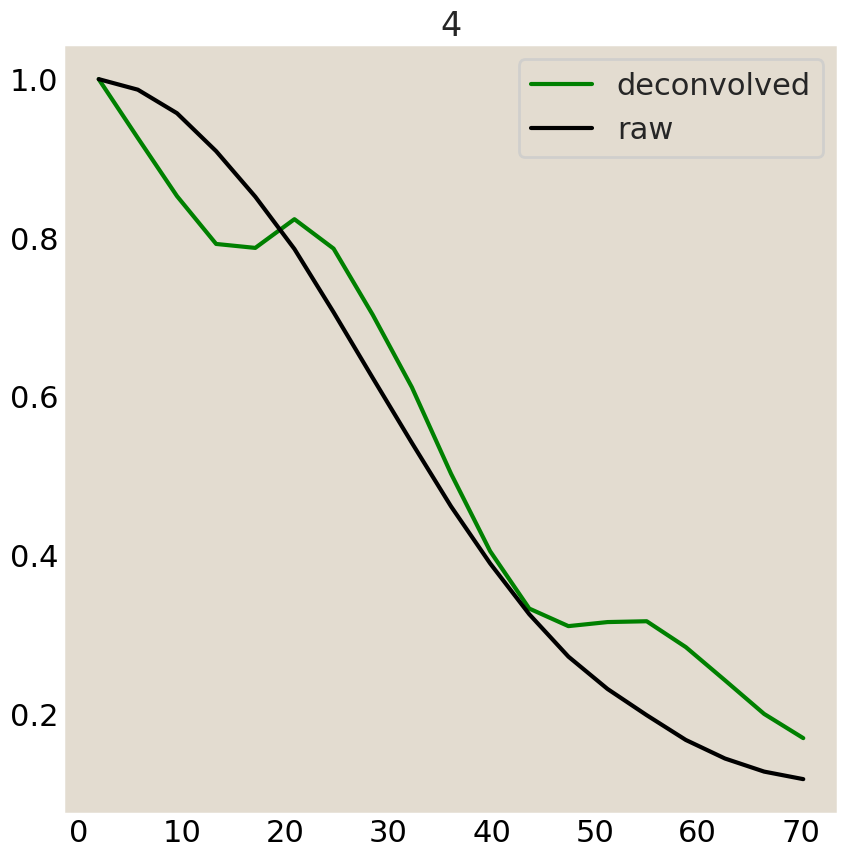

...

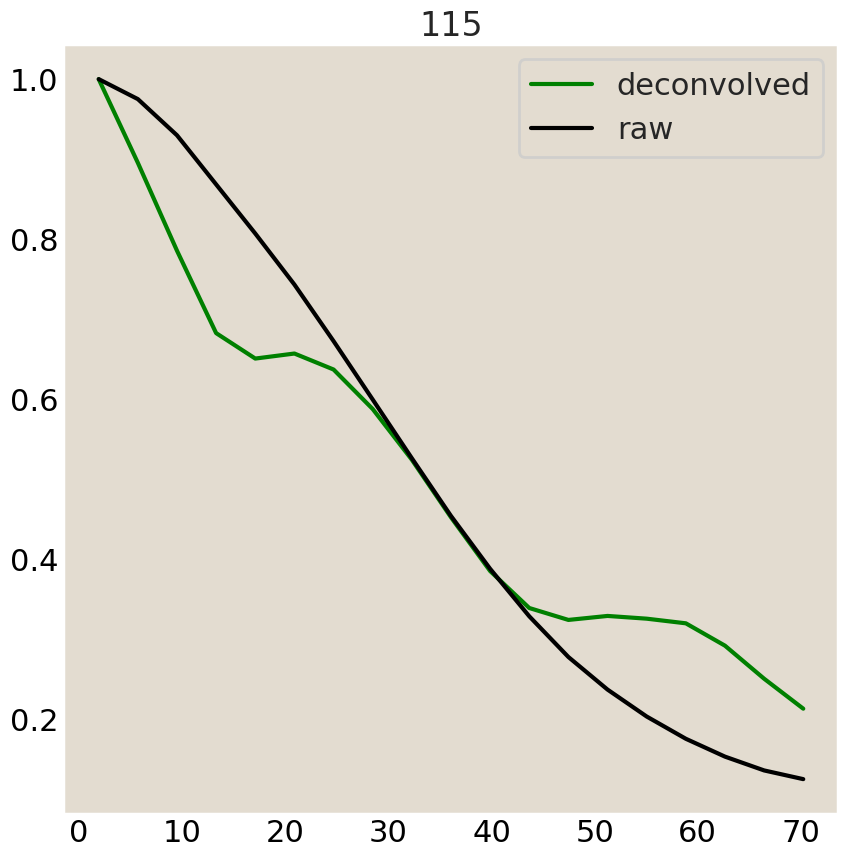

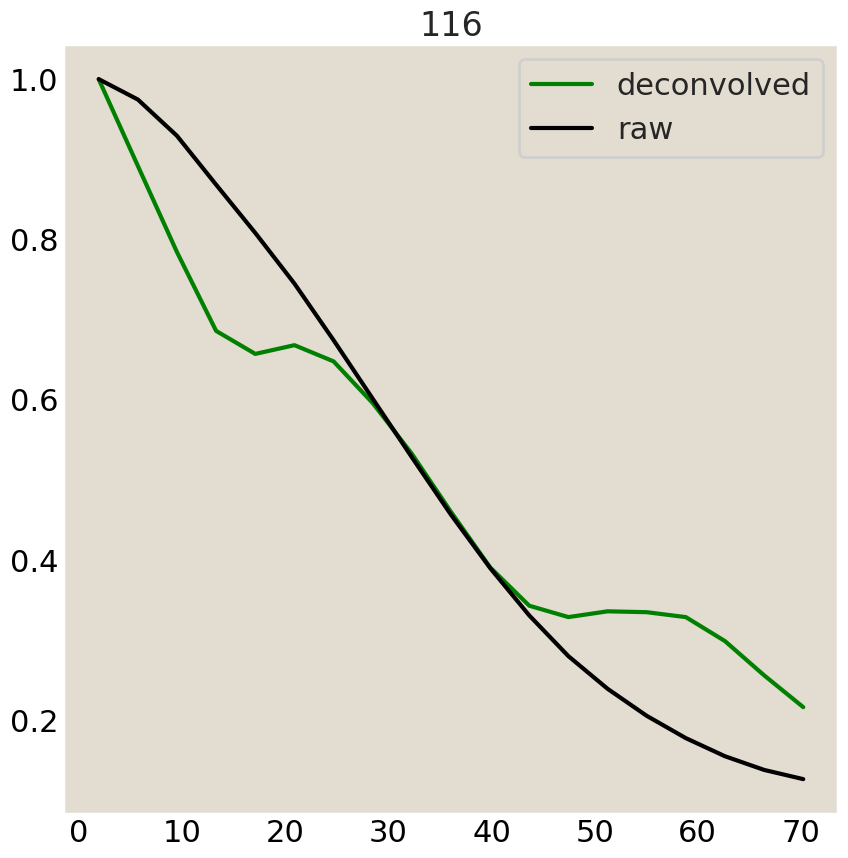

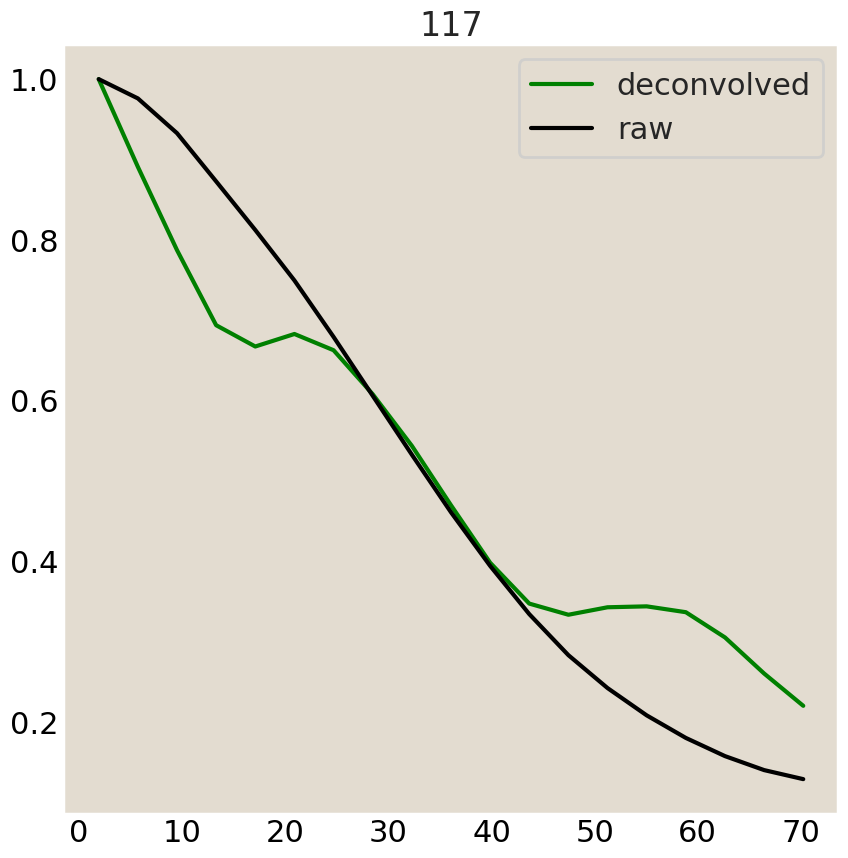

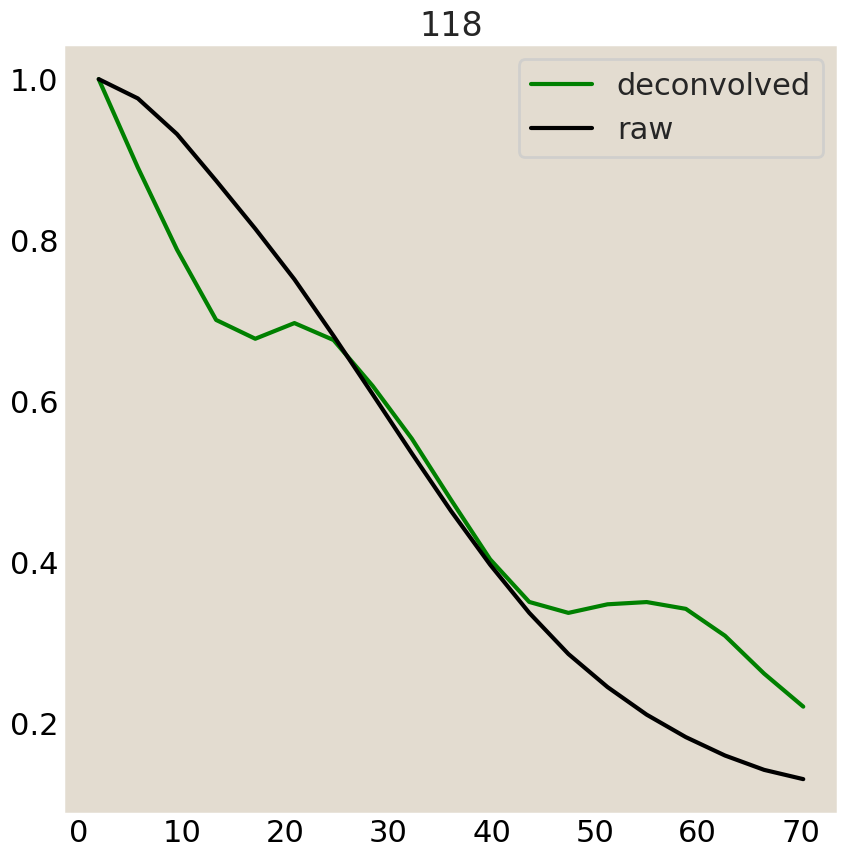

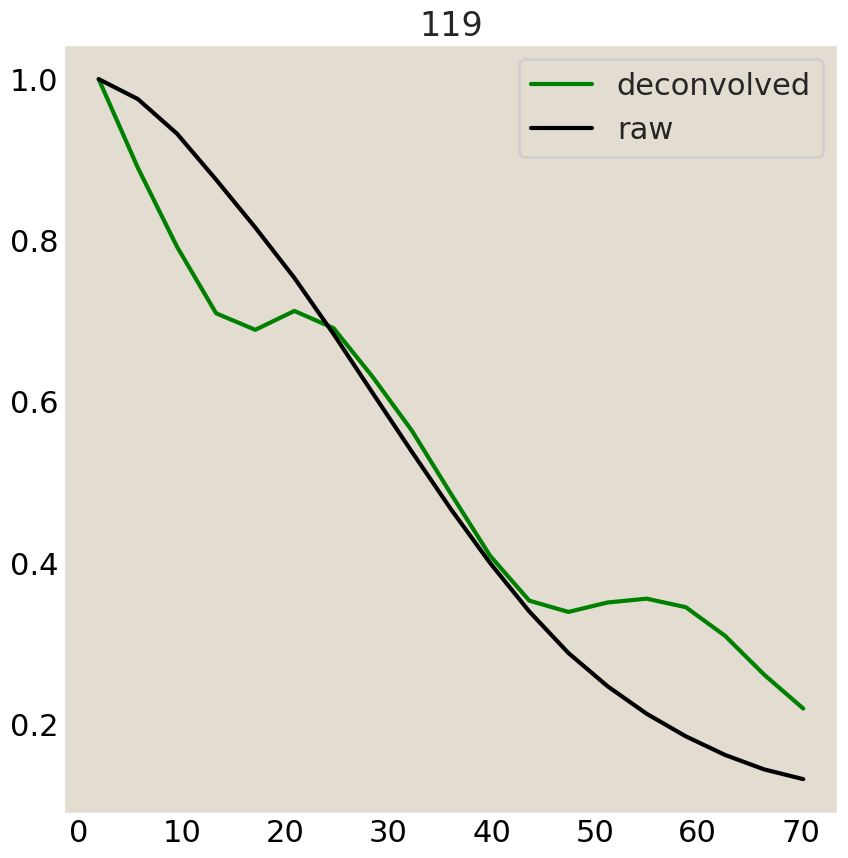

In [27]:
for z in range(120):#[10, 20, 30, 40, 50, 60, 70, 80, 90, 100]:
    fig, ax = plt.subplots(figsize=(10,10))
    #radially average
    rDecTemp, rAvgDecsTemp=polarAverage(deconvImsnov7[z, yl:yh, xl:xh])
    plt.plot(rDecTemp, rAvgDecsTemp/rAvgDecsTemp.max(), color='green', label='deconvolved')
    #plt.plot(rDec, rAvgDecs, color='green')
    rRawTemp, rAvgRawsTemp=polarAverage(motStacknov7[z, yl:yh, xl:xh])
    plt.plot(rRawTemp, rAvgRawsTemp/rAvgRawsTemp.max(), color='k', label='raw')
    plt.legend()
    plt.title(z)
    #plt.plot(rRaw, rAvgRaws, color='k')


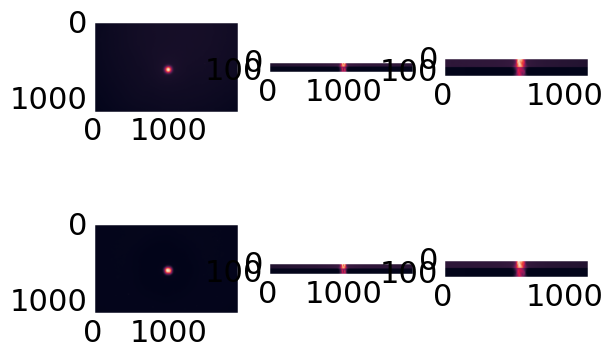

In [28]:
fig, ax=plt.subplots(2, 3)
ax[0,0].imshow(rawIms[0][rawIms[0].shape[0]//2])
ax[0,1].imshow(rawIms[0][:, rawIms[0].shape[1]//2, :])
ax[0,2].imshow(rawIms[0][:, :, rawIms[0].shape[2]//2])

ax[1,0].imshow(rawIms[1][rawIms[0].shape[0]//2])
ax[1,1].imshow(rawIms[1][:, rawIms[0].shape[1]//2, :])
ax[1,2].imshow(rawIms[1][:, :, rawIms[0].shape[2]//2])

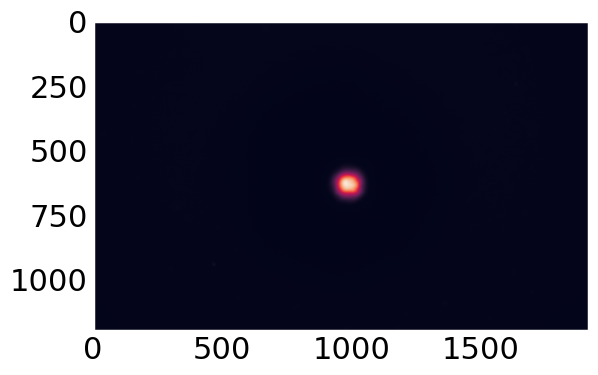

In [29]:
plt.imshow(rawIms[1][80])

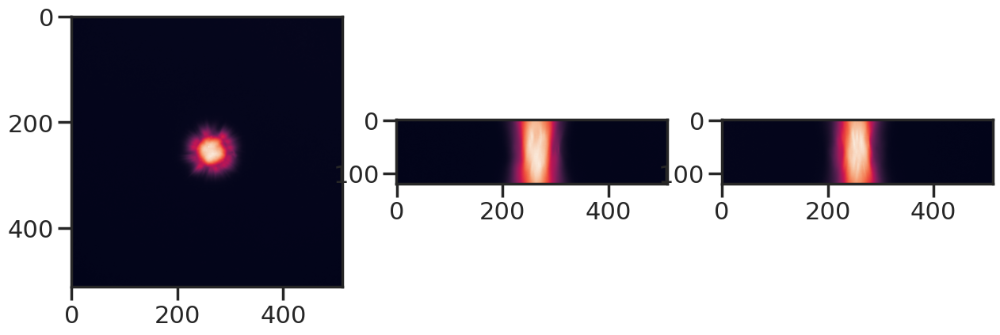

In [79]:
fig, ax = plt.subplots(1,3, figsize=(15, 5))
ax[0].imshow(motStack_bs[len(motStack)//2])
ax[1].imshow(motStack_bs[:, motStack.shape[1]//2,:])
ax[2].imshow(motStack_bs[:,:, motStack.shape[2]//2])


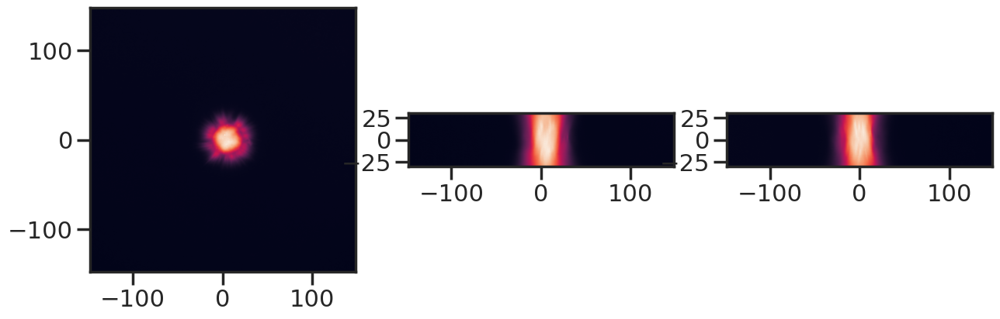

In [61]:
fig, ax = plt.subplots(1,3, figsize=(15, 5))
ax[0].imshow(motStack_bs[len(motStack)//2], extent=xyext)
ax[1].imshow(motStack_bs[:, motStack.shape[1]//2,:], extent=xzext)
ax[2].imshow(motStack_bs[:,:, motStack.shape[2]//2], extent=xzext)


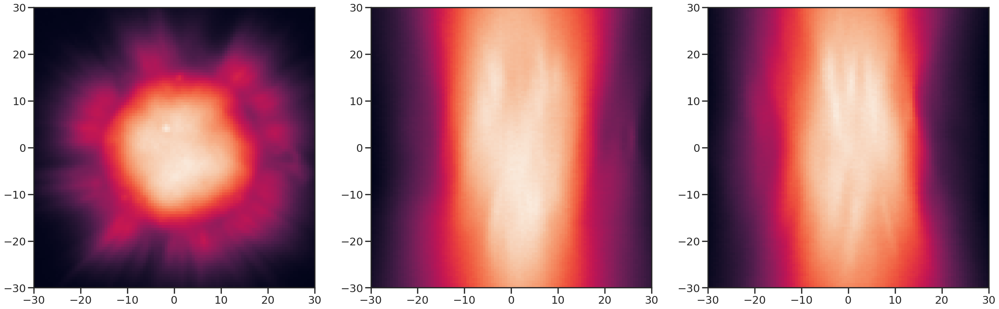

In [299]:
numum = 60
# zl = int(len(motStack)/2 - numum/(2*umperpxZ))
# zh = int(len(motStack)/2 + numum/(2*umperpxZ))
# xl = int(motStack.shape[1]/2 - numum/(2*umperpxXY))
# xh = int(motStack.shape[1]/2 + numum/(2*umperpxXY))
zl = int(len(motStack)/2 - numum/(2*umperpxZ))
zh = int(len(motStack)/2 + numum/(2*umperpxZ))
xl = int(263 - numum/(2*umperpxXY))
xh = int(263 + numum/(2*umperpxXY))
yl = int(255 - numum/(2*umperpxXY))
yh = int(255 + numum/(2*umperpxXY))

fig, ax = plt.subplots(1,3, figsize=(35, 35))
ax[0].imshow(motStack_bs[len(motStack)//2, yl:yh, xl:xh ], extent=(-numum/2, numum/2, -numum/2, numum/2))
ax[1].imshow(motStack_bs[zl:zh, motStack.shape[1]//2,xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2))
ax[2].imshow(motStack_bs[zl:zh,yl:yh, motStack.shape[2]//2], extent=(-numum/2, numum/2, -numum/2, numum/2))


# Gridlines based on minor ticks

plt.savefig('20250708_slice.pdf', bbox_inches='tight', transparent=True)

In [103]:
# fig, ax = plt.subplots(figsize=(10,10))
# ax.set_aspect('equal')
# ax.pcolormesh(motStack_bs[len(motStack)//2, yl:yh, xl:xh ], edgecolors='w', linewidth=0.01)
# ax.invert_yaxis()

In [50]:
(zh-zl)*umperpxZ, (xh-xl)*umperpxXY

(60.0, 59.5750390625)

In [232]:

teeeest = restoration.richardson_lucy(motStacknov7[60], psfStacknov7[60], num_iter=100, clip=False)


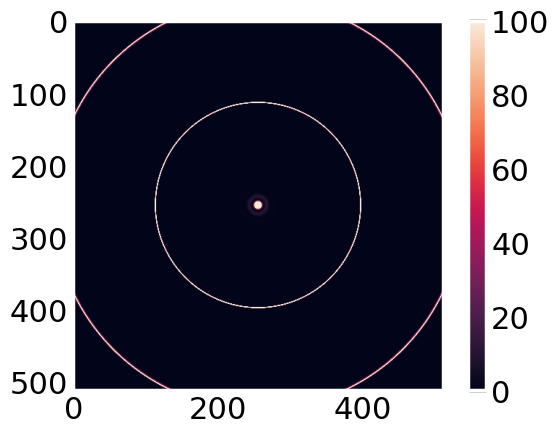

In [227]:
plt.imshow(psfStacknov7[60], vmin=0, vmax=100)
plt.colorbar()

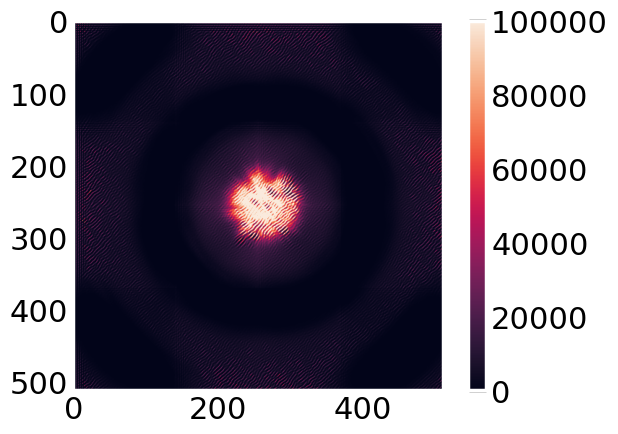

In [237]:
plt.imshow(teeeest, vmin=0, vmax=100000)
plt.colorbar()

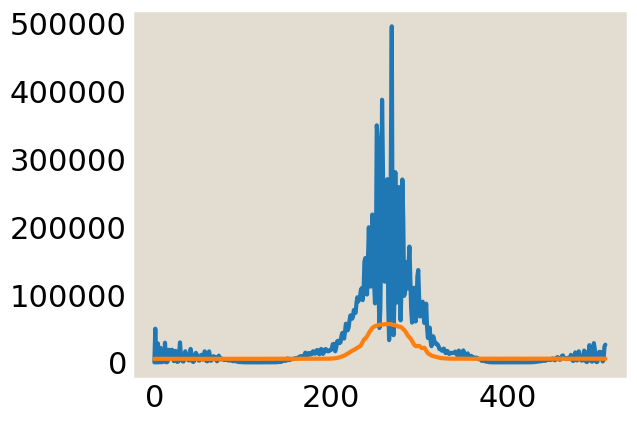

In [238]:
plt.plot(teeeest[len(teeeest)//2])
plt.plot(motStacknov7[60, len(motStacknov7[60])//2])

In [17]:
deconv = restoration.richardson_lucy(motStack_bs, psfStack, num_iter=30)

## Deconvolution in Python comparing PSFs

In [180]:
umperpxXYnov7**2*umperpxZnov7

0.16727237625122068

In [179]:
np.sum(psfStacknov7)

np.uint64(43540552)

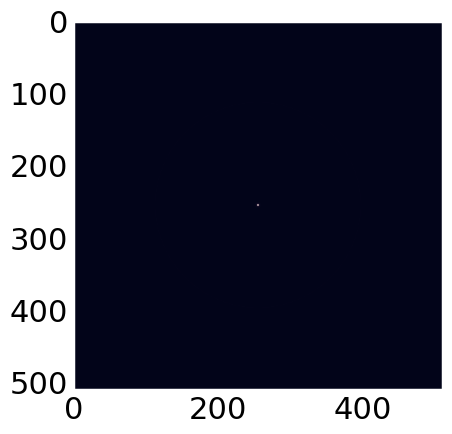

In [178]:
plt.imshow(psfStacknov7[len(psfStacknov7)//2])

In [184]:
def gaussPSF_transverse(dx, dy, sigmaTr):
  return np.exp(-(dx**2+dy**2)/(2*sigmaTr**2)) / (np.sqrt((2*np.pi*sigmaTr**2)**2))

In [250]:
# make the psf in pixel units matching the dimensions of the image (512, 512)

numx=512
numy=512
xmin=numx//2*-1*umperpxXYnov7
xmax=numx//2*umperpxXYnov7
ymin=numy//2*-1*umperpxXYnov7
ymax=numy//2*umperpxXYnov7


xvals = np.linspace(xmin, xmax, numx)
yvals = np.linspace(ymin, ymax, numy)

sigmaTr=0.65;

psfTrGaussnov7 = np.zeros((numx, numy))
for ii in tqdm(range(len(xvals))):
  for j in range(len(yvals)):
      psfTrGaussnov7[ii, j]= gaussPSF_transverse(xvals[ii], yvals[j], sigmaTr)

psfTrGaussnov7[np.isclose(psfTrGaussnov7, 0)]=0
#psfTrGaussnov7=psfTrGaussnov7/psfTrGaussnov7.sum()

  0%|          | 0/512 [00:00<?, ?it/s]

In [536]:
psfTrGaussMatchAirynov7 = np.zeros((numx, numy))
for ii in tqdm(range(len(xvals))):
  for j in range(len(yvals)):
      psfTrGaussMatchAirynov7[ii, j]= gaussPSF_transverse(xvals[ii], yvals[j], 0.23)

psfTrGaussMatchAirynov7[np.isclose(psfTrGaussMatchAirynov7, 0)]=0

  0%|          | 0/512 [00:00<?, ?it/s]

In [537]:
imageio.imwrite('20250804psfTrGaussMatchAirynov7.tif', psfTrGaussMatchAirynov7)

In [288]:
deconv2DGaussnov7 = restoration.richardson_lucy(motStacknov7[len(motStacknov7)//2], psfTrGaussnov7, num_iter=100, clip=False)
deconv2DAirynov7 = restoration.richardson_lucy(motStacknov7[len(motStacknov7)//2], psfStacknov7[len(psfStacknov7)//2], num_iter=100, clip=False)
deconv2DAirynov7normed = restoration.richardson_lucy(motStacknov7[len(motStacknov7)//2], psfStacknov7[len(psfStacknov7)//2]/umperpxXYnov7**2, num_iter=100, clip=False)

In [296]:
deconv2DGaussnov7normed = restoration.richardson_lucy(motStacknov7[len(motStacknov7)//2], psfTrGaussnov7/umperpxXYnov7**2, num_iter=100, clip=False)


In [299]:
deconv2DGaussMatchAirynov7normed = restoration.richardson_lucy(motStacknov7[len(motStacknov7)//2], psfTrGaussMatchAirynov7, num_iter=100, clip=False)


(220.0, 270.0)

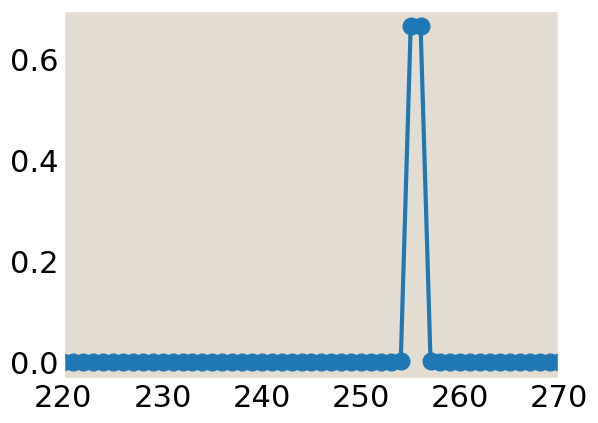

In [309]:
plt.plot(psfTrGaussMatchAirynov7[len(psfTrGaussMatchAirynov7)//2], 'o-')
plt.xlim([220, 270])

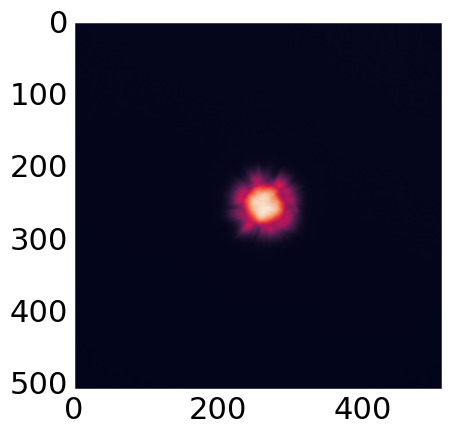

In [278]:


plt.imshow(motStacknov7[len(motStacknov7)//2])

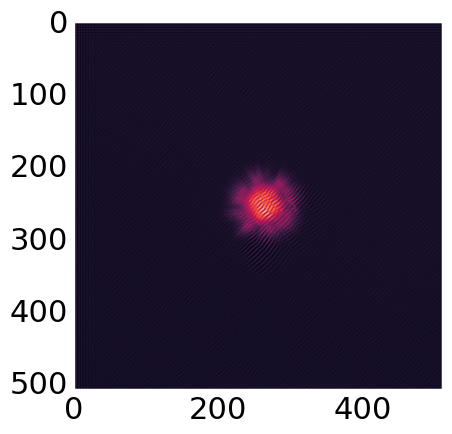

In [279]:
plt.imshow(deconv2DGaussnov7)

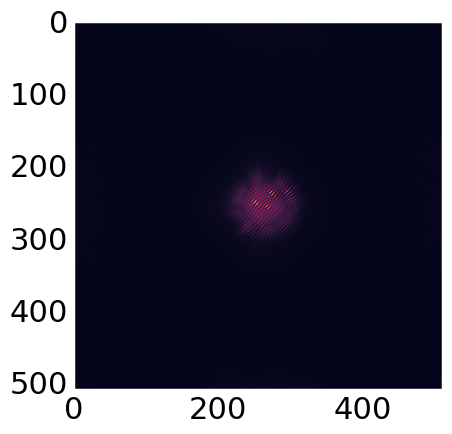

In [280]:
plt.imshow(deconv2DAirynov7)

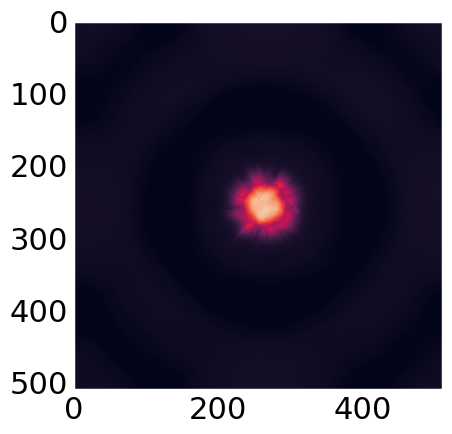

In [281]:
plt.imshow(twoDRLnov7)

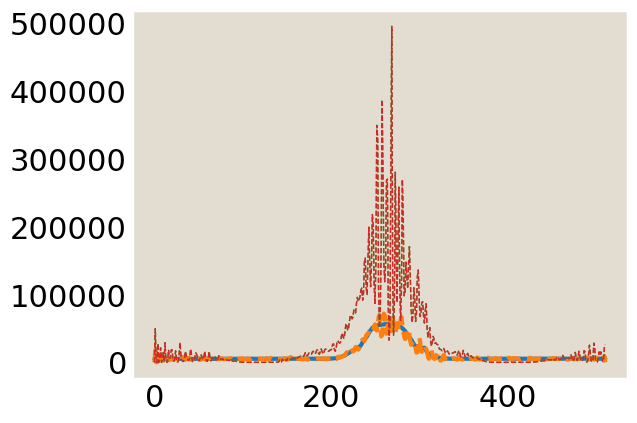

In [571]:
#plt.plot(twoDRLnov7[len(twoDRLnov7)//2], label='fiji')
plt.plot(motStacknov7[len(motStacknov7)//2, len(motStacknov7[0])//2], label='orig')
plt.plot(deconv2DGaussnov7[len(deconv2DGaussnov7)//2], '--', label='gauss')
plt.plot(deconv2DAirynov7[len(deconv2DAirynov7)//2], '--', label='airy', lw=1)
plt.plot(deconv2DAirynov7normed[len(deconv2DAirynov7)//2], '--', label='airynorm', lw=1)
#plt.plot(deconv2DGaussnov7normed[len(deconv2DGaussnov7)//2], '--', label='Gaussnorm', lw=1)
#plt.plot(deconv2DGaussMatchAirynov7normed[len(deconv2DGaussMatchAirynov7normed)//2], '--', label='GaussnormMatch')
# plt.legend()

In [ ]:
deconv = restoration.richardson_lucy(motStack_bs, psfStack, num_iter=30)

# Nov 2

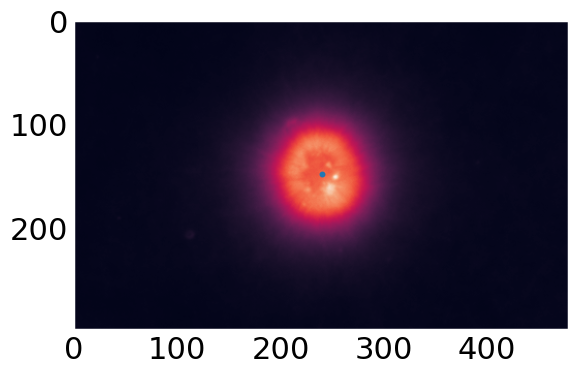

In [32]:
plt.imshow(motStacknov2[60])
plt.scatter(240, 148, s=5)


In [33]:
len(motStacknov2)/2

60.5

Text(0.5, 1.0, 'yz')

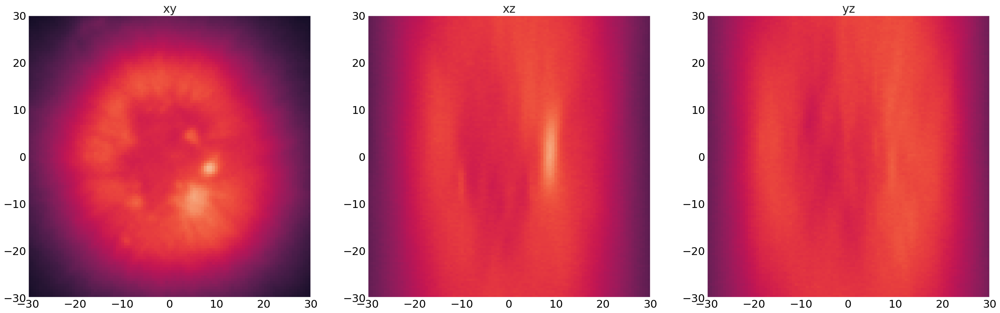

In [34]:
#not deconvolved
numum = 60
zl = int(len(motStacknov2)/2 - numum/(2*umperpxZ))
zh = int(len(motStacknov2)/2 + numum/(2*umperpxZ))
xl = int(240 - numum/(2*umperpxXY))
xh = int(240 + numum/(2*umperpxXY))
yl = int(148 - numum/(2*umperpxXY))
yh = int(148 + numum/(2*umperpxXY))

fig, ax = plt.subplots(1,3, figsize=(35, 35))
ax[0].imshow(motStacknov2[len(motStacknov2)//2, yl:yh, xl:xh ], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin=5000, vmax=35000)
ax[1].imshow(motStacknov2[zl:zh, motStacknov2.shape[1]//2,xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin=5000, vmax=35000)
ax[2].imshow(motStacknov2[zl:zh,yl:yh, motStacknov2.shape[2]//2], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin=5000, vmax=35000)

ax[0].set_title('xy')
ax[1].set_title('xz')
ax[2].set_title('yz')

# Gridlines based on minor ticks

#plt.savefig('20250708_slice.pdf', bbox_inches='tight', transparent=True)

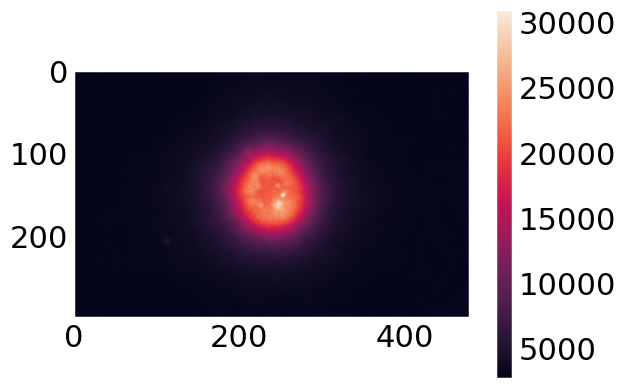

In [35]:
plt.imshow(motStacknov2[60])
plt.colorbar()

Text(0.5, 1.0, 'yz')

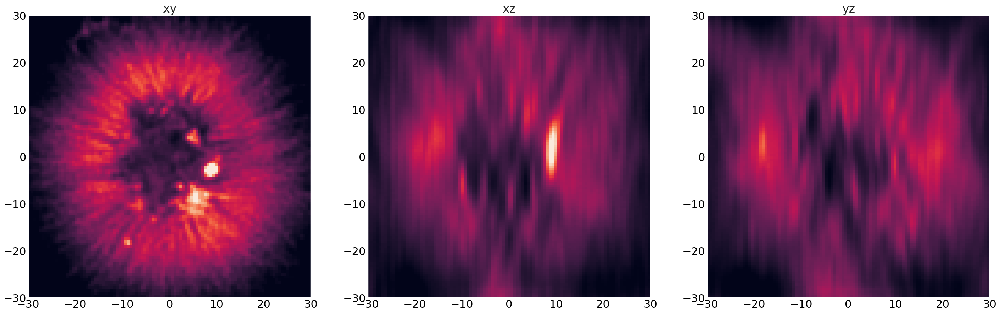

In [36]:
#not deconvolved
numum = 60
zl = int(len(deconvnov2)/2 - numum/(2*umperpxZ))
zh = int(len(deconvnov2)/2 + numum/(2*umperpxZ))
xl = int(240 - numum/(2*umperpxXY))
xh = int(240 + numum/(2*umperpxXY))
yl = int(148 - numum/(2*umperpxXY))
yh = int(148 + numum/(2*umperpxXY))

fig, ax = plt.subplots(1,3, figsize=(35, 35))
ax[0].imshow(deconvnov2[len(deconvnov2)//2, yl:yh, xl:xh ], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin=10000, vmax=60000)
ax[1].imshow(deconvnov2[zl:zh, deconvnov2.shape[1]//2,xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin=10000, vmax=60000)
ax[2].imshow(deconvnov2[zl:zh,yl:yh, deconvnov2.shape[2]//2], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin=10000, vmax=60000)

ax[0].set_title('xy')
ax[1].set_title('xz')
ax[2].set_title('yz')

/tmp/ipykernel_66965/2402598719.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10,10))


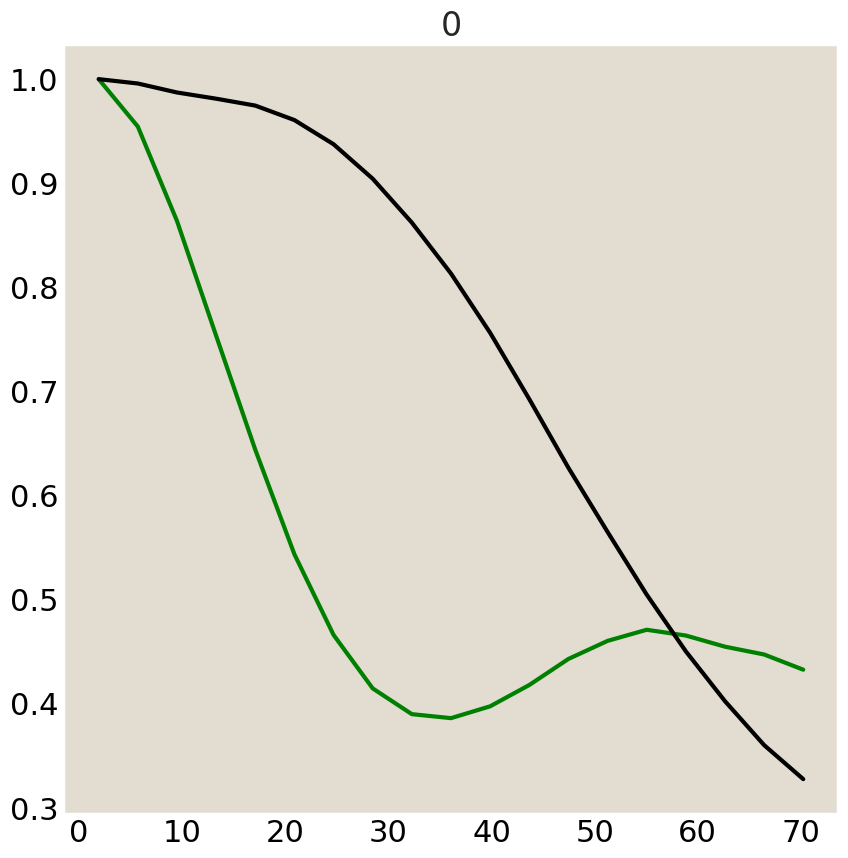

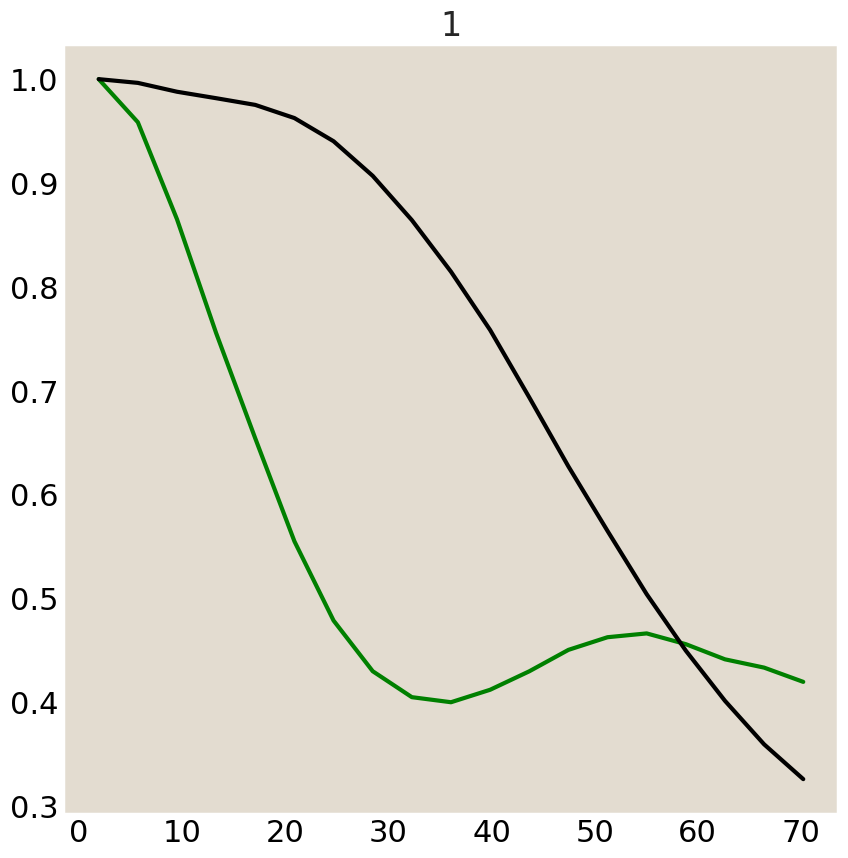

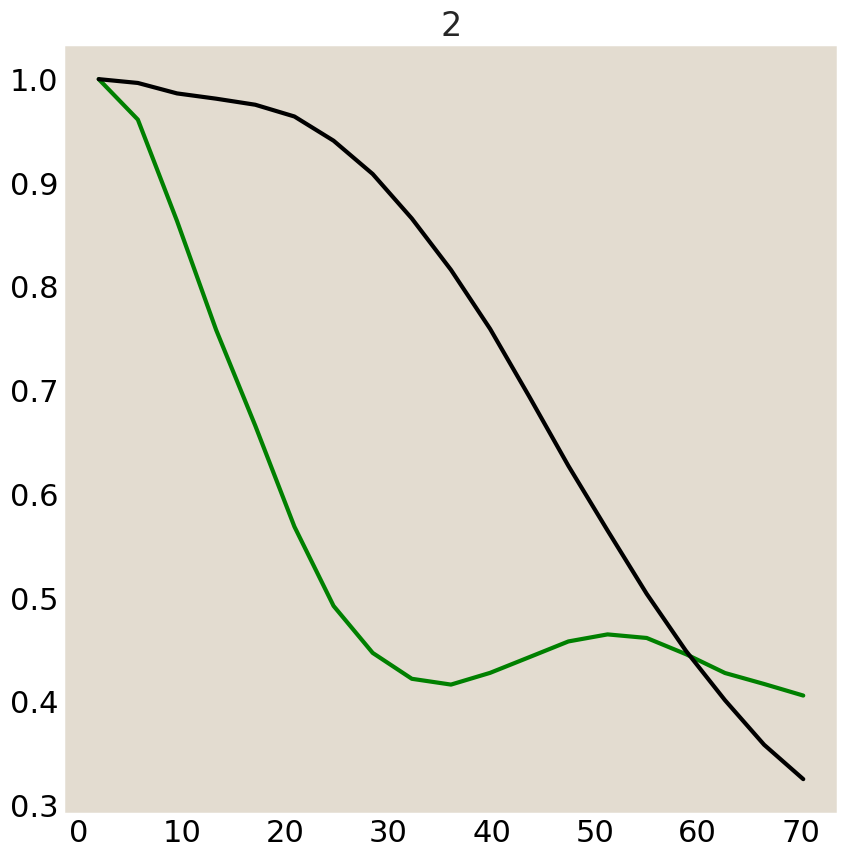

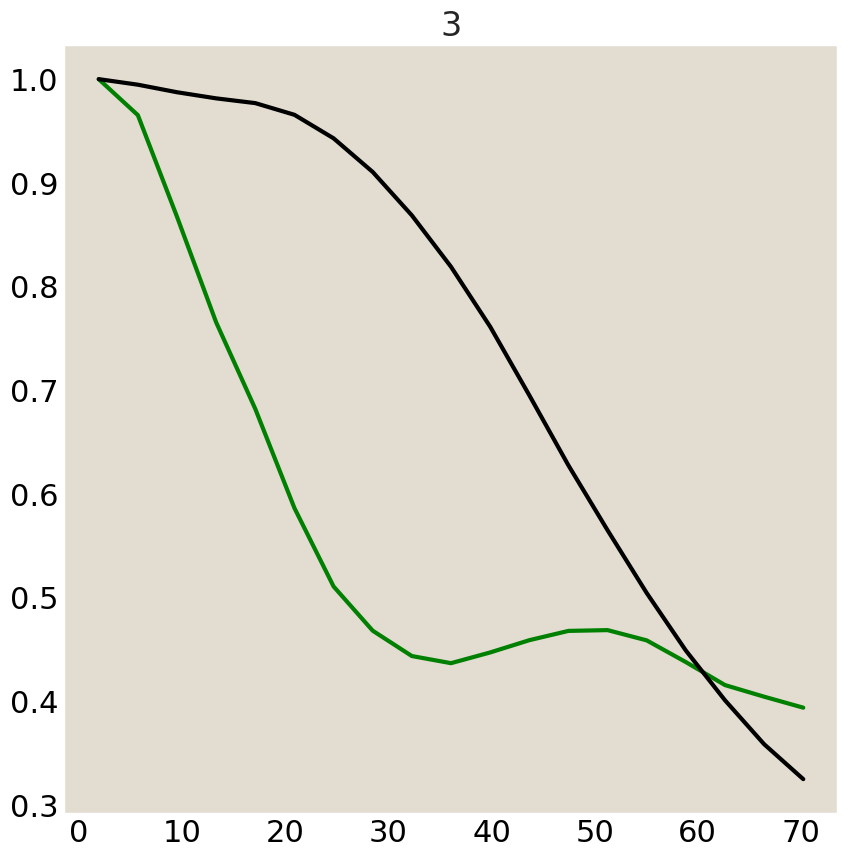

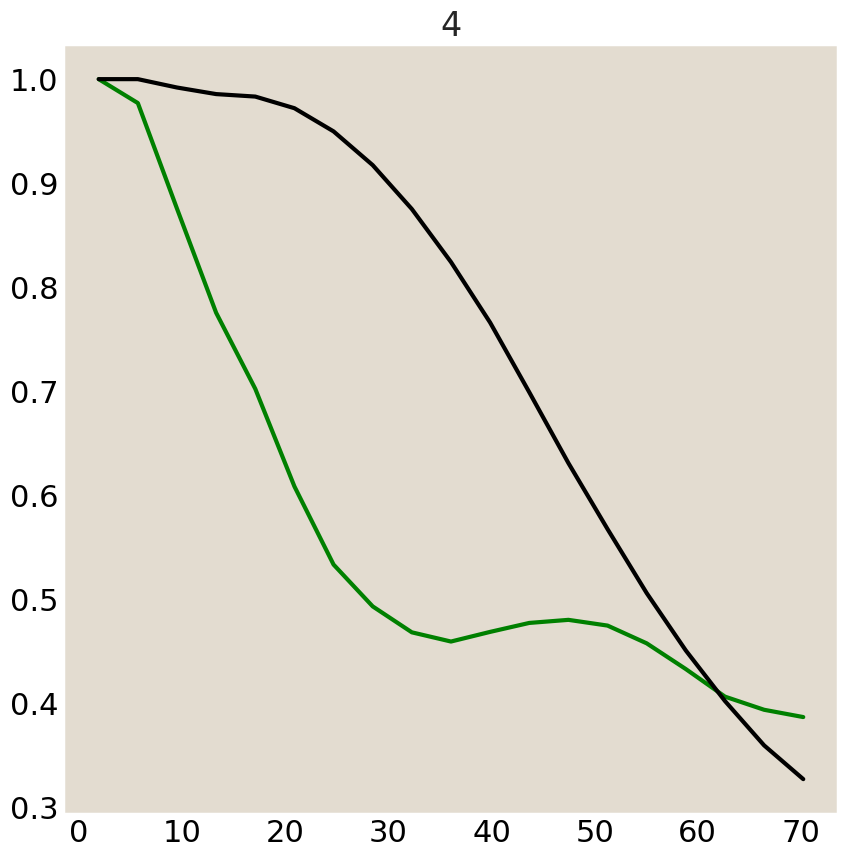

...

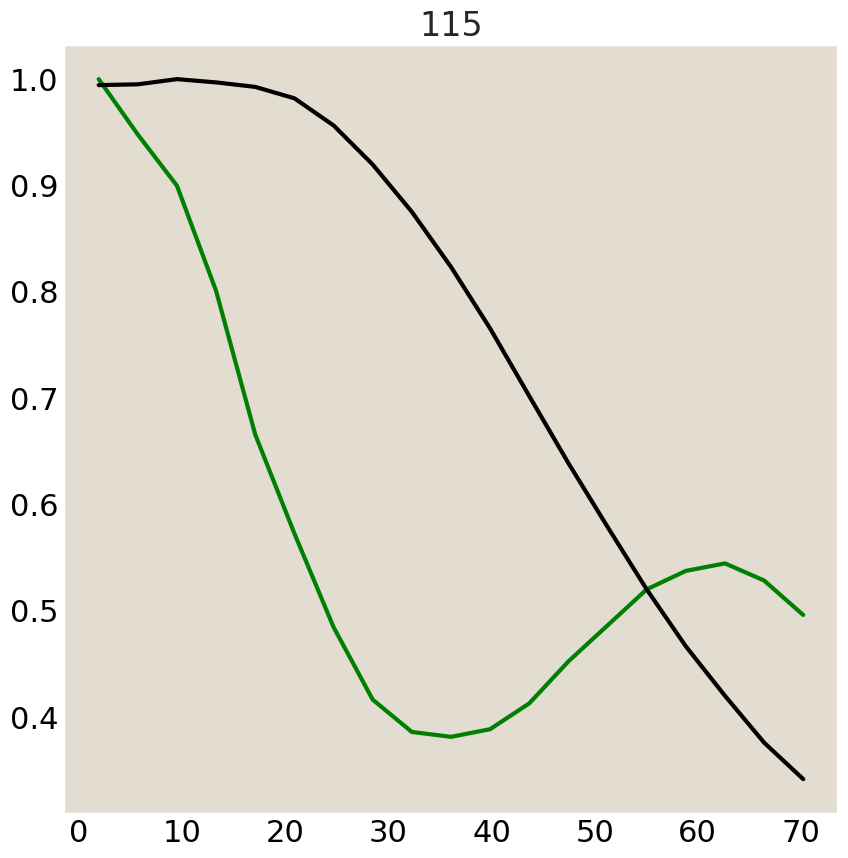

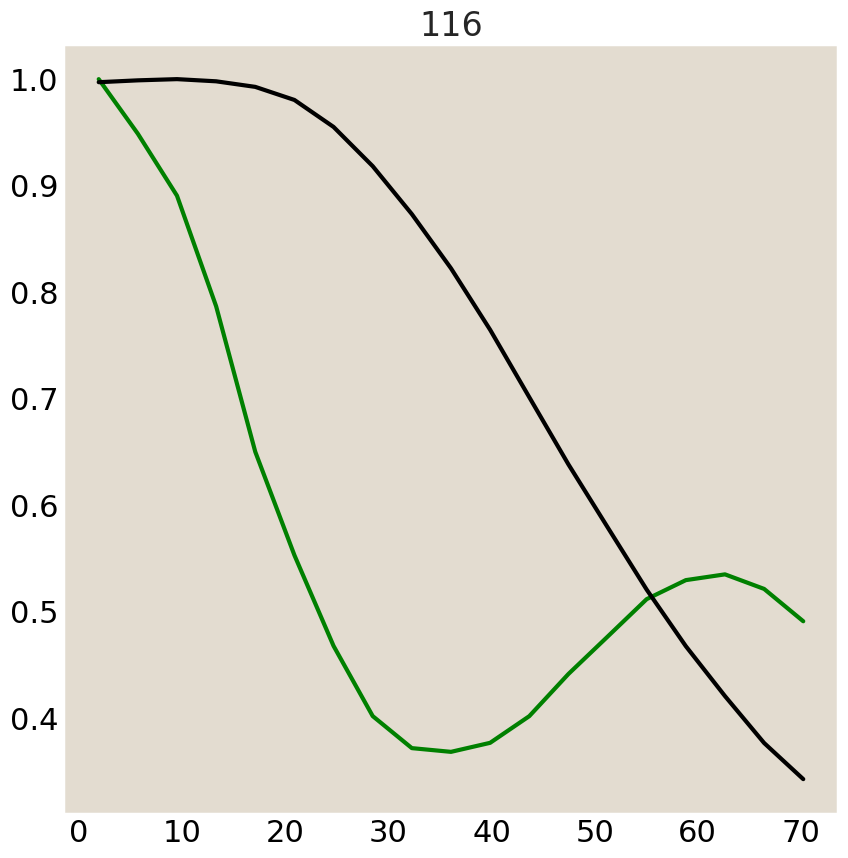

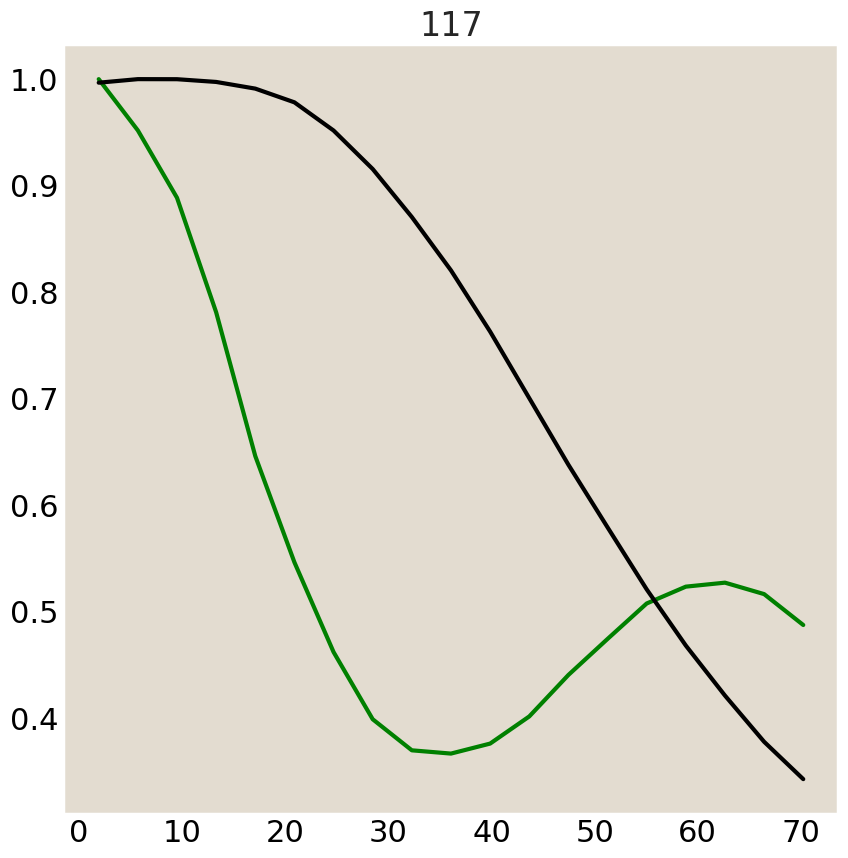

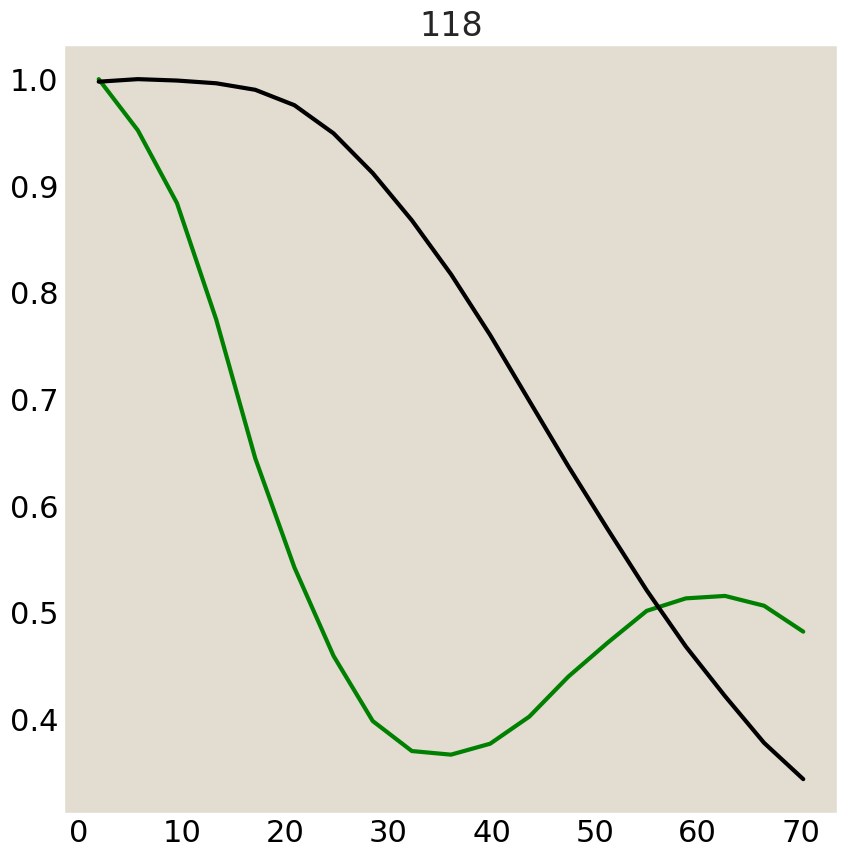

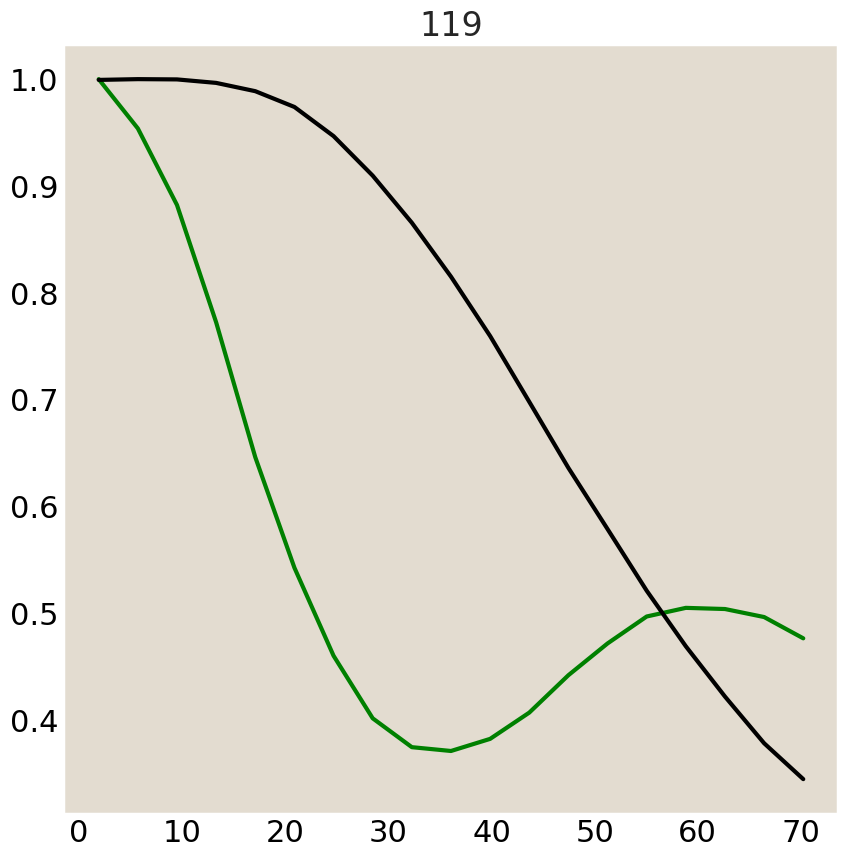

In [37]:
for z in range(120):#[10, 20, 30, 40, 50, 60, 70, 80, 90, 100]:
    fig, ax = plt.subplots(figsize=(10,10))
    zcent=z
    #radially average
    rDec, rAvgDecs=polarAverage(deconvnov2[zcent, yl:yh, xl:xh])
    plt.plot(rDec, rAvgDecs/rAvgDecs.max(), color='green')
    #plt.plot(rDec, rAvgDecs, color='green')
    rRaw, rAvgRaws=polarAverage(motStacknov2[zcent, yl:yh, xl:xh])
    plt.plot(rRaw, rAvgRaws/rAvgRaws.max(), color='k')
    #plt.plot(rRaw, rAvgRaws, color='k')
    plt.title(z)


/tmp/ipykernel_66965/3880309921.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10,10))


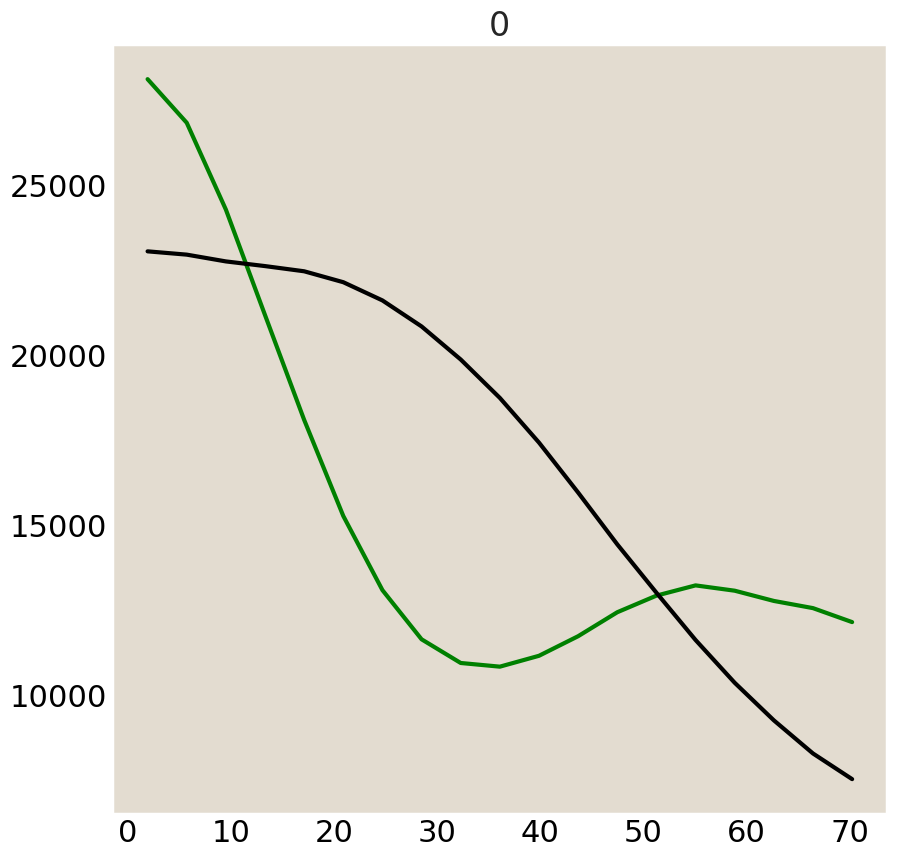

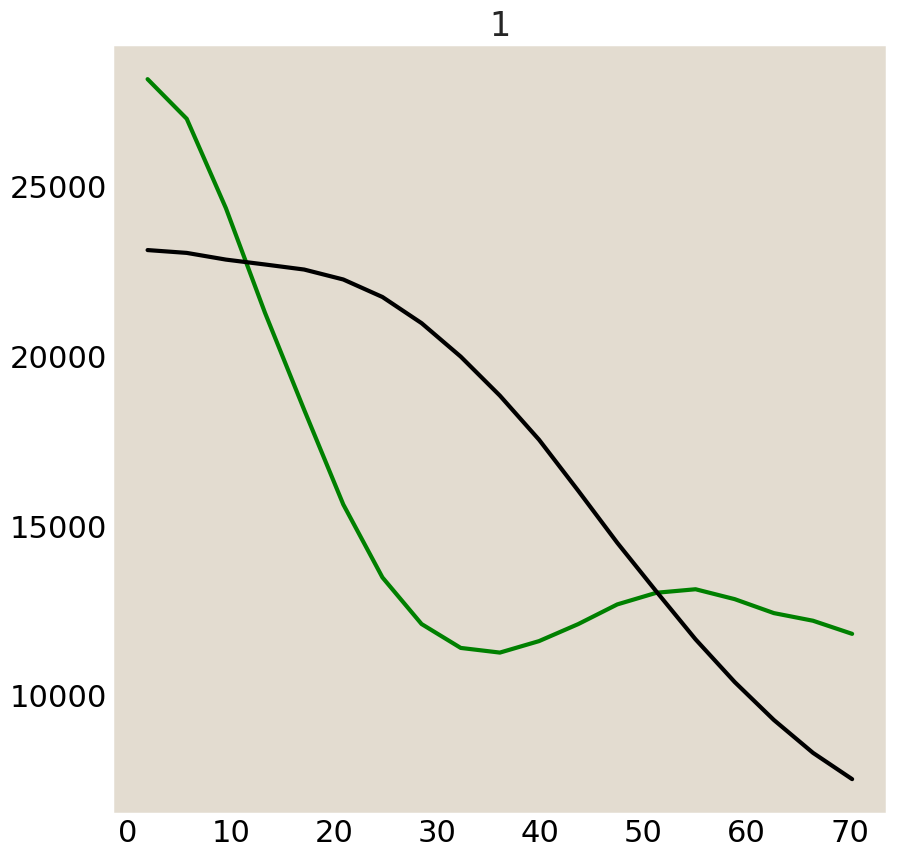

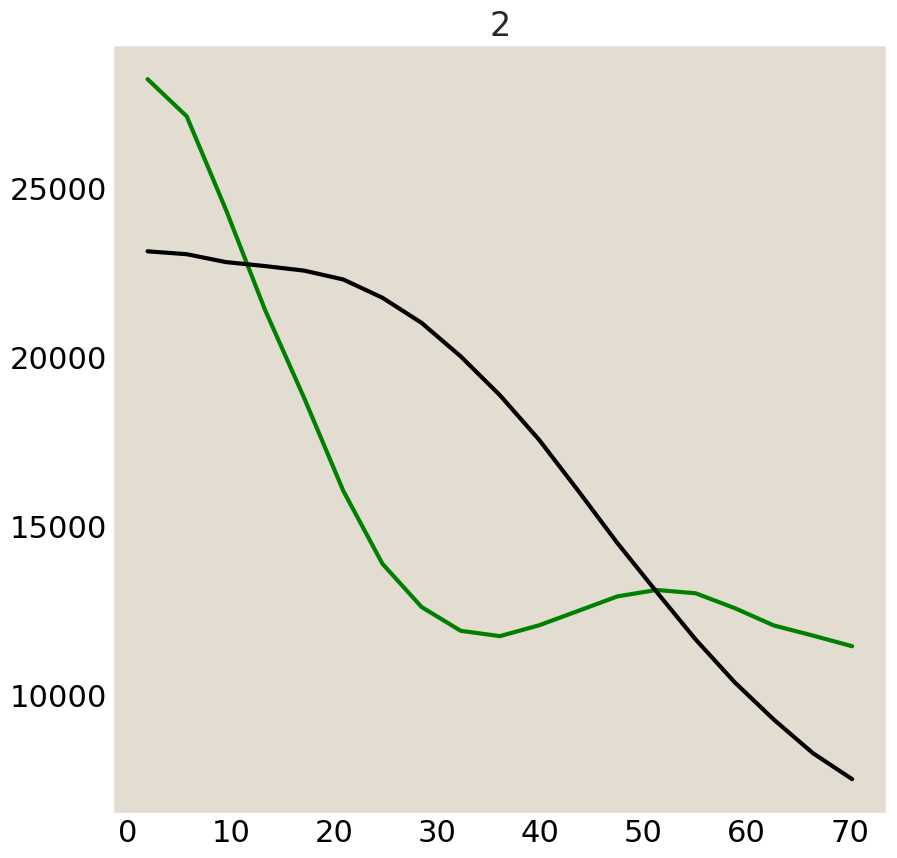

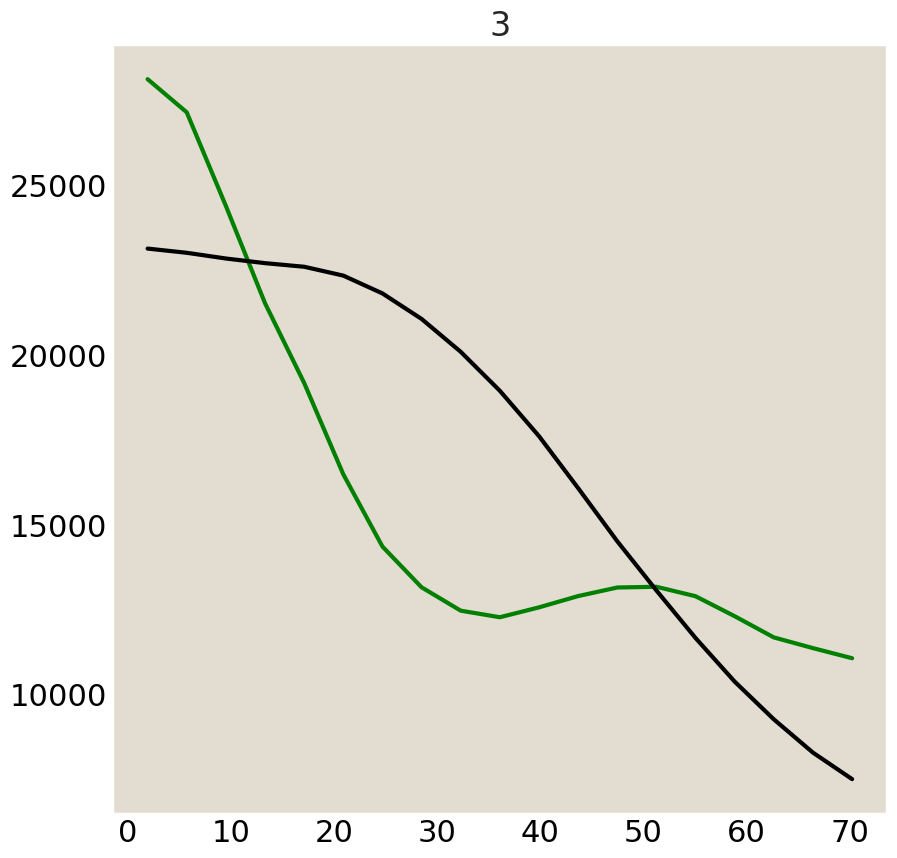

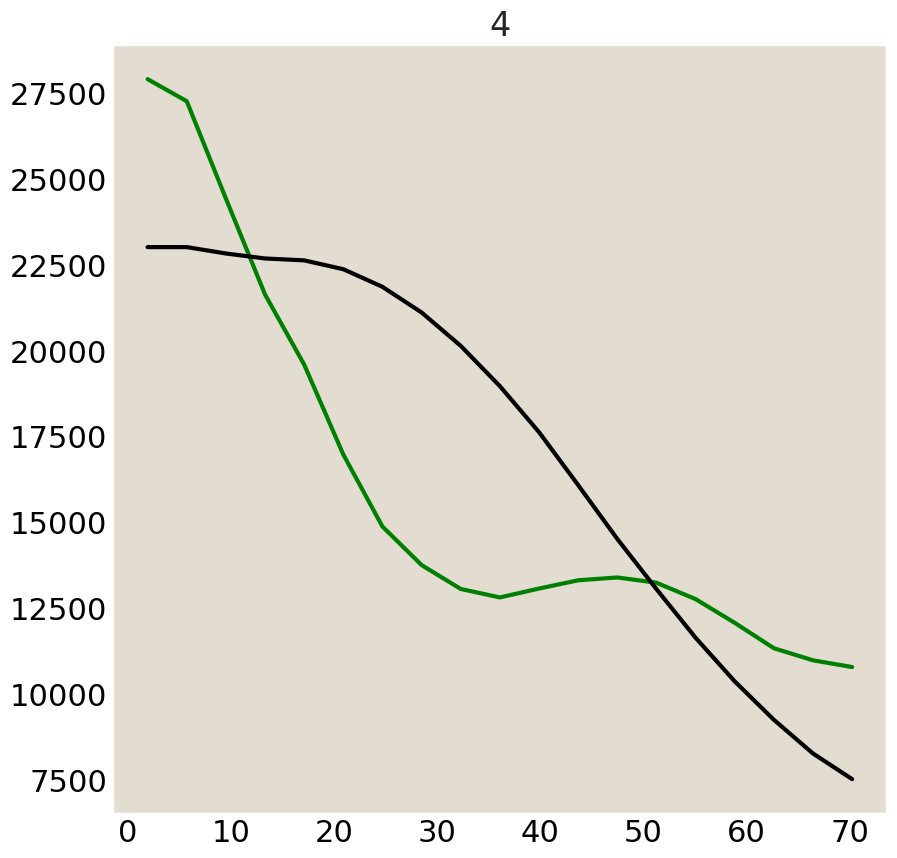

...

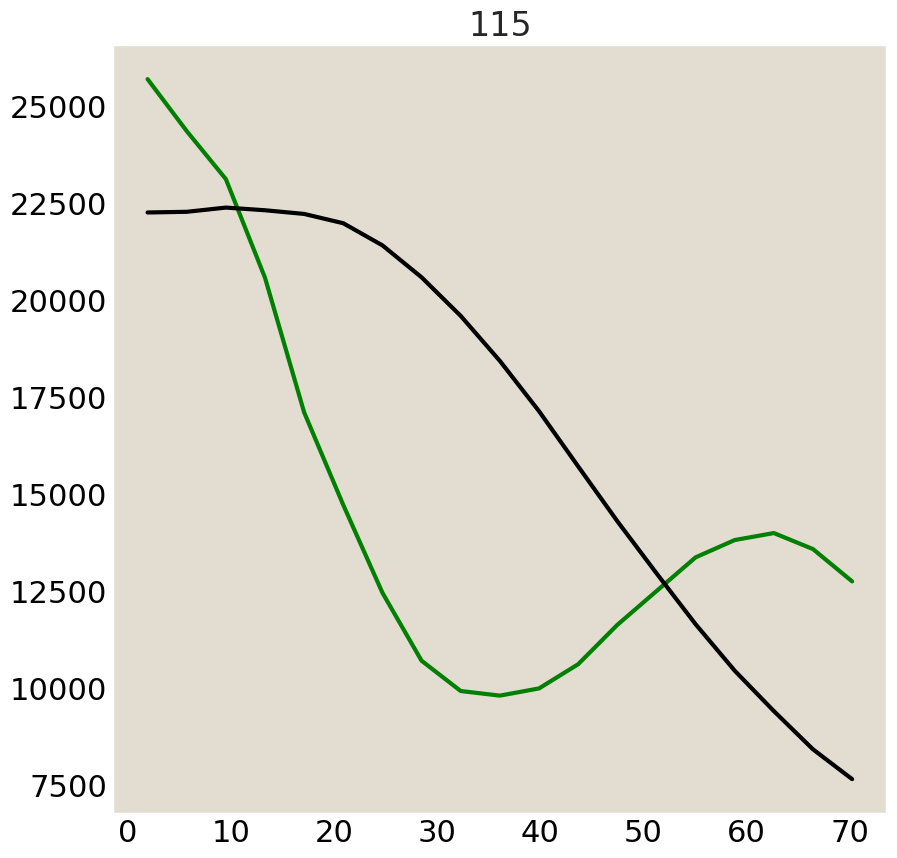

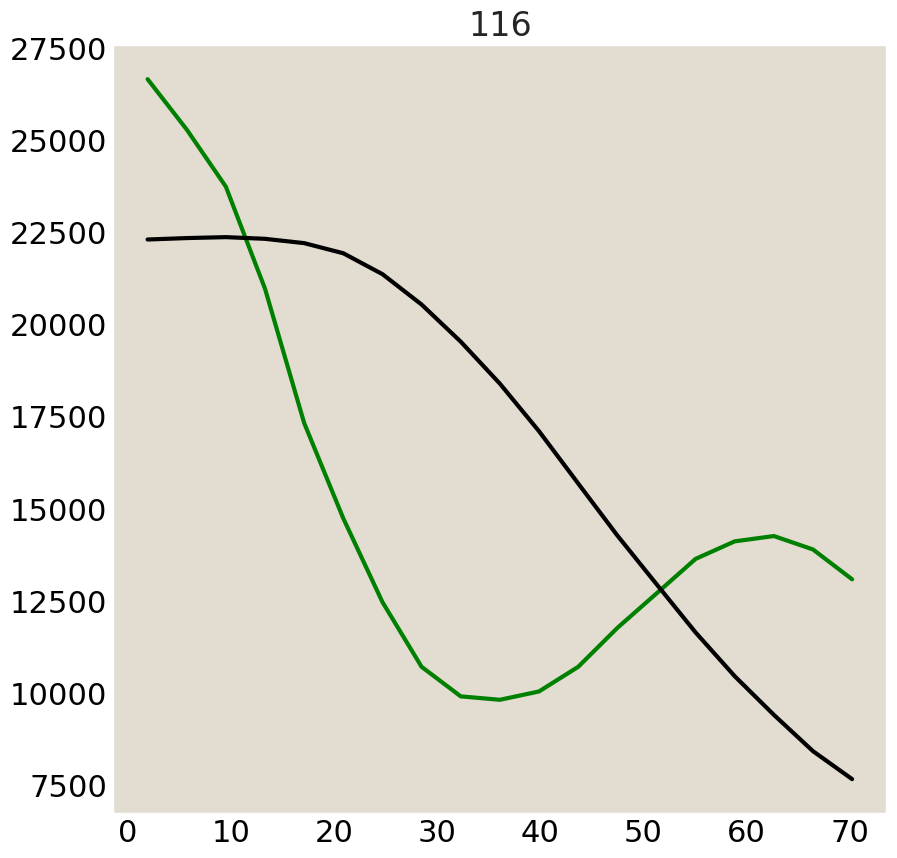

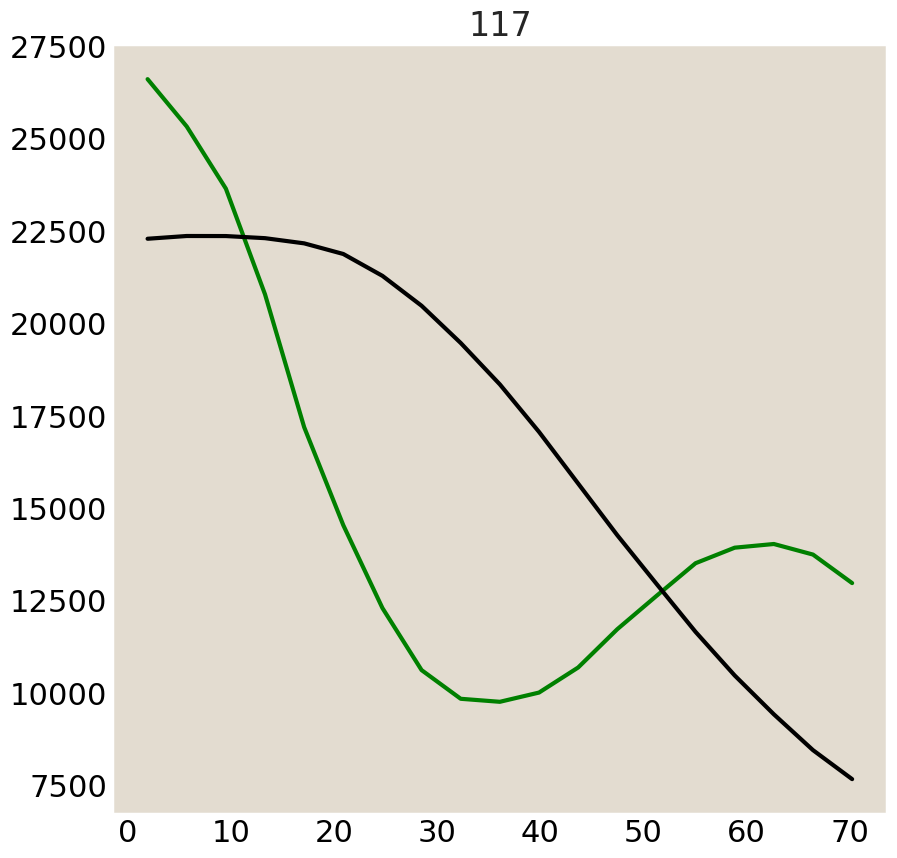

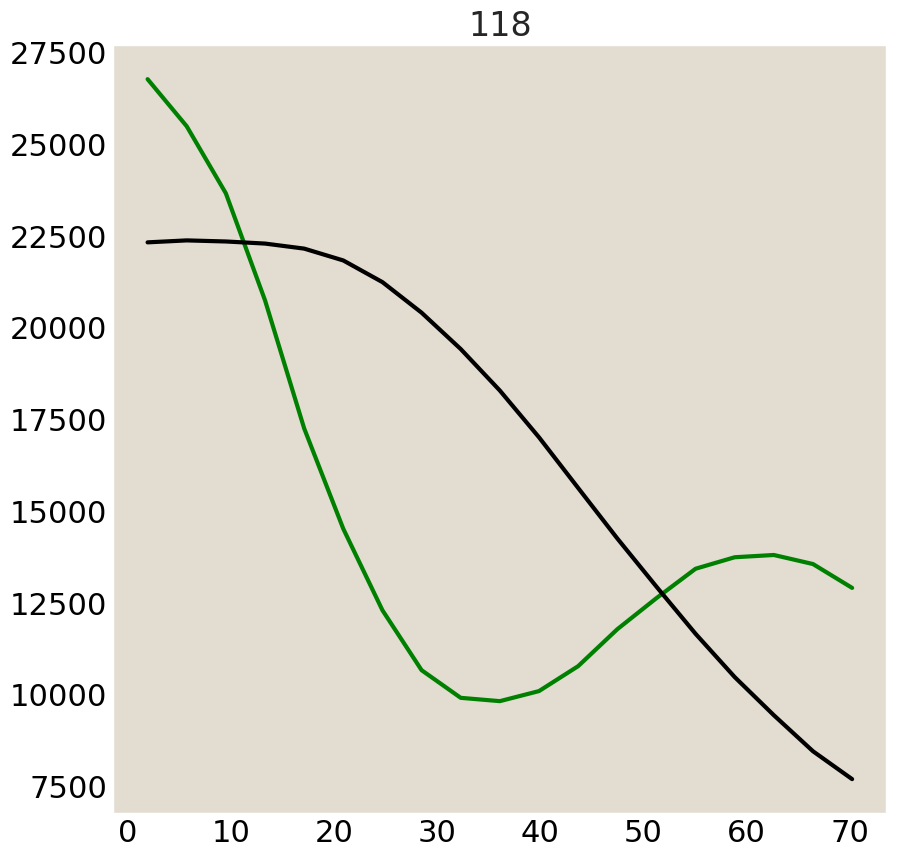

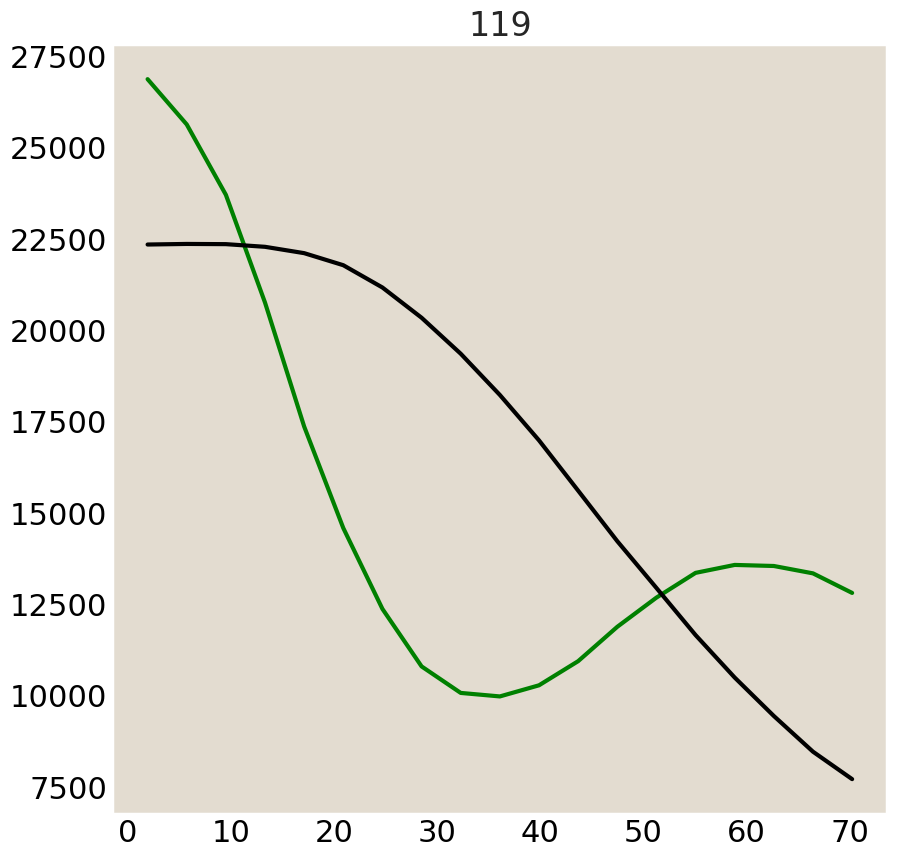

In [38]:
for z in range(120):#[10, 20, 30, 40, 50, 60, 70, 80, 90, 100]:
    fig, ax = plt.subplots(figsize=(10,10))
    zcent=z
    #radially average
    rDec, rAvgDecs=polarAverage(deconvnov2[zcent, yl:yh, xl:xh])
    #plt.plot(rDec, rAvgDecs/rAvgDecs.max(), color='green')
    plt.plot(rDec, rAvgDecs, color='green')
    rRaw, rAvgRaws=polarAverage(motStacknov2[zcent, yl:yh, xl:xh])
    #plt.plot(rRaw, rAvgRaws/rAvgRaws.max(), color='k')
    
    plt.plot(rRaw, rAvgRaws, color='k')
    plt.title(z)


# try to measure sigma from PSF
### Nov 2 PSF Fits

visualizations

In [318]:
psfStacknov2.shape, psfStacknov7.shape

((121, 300, 480), (120, 512, 512))

In [319]:
umperpxXYnov7

0.5783984375

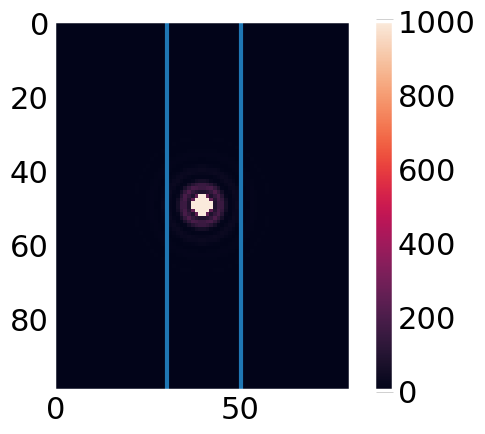

In [39]:
plt.imshow(psfStacknov2[len(psfStacknov2)//2, 100:200, 200:280], vmin = 0, vmax=1000)
plt.colorbar()
plt.axvline(230-200)
plt.axvline(250-200)

more vis

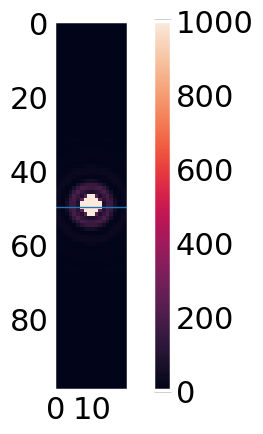

In [40]:
plt.imshow(psfStacknov2[len(psfStacknov2)//2, 100:200, 230:250], vmin = 0, vmax=1000)
plt.colorbar()
plt.axhline(150-100, lw=1)

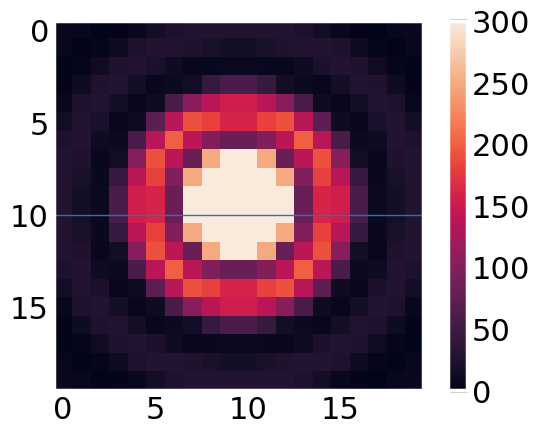

In [41]:
plt.imshow(psfStacknov2[len(psfStacknov2)//2, 140:160, 230:250], vmin = 0, vmax=300)
plt.colorbar()
plt.axhline(150-140, lw=1)

In [42]:
#look for position of first dark ring --> check airy form sin\theta whatever and relation to rayleigh

In [43]:
def airyGauss(u, I0, sig):
    return I0*np.exp(-u**2/(2*sig**2))

def airyGaussNorm(u, sig):
    return np.exp(-(u**2)/(2*sig**2)) / (np.sqrt((2*np.pi*sig**2)**1))

can ignore normalized because should just change by a scale factor, just deal with fitting the non norm gauss and get the sigma from that

In [45]:
imxaxnov2 = len(psfStacknov2[0,0])
xaxumnov2 = np.linspace(imxaxnov2//2*-1+0.5, imxaxnov2//2-0.5, imxaxnov2)*umperpxXYnov2

imyaxnov2 = len(psfStacknov2[0])
yaxumnov2 = np.linspace(imyaxnov2//2*-1+0.5, imyaxnov2//2-0.5, imyaxnov2)*umperpxXYnov2

imzaxnov2 = len(psfStacknov2)
zaxumnov2 = np.linspace(imzaxnov2//2*-1, imzaxnov2//2, imzaxnov2)*umperpxZnov2

#not normalized
xGaussFitnov2 = scipy.optimize.curve_fit(airyGauss, xaxumnov2, psfStacknov2[imzaxnov2//2, imyaxnov2//2], [60000, 2] )
yGaussFitnov2 = scipy.optimize.curve_fit(airyGauss, yaxumnov2, psfStacknov2[imzaxnov2//2, :, imxaxnov2//2], [60000, 2] )
zGaussFitnov2 = scipy.optimize.curve_fit(airyGauss, zaxumnov2, psfStacknov2[:, imyaxnov2//2, imxaxnov2//2], [60000, 2] )

#normalized
xGaussNormFitnov2 = scipy.optimize.curve_fit(airyGaussNorm, xaxumnov2/umperpxXYnov2, psfStacknov2[imzaxnov2//2, imyaxnov2//2]/np.sum(psfStacknov2[imzaxnov2//2, imyaxnov2//2]), [2] )
yGaussNormFitnov2 = scipy.optimize.curve_fit(airyGaussNorm, yaxumnov2, psfStacknov2[imzaxnov2//2, :, imxaxnov2//2]/np.sum(psfStacknov2[imzaxnov2//2, :, imxaxnov2//2]), [2] )
zGaussNormFitnov2 = scipy.optimize.curve_fit(airyGaussNorm, zaxumnov2, psfStacknov2[:, imyaxnov2//2, imxaxnov2//2]/np.sum(psfStacknov2[:, imyaxnov2//2, imxaxnov2//2]), [2] )




Not normalized

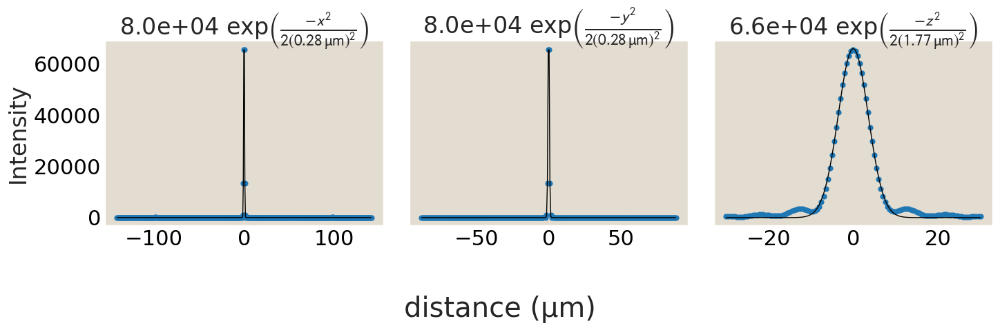

In [48]:
fig, ax = plt.subplots(1,3, figsize=(15, 5), sharey=True)
ax[0].scatter(xaxumnov2, psfStacknov2[imzaxnov2//2, imyaxnov2//2], s=15)
ax[0].plot(xaxumnov2, airyGauss(xaxumnov2, xGaussFitnov2[0][0], xGaussFitnov2[0][1]), 'k-', lw=1)
ax[0].set_title(f'{round(xGaussFitnov2[0][0]):.1e}'+rf' exp$\left( \frac{{-x^2}}{{2({round(xGaussFitnov2[0][1]*umperpxXYnov2,2)}\mathrm{{\, \mu m}})^2}} \right)$')
#ax[0].set_title(rf'{round(xGaussFitnov2[0][0])}$e^{{-x^2/{round(xGaussFitnov2[0][1]*umperpxXYnov2,2)}}}$')
#ax[0].set_ylim(-10, 100)

ax[1].scatter(yaxumnov2, psfStacknov2[imzaxnov2//2, :, imxaxnov2//2], s=15)
ax[1].plot(yaxumnov2, airyGauss(yaxumnov2, yGaussFitnov2[0][0], yGaussFitnov2[0][1]), 'k-', lw=1)
ax[1].set_title(f'{round(yGaussFitnov2[0][0]):.1e}'+rf' exp$\left( \frac{{-y^2}}{{2({round(yGaussFitnov2[0][1]*umperpxXYnov2,2)}\mathrm{{\, \mu m}})^2}} \right)$')

ax[2].scatter(zaxumnov2, psfStacknov2[:, imyaxnov2//2, imxaxnov2//2], s=15)
ax[2].plot(zaxumnov2, airyGauss(zaxumnov2, zGaussFitnov2[0][0], zGaussFitnov2[0][1]), 'k-', lw=1)
ax[2].set_title(f'{round(zGaussFitnov2[0][0]):.1e}'+rf' exp$\left( \frac{{-z^2}}{{2({round(zGaussFitnov2[0][1]*umperpxZnov2,2)} \mathrm{{\, \mu m}})^2}} \right)$')
#ax[2].set_title(rf'{round(zGaussFitnov2[0][0])}$e^{{-z^2/{round(zGaussFitnov2[0][1]*umperpxZnov2,2)}}}$')

fig.supxlabel('distance (µm)')
ax[0].set_ylabel('Intensity')
plt.tight_layout()

#plt.savefig('../../analyzed_data/aster/zstacks/20250727_nov2SigmaFits.pdf', bbox_inches='tight')

Normalized

show the psf from different angles and at different contrasts

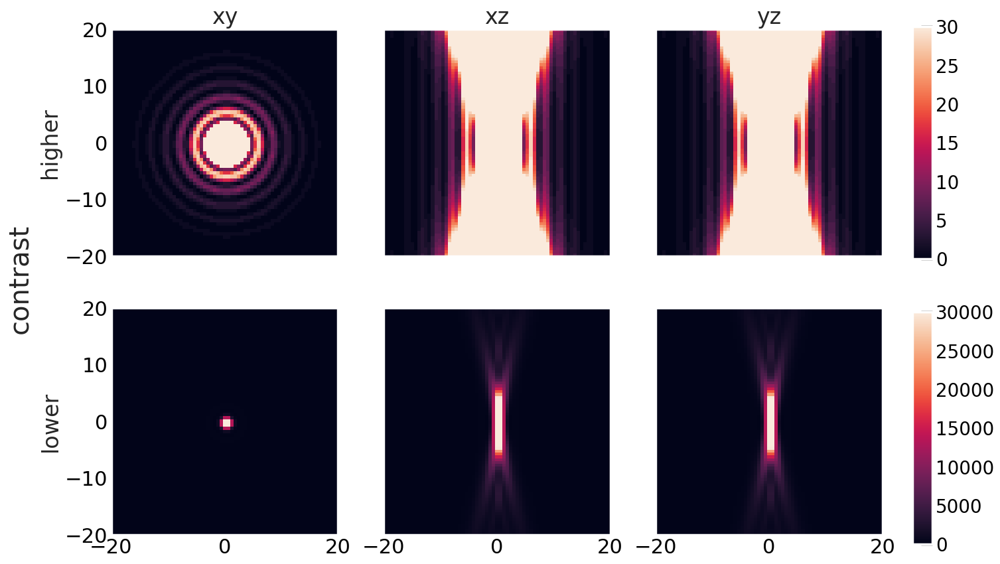

In [49]:
numum = 40
zl = int(len(psfStacknov2)/2 - numum/(2*umperpxZ))
zh = int(len(psfStacknov2)/2 + numum/(2*umperpxZ))
xl = int(len(psfStacknov2[0,0])/2 - numum/(2*umperpxXYnov2))
xh = int(len(psfStacknov2[0,0])/2 + numum/(2*umperpxXYnov2))
yl = int(len(psfStacknov2[0])/2 - numum/(2*umperpxXYnov2))
yh = int(len(psfStacknov2[0])/2 + numum/(2*umperpxXYnov2))

fig, ax = plt.subplots(2,3, figsize=(15,10), sharex=True, sharey=True)

ax[0,0].imshow(psfStacknov2[len(psfStacknov2)//2, yl:yh, xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin = 0, vmax=30)
#ax[0,0].axhline(150-140, lw=1)

ax[0,1].imshow(psfStacknov2[zl:zh, len(psfStacknov2[0])//2, xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin = 0, vmax=30)
#ax[1].axhline(150-140, lw=1)

ax[0,2].imshow(psfStacknov2[zl:zh, yl:yh, len(psfStacknov2[0,0])//2], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin = 0, vmax=30)
#ax[2].axhline(150-140, lw=1)


ax[1,0].imshow(psfStacknov2[len(psfStacknov2)//2, yl:yh, xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin = 0, vmax=30000)
#ax[0,0].axhline(150-140, lw=1)

ax[1,1].imshow(psfStacknov2[zl:zh, len(psfStacknov2[0])//2, xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin = 0, vmax=30000)
#ax[1].axhline(150-140, lw=1)

ax[1,2].imshow(psfStacknov2[zl:zh, yl:yh, len(psfStacknov2[0,0])//2], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin = 0, vmax=30000)
#ax[2].axhline(150-140, lw=1)

ax[0,0].set_title('xy')
ax[0,1].set_title('xz')
ax[0,2].set_title('yz')

ax[0,0].set_ylabel('higher')
ax[1,0].set_ylabel('lower')
fig.supylabel('contrast')


#### Top Colorbar ####
caxtop = fig.add_axes([0.93, 0.53, 0.02, 0.35])  # horizontal [left, bottom, width, height]
cbartop = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=0, vmax=30)),
                    cax=caxtop, 
                    orientation='vertical')
cbartop.ax.tick_params(labelsize=20)

#### Bottom Colorbar ####
caxbot = fig.add_axes([0.93, 0.1, 0.02, 0.35])  # horizontal [left, bottom, width, height]
cbarbot = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=0, vmax=30000)),
                    cax=caxbot, 
                    orientation='vertical')
cbarbot.ax.tick_params(labelsize=20)

#plt.savefig('../../analyzed_data/aster/zstacks/20250727_nov2PSFCrossSections.pdf', bbox_inches='tight')

### Nov 7 PSF Fits

In [52]:
imxaxnov7 = len(psfStacknov7[0,0])
xaxumnov7 = np.linspace(imxaxnov7//2*-1+0.5, imxaxnov7//2-0.5, imxaxnov7)*umperpxXYnov7

imyaxnov7 = len(psfStacknov7[0])
yaxumnov7 = np.linspace(imyaxnov7//2*-1+0.5, imyaxnov7//2-0.5, imyaxnov7)*umperpxXYnov7

imzaxnov7 = len(psfStacknov7)
zaxumnov7 = np.linspace(imzaxnov7//2*-1, imzaxnov7//2, imzaxnov7)*umperpxZnov7

#not normalized
xGaussFitnov7 = scipy.optimize.curve_fit(airyGauss, xaxumnov7, psfStacknov7[imzaxnov7//2, imyaxnov7//2], [60000, 2] )
yGaussFitnov7 = scipy.optimize.curve_fit(airyGauss, yaxumnov7, psfStacknov7[imzaxnov7//2, :, imxaxnov7//2], [60000, 2] )
zGaussFitnov7 = scipy.optimize.curve_fit(airyGauss, zaxumnov7, psfStacknov7[:, imyaxnov7//2, imxaxnov7//2], [60000, 2] )





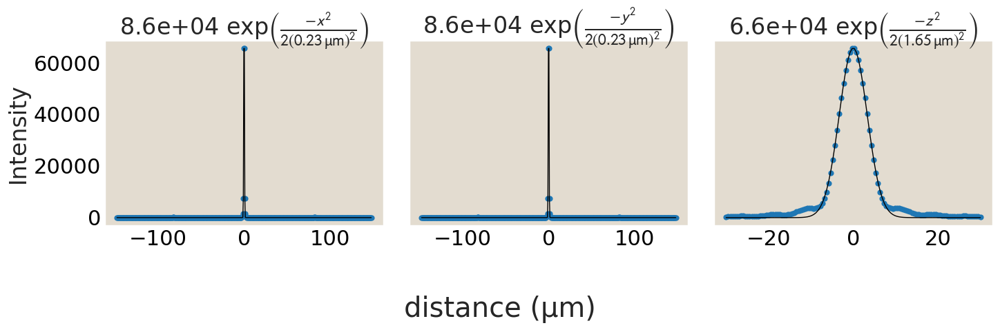

In [53]:
fig, ax = plt.subplots(1,3, figsize=(15, 5), sharey=True)
ax[0].scatter(xaxumnov7, psfStacknov7[imzaxnov7//2, imyaxnov7//2], s=15)
ax[0].plot(xaxumnov7, airyGauss(xaxumnov7, xGaussFitnov7[0][0], xGaussFitnov7[0][1]), 'k-', lw=1)
ax[0].set_title(f'{round(xGaussFitnov7[0][0]):.1e}'+rf' exp$\left( \frac{{-x^2}}{{2({round(xGaussFitnov7[0][1]*umperpxXYnov7,2)}\mathrm{{\, \mu m}})^2}} \right)$')
#ax[0].set_title(rf'{round(xGaussFitnov7[0][0])}$e^{{-x^2/{round(xGaussFitnov7[0][1]*umperpxXYnov7,2)}}}$')
#ax[0].set_ylim(-10, 100)

ax[1].scatter(yaxumnov7, psfStacknov7[imzaxnov7//2, :, imxaxnov7//2], s=15)
ax[1].plot(yaxumnov7, airyGauss(yaxumnov7, yGaussFitnov7[0][0], yGaussFitnov7[0][1]), 'k-', lw=1)
ax[1].set_title(f'{round(yGaussFitnov7[0][0]):.1e}'+rf' exp$\left( \frac{{-y^2}}{{2({round(yGaussFitnov7[0][1]*umperpxXYnov7,2)}\mathrm{{\, \mu m}})^2}} \right)$')

ax[2].scatter(zaxumnov7, psfStacknov7[:, imyaxnov7//2, imxaxnov7//2], s=15)
ax[2].plot(zaxumnov7, airyGauss(zaxumnov7, zGaussFitnov7[0][0], zGaussFitnov7[0][1]), 'k-', lw=1)
ax[2].set_title(f'{round(zGaussFitnov7[0][0]):.1e}'+rf' exp$\left( \frac{{-z^2}}{{2({round(zGaussFitnov7[0][1]*umperpxZnov7,2)} \mathrm{{\, \mu m}})^2}} \right)$')
#ax[2].set_title(rf'{round(zGaussFitnov7[0][0])}$e^{{-z^2/{round(zGaussFitnov7[0][1]*umperpxZnov7,2)}}}$')

fig.supxlabel('distance (µm)')
ax[0].set_ylabel('Intensity')
plt.tight_layout()

#plt.savefig('../../analyzed_data/aster/zstacks/20250728_nov7SigmaFits.pdf', bbox_inches='tight')

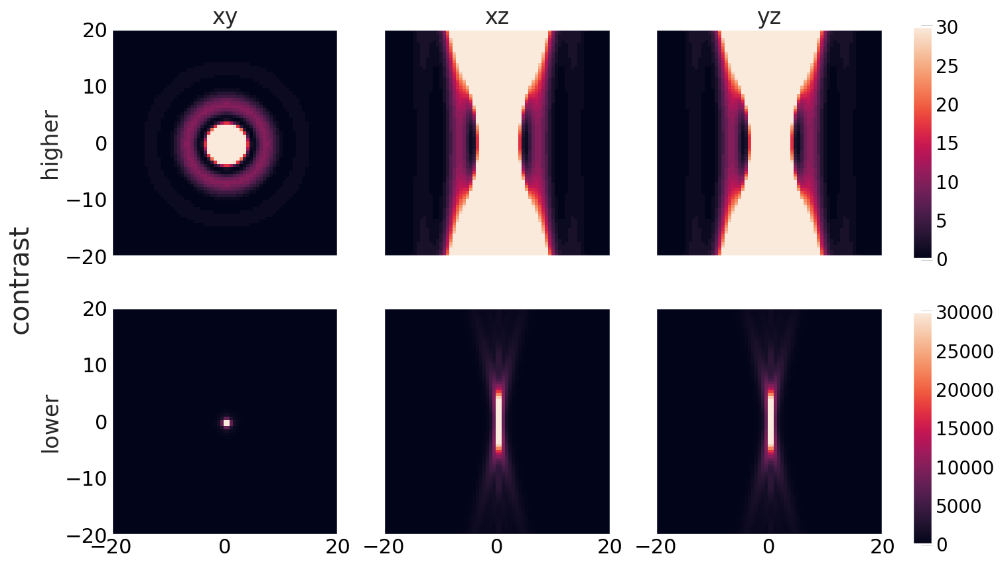

In [58]:
numum = 40
zl = int(len(psfStacknov7)/2 - numum/(2*umperpxZ))
zh = int(len(psfStacknov7)/2 + numum/(2*umperpxZ))
xl = int(len(psfStacknov7[0,0])/2 - numum/(2*umperpxXYnov7))
xh = int(len(psfStacknov7[0,0])/2 + numum/(2*umperpxXYnov7))
yl = int(len(psfStacknov7[0])/2 - numum/(2*umperpxXYnov7))
yh = int(len(psfStacknov7[0])/2 + numum/(2*umperpxXYnov7))

fig, ax = plt.subplots(2,3, figsize=(15,10), sharex=True, sharey=True)

ax[0,0].imshow(psfStacknov7[len(psfStacknov7)//2, yl:yh, xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin = 0, vmax=30)
#ax[0,0].axhline(150-140, lw=1)

ax[0,1].imshow(psfStacknov7[zl:zh, len(psfStacknov7[0])//2, xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin = 0, vmax=30)
#ax[1].axhline(150-140, lw=1)

ax[0,2].imshow(psfStacknov7[zl:zh, yl:yh, len(psfStacknov7[0,0])//2], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin = 0, vmax=30)
#ax[2].axhline(150-140, lw=1)


ax[1,0].imshow(psfStacknov7[len(psfStacknov7)//2, yl:yh, xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin = 0, vmax=30000)
#ax[0,0].axhline(150-140, lw=1)

ax[1,1].imshow(psfStacknov7[zl:zh, len(psfStacknov7[0])//2, xl:xh], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin = 0, vmax=30000)
#ax[1].axhline(150-140, lw=1)

ax[1,2].imshow(psfStacknov7[zl:zh, yl:yh, len(psfStacknov7[0,0])//2], extent=(-numum/2, numum/2, -numum/2, numum/2), vmin = 0, vmax=30000)
#ax[2].axhline(150-140, lw=1)

ax[0,0].set_title('xy')
ax[0,1].set_title('xz')
ax[0,2].set_title('yz')

ax[0,0].set_ylabel('higher')
ax[1,0].set_ylabel('lower')
fig.supylabel('contrast')


#### Top Colorbar ####
caxtop = fig.add_axes([0.93, 0.53, 0.02, 0.35])  # horizontal [left, bottom, width, height]
cbartop = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=0, vmax=30)),
                    cax=caxtop, 
                    orientation='vertical')
cbartop.ax.tick_params(labelsize=20)

#### Bottom Colorbar ####
caxbot = fig.add_axes([0.93, 0.1, 0.02, 0.35])  # horizontal [left, bottom, width, height]
cbarbot = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=0, vmax=30000)),
                    cax=caxbot, 
                    orientation='vertical')
cbarbot.ax.tick_params(labelsize=20)

#plt.savefig('../../analyzed_data/aster/zstacks/20250728_nov7PSFCrossSections.pdf', bbox_inches='tight')

### deconv real data with Gauss psf python **Ana i think this i the best version**

In [542]:
umperpxXYnov7

0.5783984375

In [329]:
tempGaussPSF = np.zeros_like(motStacknov7)

zmin=-umperpxZnov7*len(motStacknov7)/2
zmax=umperpxZnov7*len(motStacknov7)/2
xmin=-umperpxXYnov7*len(motStacknov7[0,0])/2
xmax=umperpxXYnov7*len(motStacknov7[0,0])/2
ymin=-umperpxXYnov7*len(motStacknov7[0])/2
ymax=umperpxXYnov7*len(motStacknov7[0])/2
numz=len(motStacknov7)
numx=len(motStacknov7[0,0])
numy=len(motStacknov7[0])

xvals = np.linspace(xmin, xmax, numx)
yvals = np.linspace(ymin, ymax, numy)
zvals = np.linspace(zmin, zmax, numz)

sigmaTr=0.23;
sigmaAx=1.65; #mu m fixed

# make psf
psfGauss = np.zeros((numx, numy, numz))
for ii in tqdm(range(len(xvals))):
  for j in range(len(yvals)):
    for k in range(len(zvals)):
      psfGauss[ii, j, k]= gaussPSF_tot(xvals[ii], yvals[j], zvals[k], sigmaTr, sigmaAx)


  0%|          | 0/512 [00:00<?, ?it/s]

In [369]:
psfGaussnorm = psfGauss*umperpxXYnov7**2*umperpxZnov7
psfGaussnormtrans = np.transpose(psfGaussnorm , (2, 0, 1))
imageio.mimwrite('20250802GaussPsfNov7AirySigs.tif', psfGaussnormtrans)

Save just the center slice

In [540]:
psfGaussnormtrans[len(psfGaussnormtrans)//2]

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], shape=(512, 512))

In [541]:
imageio.imwrite('20250804GaussPsfNov7AirySigs60.tif', psfGaussnormtrans[len(psfGaussnormtrans)//2])

Try dividing by sum of psf stack

In [374]:
psfAirynorm = psfStacknov7/np.sum(psfStacknov7)
imageio.mimwrite('20250802AiryPsfNov7normbysum.tif', psfAirynorm)

Deconvolved in Fiji using gaussian with airy sigma values and an airy normalized by its sum

In [375]:
deconvNormAirynov7 = tifffile.imread(fpathnov7+'20250802RL100AiryDivBySum.tif')
deconvGaussnov7 = tifffile.imread(fpathnov7+'20250802RL100Gauss0p23XY1p65Z.tif')

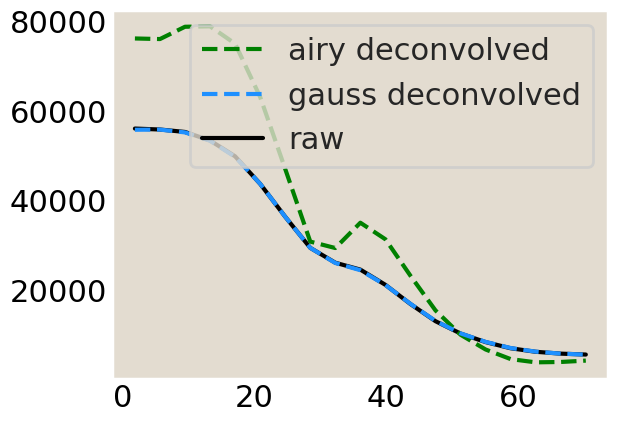

In [532]:
#radially average
xcent = 265
ycent = 255
zcent = int(len(deconvImsnov7)//2)

numum = len(motStacknov7)*umperpxZnov7
l = int(zcent - numum/(2*umperpxZnov7))
zh = int(zcent + numum/(2*umperpxZnov7))
xl = int(xcent - numum/(2*umperpxXYnov7))
xh = int(xcent + numum/(2*umperpxXYnov7))
yl = int(ycent - numum/(2*umperpxXYnov7))
yh = int(ycent + numum/(2*umperpxXYnov7))

plt.plot(*polarAverage(deconvNormAirynov7[zcent, yl:yh, xl:xh]), color='green', ls='--', label='airy deconvolved')
plt.plot(*polarAverage(deconvGaussnov7[zcent, yl:yh, xl:xh]), color='dodgerblue', ls='--',label='gauss deconvolved')
plt.plot(*polarAverage(motStacknov7[zcent, yl:yh, xl:xh]), color='k', label='raw', zorder=0)
plt.legend()

In [530]:
polarAverage(deconvNormAirynov7[zcent, yl:yh, xl:xh])

(array([ 1.89802347,  5.6940704 ,  9.49011733, 13.28616426, 17.08221119,
        20.87825812, 24.67430505, 28.47035198, 32.26639891, 36.06244584,
        39.85849277, 43.6545397 , 47.45058663, 51.24663356, 55.04268049,
        58.83872742, 62.63477435, 66.43082129, 70.22686822]),
 array([76116.984375  , 75984.0625    , 78733.03125   , 78825.9609375 ,
        74949.8671875 , 63043.5625    , 46957.578125  , 30733.04882812,
        29292.85351562, 34947.26953125, 31250.62695312, 23098.7890625 ,
        15349.5       ,  9919.59277344,  6623.18310547,  4477.1484375 ,
         3753.6796875 ,  3834.08496094,  4140.62402344]))

In [358]:
np.sum(psfGauss*umperpxXYnov7**2*umperpxZnov7)

np.float64(0.8192978279847021)

In [344]:
import datetime

In [350]:
print(datetime.datetime.now())
deconv3DGaussPsf = restoration.richardson_lucy(motStacknov7, psfGauss, num_iter=5, clip=False)


2025-08-02 16:18:12.395666


In [351]:
print(datetime.datetime.now())

2025-08-02 16:30:12.284199


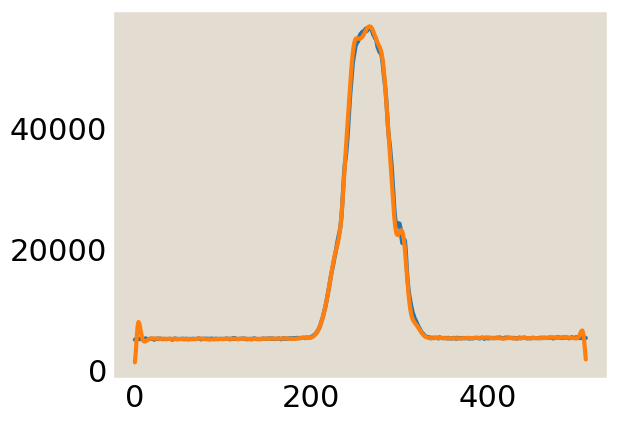

In [354]:
plt.plot(motStacknov7[60,256])
plt.plot(deconv3DGaussPsf[60,256])

In [355]:
print(datetime.datetime.now())
deconv3DGaussPsf = restoration.richardson_lucy(motStacknov7, psfGauss, num_iter=50, clip=False)
print(datetime.datetime.now())

2025-08-02 16:32:46.849645


KeyboardInterrupt: 

# import somthing for uneven illumination

In [391]:
def parse_ome(file, channel_list=['405', '480', 'Cherry']):
    """
    Extracts image arrays from an ome.tif file.
    
    Parameters:
    file (string): Data file path.
    channel_list (list of strings): Names of fluorescent channels taken in this dataset
    
    Returns:
    (list): List of images (as 3D numpy.ndarrays) for each fluorescent channel with shape (# images, m, n).
    """
    
    images = []
    # Open and read the OME-TIFF file
    with tifffile.TiffFile(file) as tif:

        for i, page in enumerate(tif.pages):
            image_data = page.asarray()
            images.append(image_data)

        # Access the OME metadata if needed
        ome_metadata = tif.ome_metadata

    ch1 = images[0::3]
    ch2 = images[1::3]
    ch3 = images[2::3]
    
    return [np.array(ch1), np.array(ch2), np.array(ch3)]

In [388]:
def backSubtract(arrs, dark_avg):
    """
    Subtracts camera dark noise from images
    
    Parameters:
    arrs (lsit): list of 3D numpy.ndarray's containing aster images where each array is from a different fluorescent channel.
    dark_avg (numpy.ndarray): 2D array image taken with the camera shutter closed of shape (m, n)
    
    Returns:
    (list): list of 3D numpy.ndarray's with dark camera noise subtracted.
    """
    return [arr-dark_avg for arr in arrs] # save processed images

In [389]:
def fit_bivariate_quadratic_anyShape(vals, coord):
    """
    Fits a bivariate quadratic polynomial to the intensity values of a grayscale image.
    
    Parameters:
    binary_im (numpy.ndarray): Grayscale image of shape (M, N).
    
    Returns:
    coefficients (numpy.ndarray): Coefficients of the fitted polynomial [a00, a10, a01, a20, a11, a02].
    """
    # Flatten the matrices for the least squares fitting
    I_flat = coord[0]
    J_flat = coord[1]
    Z_flat = vals

    # Create the design matrix for the polynomial terms
    A = np.vstack([I_flat**2, J_flat**2, I_flat*J_flat, I_flat, J_flat, np.ones_like(I_flat)]).T

    # Solve for the coefficients using least squares
    coefficients, _, _, _ = np.linalg.lstsq(A, Z_flat, rcond=None)

    return coefficients

def evaluateBivPoly_anyShape(vals,coord):
    """ Given coordinates, this function returns the best-fit bivariate polynomial for image. """
    coefficients=fit_bivariate_quadratic_anyShape(vals, coord);
    I, J = coord[0], coord[1]
    Z_fitted = (coefficients[0] * I**2 + coefficients[1] * J**2 +
            coefficients[2] * I * J + coefficients[3] * I +
            coefficients[4] * J + coefficients[5])
    return Z_fitted

In [390]:
def norm_unev(arrs_sub, mask_coords, allmask_coords):
    """
    Corrects uneven illumination by fitting an image to a bivariate polynomial, normalizing the polynomial, and dividing an array of images by this normalized matrix.
    
    Parameters:
    arrs_sub (list): Dark image subtracted list of image arrays.
    mask_coords (length 2 tuple): illumination mask coordinates (for one image)
    allmask_coords (slice): slice containing all the illumination coordinates with an extra dimension to account for all timepoints
    
    Returns:
    arr_ev (list): list of image arrays after the evening process.
    """
    #norm_mats = []
    arrs_ev = []
    
    for arr in arrs_sub:
        #compute the bivariate filter
        biv_filt = np.zeros_like(arr[0])
        biv_filt[mask_coords] = evaluateBivPoly_anyShape(arr[0, :, :][mask_coords], mask_coords)
        #norm_mats.append(norm_mat)
        
        #scale the normalization matrix such that the average value after multiplication is the same as the bs image
        scalar = np.mean(arr[0][mask_coords])/np.mean(arr[0][mask_coords]/biv_filt[mask_coords])
        norm_mat = scalar/biv_filt
        
        arrs_ev_temp = np.zeros_like(arr)
        arrs_ev_temp[allmask_coords]=arr[allmask_coords]*norm_mat[mask_coords]
        
        arrs_ev.append(arrs_ev_temp)
        
    return arrs_ev

In [393]:
# Place where the metadata file is found
metaDataFile='../../data/aster/20241114_footageComments_gnames.csv'
metaDF = pd.read_csv(metaDataFile)

# ## Includes
goodSubset=metaDF[metaDF['Note'].apply(lambda x: 'GOOD' in x)]#[np.isin(metaDF['Note'], "GOOD")]
gnameList=list('../../data/aster/'+goodSubset['child']+'/'+goodSubset['FILE']+'/'+goodSubset['Position'])

In [406]:
gnameList[0], gnameList[10], gnameList[5], gnameList[20], gnameList[30]

('../../data/aster/Ncd_Aster_assay_12-12-2023/20sInterval_0.2uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_3/20sInterval_0.2uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_3_MMStack_Pos0.ome.tif',
 '../../data/aster/Ncd_Aster_assay_12-12-2023/20sInterval_0.6uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_2/20sInterval_0.6uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_2_MMStack_Pos1.ome.tif',
 '../../data/aster/Ncd_Aster_assay_12-12-2023/20sInterval_0.3uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_2/20sInterval_0.3uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_2_MMStack_Pos2.ome.tif',
 '../../data/aster/Ncd_Aster_assay_12-07-2023/20sInterval_0.5uM_Ncd_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_1/20sInterval_0.5uM_Ncd_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_1_MMStack_Pos2.ome.tif',
 '../../data/aster/Ncd_Aster_assay_12-11-2023/20sInterval_0.75uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_1/20sInterval_0.75uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_1_MMStack_Pos0.ome.tif',
 '.

In [417]:
motzero = []
for i in tqdm([0, 5,10, 20, 30]):
    temp = parse_ome(gnameList[i])
    motzero.append(temp[2][0])
motzero=np.array(motzero)

  0%|          | 0/5 [00:00<?, ?it/s]

In [495]:
motzero_bs = motzero-1920
biv_filt = np.zeros_like(motzero_bs)
norm_mats = []
for i, im in enumerate(motzero_bs):
    coords=np.where(motzero_bs[i]!=np.inf) #get all the coordinates of the image
    biv_filt[i][coords] = evaluateBivPoly_anyShape(im[coords], coords)
    scalar = np.mean(im)/np.mean(im/biv_filt[i])
    norm_mats.append(np.array(scalar/biv_filt[i]))
norm_mats=np.array(norm_mats)

In [497]:
norm_mats.min(), norm_mats.max()

(np.float64(0.732925638171863), np.float64(3.761269207508608))

../../data/aster/Ncd_Aster_assay_12-12-2023/20sInterval_0.2uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_3/20sInterval_0.2uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_3_MMStack_Pos0.ome.tif
../../data/aster/Ncd_Aster_assay_12-12-2023/20sInterval_0.3uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_2/20sInterval_0.3uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_2_MMStack_Pos2.ome.tif
../../data/aster/Ncd_Aster_assay_12-12-2023/20sInterval_0.6uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_2/20sInterval_0.6uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_2_MMStack_Pos1.ome.tif
../../data/aster/Ncd_Aster_assay_12-07-2023/20sInterval_0.5uM_Ncd_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_1/20sInterval_0.5uM_Ncd_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_1_MMStack_Pos2.ome.tif
../../data/aster/Ncd_Aster_assay_12-11-2023/20sInterval_0.75uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_1/20sInterval_0.75uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_1_MMStack_Pos0.ome.tif


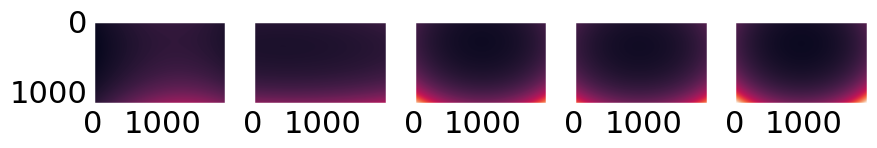

In [515]:
for i in [0, 5, 10, 20, 30]:
    print(gnameList[i])
fig, ax = plt.subplots(1,len(norm_mats), figsize = (10, 25), sharex=True, sharey=True)
for i, im in enumerate(norm_mats):
    ax[i].imshow(im, vmin = 0.7, vmax=3)

../../data/aster/Ncd_Aster_assay_12-12-2023/20sInterval_0.2uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_3/20sInterval_0.2uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_3_MMStack_Pos0.ome.tif
../../data/aster/Ncd_Aster_assay_12-12-2023/20sInterval_0.3uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_2/20sInterval_0.3uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_2_MMStack_Pos2.ome.tif
../../data/aster/Ncd_Aster_assay_12-12-2023/20sInterval_0.6uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_2/20sInterval_0.6uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_2_MMStack_Pos1.ome.tif
../../data/aster/Ncd_Aster_assay_12-07-2023/20sInterval_0.5uM_Ncd_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_1/20sInterval_0.5uM_Ncd_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_1_MMStack_Pos2.ome.tif
../../data/aster/Ncd_Aster_assay_12-11-2023/20sInterval_0.75uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_1/20sInterval_0.75uM_NCD_dimers_500uMATP_1.3uM_tubulin_2.8uM_A81D_1_MMStack_Pos0.ome.tif


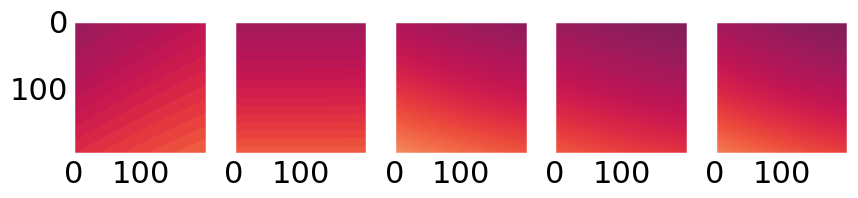

In [574]:
for i in [0, 5, 10, 20, 30]:
    print(gnameList[i])
fig, ax = plt.subplots(1,len(norm_mats), figsize = (10, 25), sharex=True, sharey=True)
for i, im in enumerate(norm_mats):
    ax[i].imshow(im[960-100:960+100, 600-100:600+100], vmin = 0.7, vmax=1.5)

In [448]:
y, x = np.indices(motzero_bs[0].shape)         # y: row indices, x: column indices
coords = np.stack((y, x), axis=-1) 
coords_flat = coords.reshape(-1, 2)

In [455]:
motzero_bs[0][np.where(motzero_bs[0]!=np.inf)]

array([16, 16, 16, ..., 16, 32, 48], shape=(2304000,), dtype=uint16)

In [450]:
motzero_bs[0][coords]

IndexError: index 1200 is out of bounds for axis 0 with size 1200

# Synthetic Data

In [59]:
def gaussPSF_tot(dx, dy, dz, sigmaTr, sigmaAx):
  return np.exp(-(dx**2+dy**2)/(2*sigmaTr**2))*np.exp(-(dz**2)/(2*sigmaAx**2)) / (np.sqrt((2*np.pi*sigmaTr**2)**2) * np.sqrt((2*np.pi*sigmaAx**2)**1))

def gaussPSF_axial(dz, sigmaAx):
  return np.exp(-(dz**2)/(2*sigmaAx**2)) / (np.sqrt((2*np.pi*sigmaAx**2)**1))

def gaussPSF_transverse(dx, dy, sigmaTr):
  return np.exp(-(dx**2+dy**2)/(2*sigmaTr**2)) / (np.sqrt((2*np.pi*sigmaTr**2)**2))



In [62]:
#### Verify that fftconv magic increasingly resembles real object
zmin=-50
zmax=50
xmin=-50
xmax=50
ymin=-50
ymax=50
numz=201
numx=171
numy=171

xvals = np.linspace(xmin, xmax, numx)
yvals = np.linspace(ymin, ymax, numy)
zvals = np.linspace(zmin, zmax, numz)

lambdaObj=30;
sigmaTr=0.65;
sigmaAx=2.5; #mu m fixed

realObj = np.zeros((numx, numy, numz))

# make psf
psf = np.zeros((numx, numy, numz))
for ii in tqdm(range(len(xvals))):
  for j in range(len(yvals)):
    for k in range(len(zvals)):
      psf[ii, j, k]= gaussPSF_tot(xvals[ii], yvals[j], zvals[k], sigmaTr, sigmaAx)

psf=psf/psf.sum()

#convedObjs=np.zeros((numx, numy, numz)); # this will store the convolutions

#realObjList=[];
for ii in tqdm(range(len(xvals))):
    for j in range(len(yvals)):
      for k in range(len(zvals)):
        realObj[ii, j, k]= np.exp(-np.sqrt(xvals[ii]**2+yvals[j]**2+zvals[k]**2)/lambdaObj)

fftconv3D =  scipy.signal.convolve(realObj, psf, mode='same')

  0%|          | 0/171 [00:00<?, ?it/s]

  0%|          | 0/171 [00:00<?, ?it/s]

View the convolved center plane vs the raw center plane

(np.float64(-0.5), np.float64(170.5), np.float64(170.5), np.float64(-0.5))

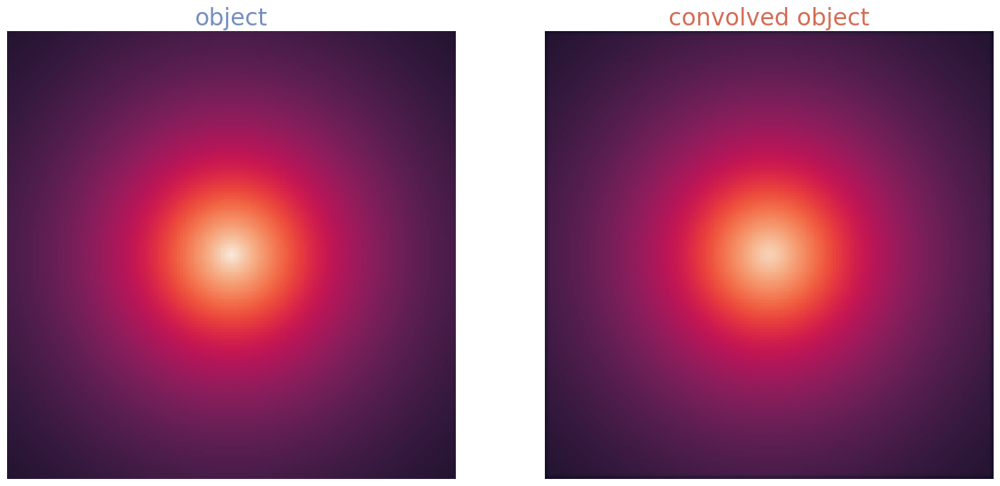

In [63]:
fig,ax = plt.subplots(1,2, figsize=(18,9))
ax[0].imshow(realObj[:,:,len(zvals)//2], vmin=0, vmax=1)
ax[1].imshow(fftconv3D[:,:,len(zvals)//2], vmin=0, vmax=1)
ax[0].set_title("object", color=pboc_colors['blue'])
ax[1].set_title("convolved object", color=pboc_colors['red'])
ax[0].axis('off')
ax[1].axis('off')

 plot the strip fixed in x, y, and varying in z

Text(0.5, 1.0, 'line in z')

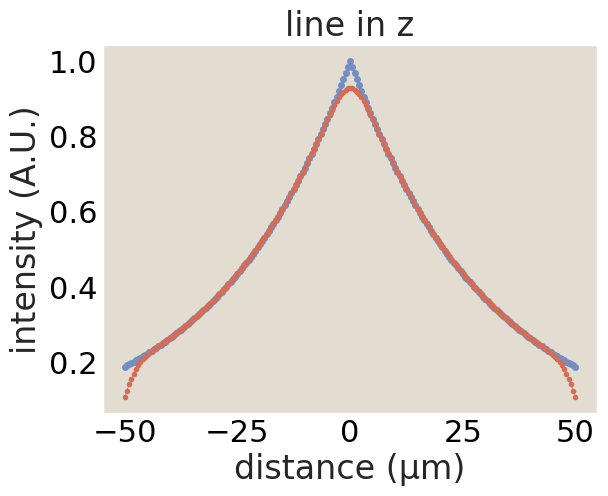

In [64]:
plt.plot(zvals, realObj[len(xvals)//2,len(yvals)//2, :], 'o-', ms=4, lw=0.5, color=pboc_colors['blue'])
plt.plot(zvals, fftconv3D[len(xvals)//2, len(yvals)//2, :], 'o-', ms=3, lw=0.5,color=pboc_colors['red'])
plt.xlabel('distance (µm)')
plt.ylabel('intensity (A.U.)')
plt.title('line in z')

plot the strip fixed at x and z but varying in y

Text(0.5, 1.0, 'line in y')

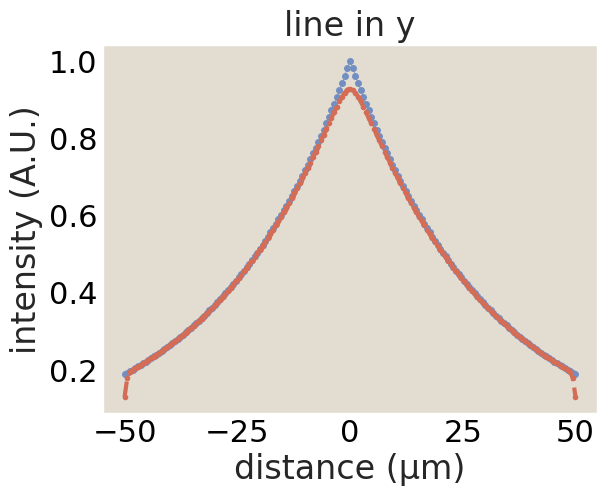

In [65]:
plt.plot(yvals, realObj[len(xvals)//2,:, len(zvals)//2], 'o-', ms=4,  lw=0.5, color=pboc_colors['blue'])
plt.plot(yvals, fftconv3D[len(xvals)//2, :, len(zvals)//2], 'o--', ms=3, color=pboc_colors['red'])
plt.xlabel('distance (µm)')
plt.ylabel('intensity (A.U.)')
plt.title('line in y')

Look at the variation (real-conv)/real --> for the variation in y

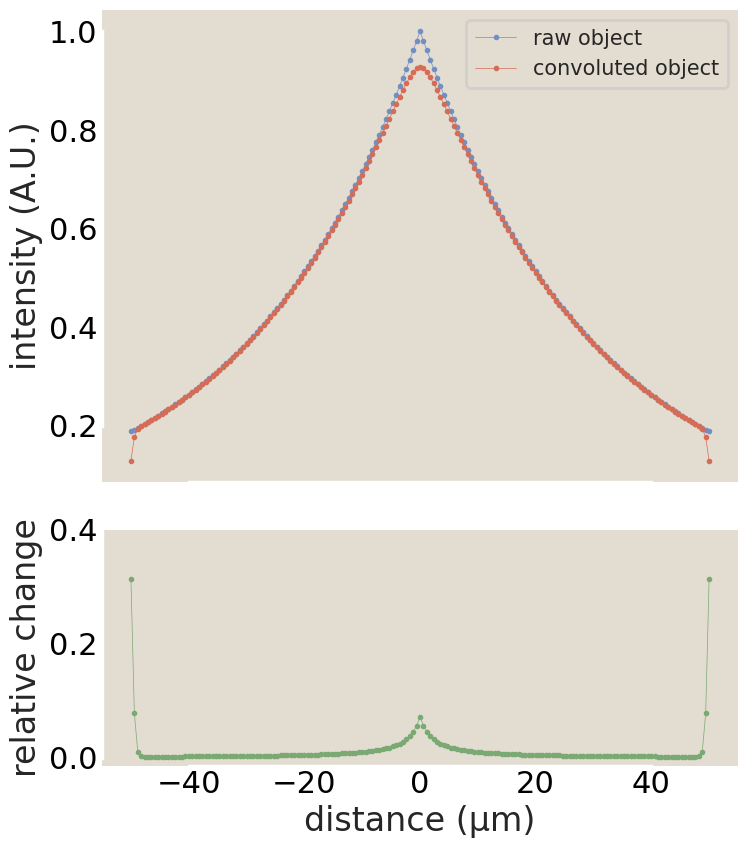

In [66]:
fig, ax = plt.subplots(2, figsize=(8,9), sharex=True, gridspec_kw={'height_ratios': [2, 1]})

ax[0].plot(yvals, realObj[len(xvals)//2,:, len(zvals)//2], 'o-', ms=3,  lw=0.5, color=pboc_colors['blue'], label='raw object')
ax[0].plot(yvals, fftconv3D[len(xvals)//2, :, len(zvals)//2], 'o-', ms=3, lw=0.5, color=pboc_colors['red'], label='convoluted object')
ax[0].set_ylabel('intensity (A.U.)')
ax[0].legend(fontsize=15)


ax[1].plot(yvals, (realObj[len(xvals)//2,:,len(zvals)//2] - fftconv3D[len(xvals)//2,:,len(zvals)//2])/realObj[len(xvals)//2,:,len(zvals)//2],
         'o-', ms=3, lw=0.5, color=pboc_colors['green'])
ax[1].set_yticks([0, 0.2, 0.4])
ax[1].set_ylabel('relative change')
ax[1].set_xlabel('distance (µm)')

sns.despine(trim=True)
plt.tight_layout()
#plt.savefig('20250715_synthTraces.pdf', transparent=True)

## Do derivatives go both ways - just use 2D fig

In [67]:
## 2D transverse (lateral) PSF
# make psfTr again
psfTr = np.zeros((numx, numy))
for ii in tqdm(range(len(xvals))):
  for j in range(len(yvals)):
    psfTr[ii,j]= gaussPSF_transverse(xvals[ii],yvals[j],sigmaTr)
psfTr=psfTr/psfTr.sum()


  0%|          | 0/171 [00:00<?, ?it/s]

take the derivative of the object then convolve

In [68]:
#raw object 2D slice
twoDslice=realObj[:,:,numz//2];
#derivative of object in x
dervx = np.gradient(twoDslice, axis=0)
#convolve the derivative
dervxThenConv = scipy.signal.convolve(dervx, psfTr, mode='same')
#convolve the 2D object
conv2D=scipy.signal.convolve(twoDslice, psfTr, mode='same')
#take the derivative of the convolved object
conv2DThenDervx = np.gradient(conv2D, axis=0)

Text(0.5, 1.0, 'difference')

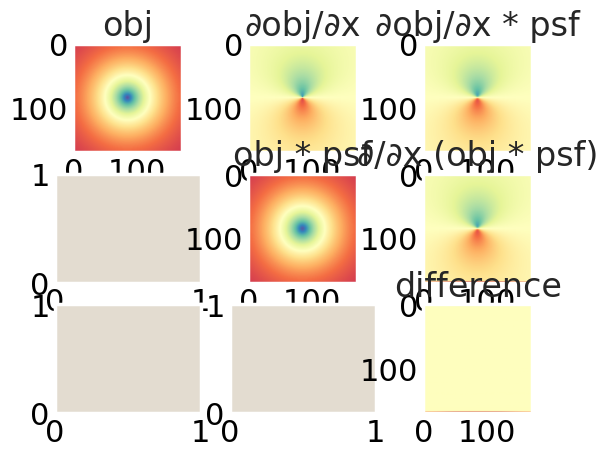

In [69]:
fig,ax = plt.subplots(3, 3)

ax[0,0].imshow(twoDslice, cmap='Spectral', vmin=0, vmax=1);
ax[0,0].set_title('obj')

ax[0,1].imshow(dervx, cmap='Spectral', vmin=-0.025, vmax = 0.025);
ax[0,1].set_title('∂obj/∂x')

ax[0,2].imshow(dervxThenConv, cmap='Spectral', vmin=-0.025, vmax = 0.025);
ax[0,2].set_title('∂obj/∂x * psf')

ax[1,1].imshow(conv2D, cmap='Spectral', vmin=0, vmax=1)
ax[1,1].set_title('obj * psf')

ax[1,2].imshow(conv2DThenDervx, cmap='Spectral', vmin=-0.025, vmax = 0.025);
ax[1,2].set_title('∂/∂x (obj * psf)')

ax[2,2].imshow(conv2DThenDervx-dervxThenConv, cmap='Spectral', vmin=-0.025, vmax=0.025)
ax[2,2].set_title('difference')

Text(0.5, 1.0, 'convolved')

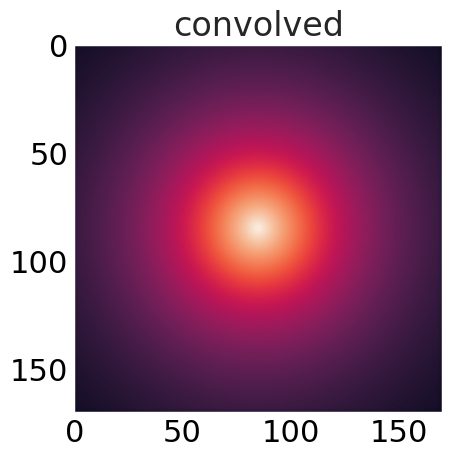

In [70]:
### Ultimate result: convolution result
convolved=scipy.signal.convolve(twoDslice, psfTr, mode='same')
plt.imshow(convolved)
plt.title('convolved')

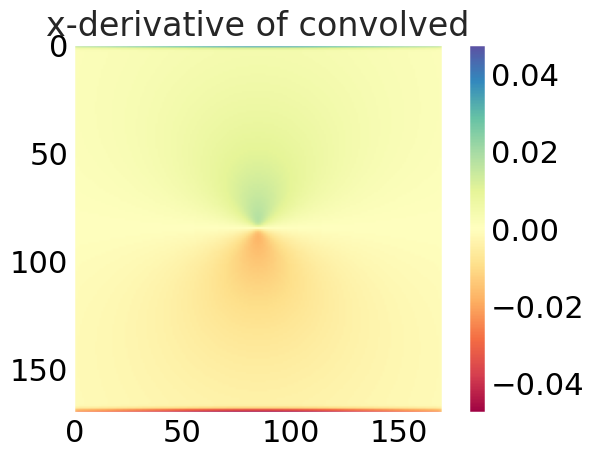

In [71]:
### Ultimate result: convolution result
plt.imshow(np.gradient(convolved, axis=0), cmap='Spectral')
plt.title('x-derivative of convolved')
plt.colorbar()

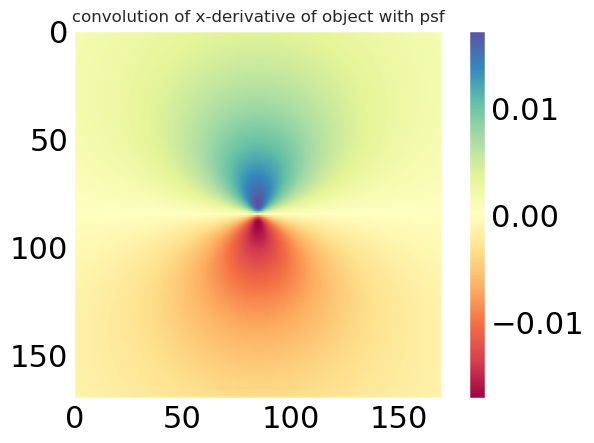

In [72]:
### Convolution of x-derivative of object with PSF
xDerivObjConvWithPSF=scipy.signal.convolve(np.gradient(twoDslice, axis=0), psfTr, mode='same')
plt.imshow(xDerivObjConvWithPSF, cmap='Spectral')
plt.title('convolution of x-derivative of object with psf', fontsize=12)
plt.colorbar()

(np.float64(-0.5), np.float64(170.5), np.float64(170.5), np.float64(-0.5))

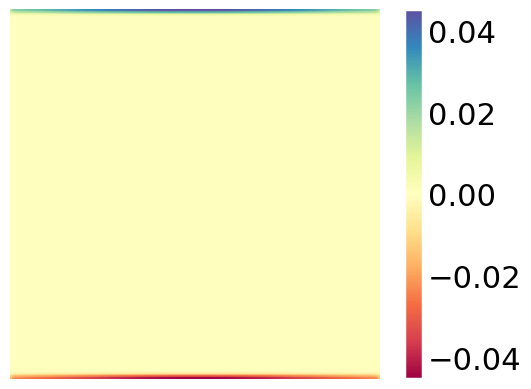

In [73]:
plt.imshow((np.gradient(convolved, axis=0) - xDerivObjConvWithPSF), cmap='Spectral')
plt.colorbar()
plt.axis('off')

Convolve first and then take the derivative

Text(0.5, 1.0, '∂obj/∂y * psf')

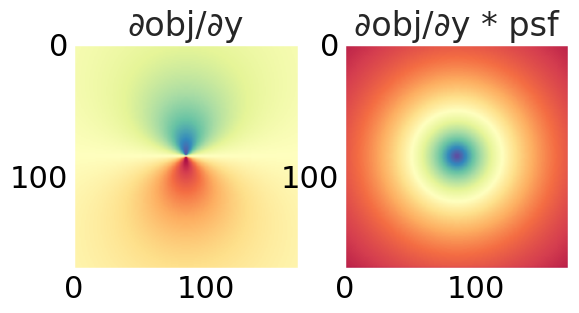

In [74]:
## Derivative of OBJECT
twoDslice=realObj[:,:,numz//2];

#convolve the derivative
convDeriv=scipy.signal.convolve(twoDslice, psfTr, mode='same')

fig,ax = plt.subplots(1, 2)
ax[0].imshow(np.gradient(twoDslice, axis=0), cmap='Spectral');
#plt.colorbar()
ax[0].set_title('∂obj/∂y')

ax[1].imshow(convDeriv, cmap='Spectral')

ax[1].set_title('∂obj/∂y * psf')

## Modulate sigma

In [75]:
#### Verify that fftconv magic increasingly resembles real object
zmin=-50
zmax=50
xmin=-50
xmax=50
ymin=-50
ymax=50
numz=201
numx=171
numy=171

xvals = np.linspace(xmin, xmax, numx)
yvals = np.linspace(ymin, ymax, numy)
zvals = np.linspace(zmin, zmax, numz)

lambdaObj=30;
sigmaTr=0.65;
sigmaAx=2.5; #mu m fixed

#sigmas = [[20, 20], [10,10], [5,5], [3,3], [sigmaTr, sigmaAx], [1,1], [0.5,0.5], [0.1,0.1]]
sigmas = [[10,10], [5,5], [3,3], [sigmaTr, sigmaAx], [1,1], [0.25, 1.7], [0.25,0.25]]

# make psf
psf_varSig = np.zeros((len(sigmas), numx, numy, numz))
for s, sig in enumerate(tqdm(sigmas)):
    #psf = np.zeros((numx, numy, numz))
    for ii in range(len(xvals)):
      for j in range(len(yvals)):
        for k in range(len(zvals)):
          psf_varSig[s, ii, j, k]= gaussPSF_tot(xvals[ii], yvals[j], zvals[k], sig[0], sig[1])
    psf_varSig[s] = psf_varSig[s]/psf_varSig[s].sum()

#convedObjs=np.zeros((numx, numy, numz)); # this will store the convolutions

realObj = np.zeros((numx, numy, numz))
for ii in tqdm(range(len(xvals))):
    for j in range(len(yvals)):
      for k in range(len(zvals)):
        realObj[ii, j, k]= np.exp(-np.sqrt(xvals[ii]**2+yvals[j]**2+zvals[k]**2)/lambdaObj)

#fftconv3D =  scipy.signal.convolve(realObj, psf, mode='same')

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/171 [00:00<?, ?it/s]

In [76]:
fftconv3D_varSig=[]
for p, psfsig in enumerate(tqdm(psf_varSig)):
    fftconv3D_varSig.append(scipy.signal.convolve(realObj, psfsig, mode='same'))
fftconv3D_varSig = np.array(fftconv3D_varSig)

  0%|          | 0/7 [00:00<?, ?it/s]

In [77]:
sigmas

[[10, 10], [5, 5], [3, 3], [0.65, 2.5], [1, 1], [0.25, 1.7], [0.25, 0.25]]

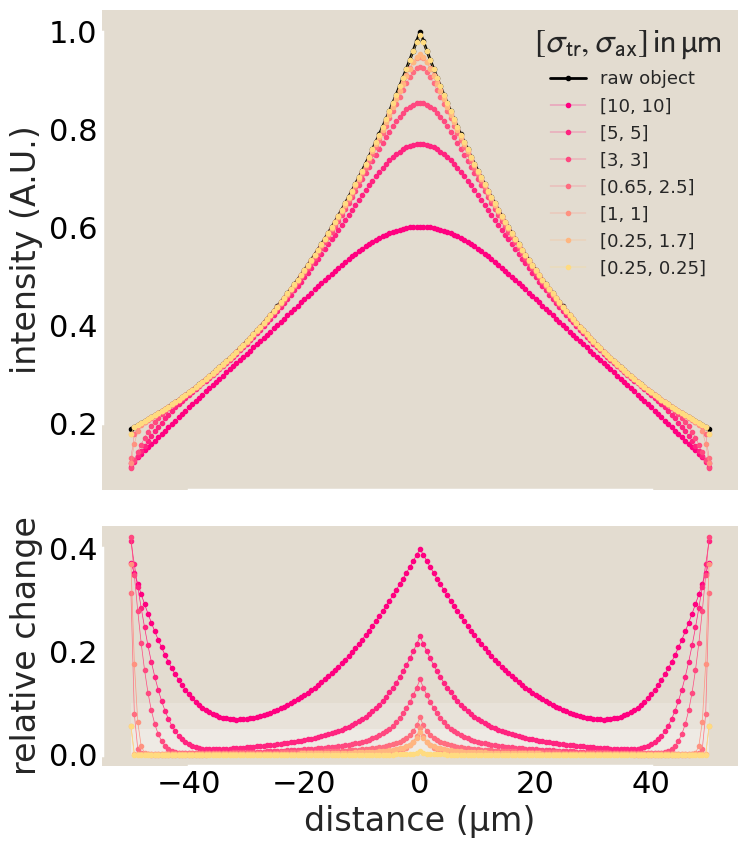

In [151]:
fig, ax = plt.subplots(2, figsize=(8,9), sharex=True, gridspec_kw={'height_ratios': [2, 1]})

ax[0].plot(yvals, realObj[len(xvals)//2,:, len(zvals)//2], 'o-', ms=3,  lw=2, color='k', label='raw object')

for c, conv, in enumerate(fftconv3D_varSig):
    ax[0].plot(yvals, conv[len(xvals)//2, :, len(zvals)//2], 'o-', ms=3, lw=0.3, color=(1, c/len(sigmas), 0.5), label=str(sigmas[c]))

    ax[1].plot(yvals, (realObj[len(xvals)//2,:,len(zvals)//2] - conv[len(xvals)//2,:,len(zvals)//2])/realObj[len(xvals)//2,:,len(zvals)//2],
         'o-', ms=3, lw=0.5, color=(1, c/len(sigmas), 0.5))
    
ax[0].set_ylabel('intensity (A.U.)')
ax[0].legend(fontsize=13, frameon=False, title=rf'$[\sigma_\text{{tr}}, \sigma_\text{{ax}}] \,\mathrm{{in \, \mu m}}$')

ax[1].set_yticks([0, 0.2, 0.4])
ax[1].set_ylabel('relative change')
ax[1].set_xlabel('distance (µm)')

ax[1].fill_between(yvals, 0.1, alpha=0.2, zorder=0, lw=0, color='w')
ax[1].fill_between(yvals, 0.05, alpha=0.3, zorder=0,  lw=0, color='w')

sns.despine(trim=True)
plt.tight_layout()
#plt.savefig('../../analyzed_data/aster/zstacks/20250727_synthTraces.pdf', bbox_inches='tight')


# mimic Calibration image with noise

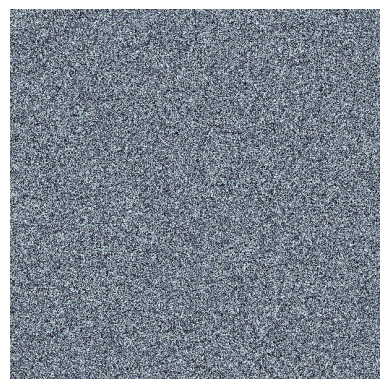

In [164]:
testImgCalib=np.random.uniform(low=100, high=10000, size=(512,512))
plt.imshow(testImgCalib, cmap='bone_r')
plt.gca().axis('off')
plt.savefig('calib20250731.tif', bbox_inches='tight') 

In [161]:
import imageio
imageio.imwrite('calib20250731.tif', testImgCalib)

In [166]:
!pwd

/home/aduarte/am_atp/analysis/aster


In [168]:
testImgCalibRL = skimage.io.imread('../../data/aster/zstacks/2022-Nov-07_YFP-Ncd_R1_Zstack_1/calib20250730_RL1000.tif')

testImgCalib31 = skimage.io.imread('../../data/aster/zstacks/2022-Nov-07_YFP-Ncd_R1_Zstack_1/calib20250731.tif')
testImgCalibRL31 = skimage.io.imread('../../data/aster/zstacks/2022-Nov-07_YFP-Ncd_R1_Zstack_1/calib20250731RL1000.tif')



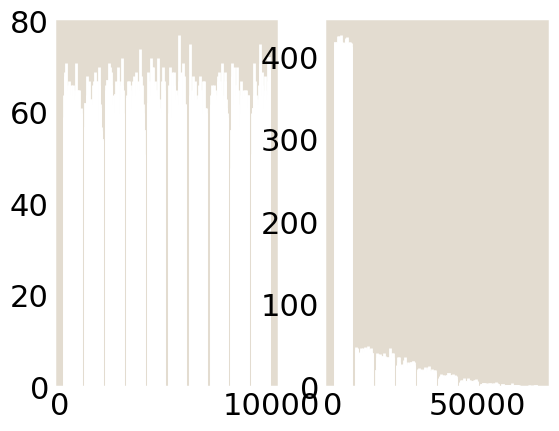

In [170]:
fig, ax = plt.subplots(1,2)
ax[0].hist(testImgCalib31);
ax[1].hist(testImgCalibRL31);

In [171]:
np.mean(testImgCalib31), np.mean(testImgCalibRL31)

(np.float32(5043.1816), np.float32(5043.18))

In [173]:
np.std(testImgCalib31), np.std(testImgCalibRL31)

(np.float32(2857.0356), np.float32(10472.047))

(array([[49., 45., 63., ..., 54., 39., 51.],
        [64., 55., 51., ..., 47., 51., 49.],
        [50., 65., 52., ..., 43., 62., 56.],
        ...,
        [48., 41., 58., ..., 50., 57., 59.],
        [56., 47., 47., ..., 46., 53., 52.],
        [49., 47., 48., ..., 61., 52., 47.]], shape=(512, 10)),
 array([5000.00155348, 5060.00117766, 5120.00080185, 5180.00042603,
        5240.00005021, 5299.99967439, 5359.99929858, 5419.99892276,
        5479.99854694, 5539.99817112, 5599.99779531]),
 <a list of 512 BarContainer objects>)

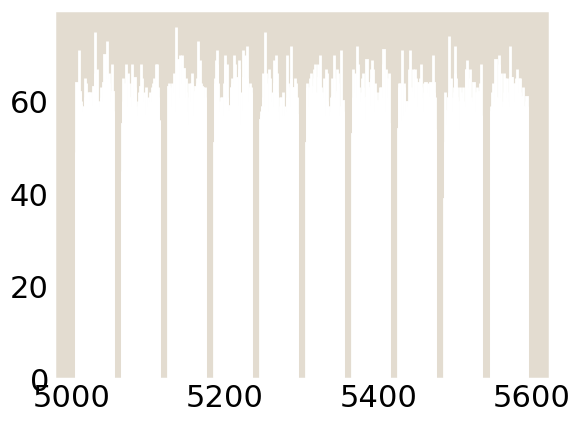

In [152]:

plt.hist(testImgCalib)

(array([[ 13.,  62., 122., ...,   5.,   1.,   0.],
        [ 14.,  72., 130., ...,   6.,   1.,   0.],
        [ 12.,  75., 139., ...,   1.,   1.,   0.],
        ...,
        [ 11.,  71., 134., ...,   2.,   0.,   0.],
        [  6.,  80., 128., ...,   4.,   0.,   0.],
        [ 17.,  63., 129., ...,   1.,   0.,   0.]], shape=(512, 10)),
 array([  259.94400024,  1755.2010498 ,  3250.45825195,  4745.71533203,
         6240.97216797,  7736.22900391,  9231.48730469, 10726.74414062,
        12222.00097656, 13717.2578125 , 15212.515625  ]),
 <a list of 512 BarContainer objects>)

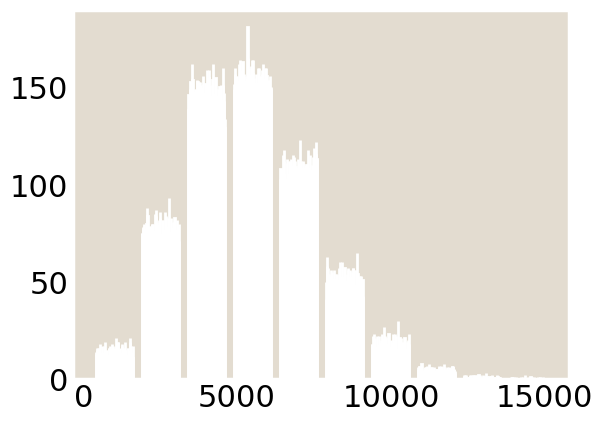

In [154]:
plt.hist(testImgCalibRL)

In [155]:
np.mean(testImgCalib), np.mean(testImgCalibRL)

(np.float64(5299.763089144276), np.float32(5300.4243))

In [115]:
import imageio
imageio.imwrite('calib20250730.tif', testImgCalib)

# starting the process over with bg sub and all

imports

In [721]:
def parse_ome_zstack(file, channel_list=['motor', 'MT']):
    """
    Extracts image arrays from an ome.tif file.
    
    Parameters:
    file (string): Data file path.
    channel_list (list of strings): Names of fluorescent channels taken in this dataset
    
    Returns:
    (list): List of images (as 3D numpy.ndarrays) for each fluorescent channel with shape (# images, m, n).
    """
    
    images = []
    # Open and read the OME-TIFF file
    with tifffile.TiffFile(file) as tif:

        for i, page in enumerate(tif.pages):
            image_data = page.asarray()
            images.append(image_data)

        # Access the OME metadata if needed
        ome_metadata = tif.ome_metadata

    print(len(images))
    
    # ch1 = images[0::2]
    # ch2 = images[1::2]
    #because this zstack (nov7 zstack aster raw ome.tif) was rude and arranged itself with consecutive channels rather than alternating channels
    ch1 = images[0:161]
    ch2 = images[161:322]
    
    return [np.array(ch1), np.array(ch2)]

In [722]:
#import the image stack

In [723]:
nov7Zstack=parse_ome_zstack('../../data/aster/zstacks/2022-Nov-07_YFP-Ncd_R1_Zstack_2/2022-Nov-07_YFP-Ncd_R1_Zstack_2_MMStack_Pos0.ome.tif')[0]
nov7Zstack_bs = nov7Zstack-1920

322


save bg subtracted image stack

In [724]:
 imageio.mimwrite('20250804Nov7Motorsbs_.tif', nov7Zstack_bs)

In [600]:
nov7Zstack_bs.shape

(161, 1200, 1920)

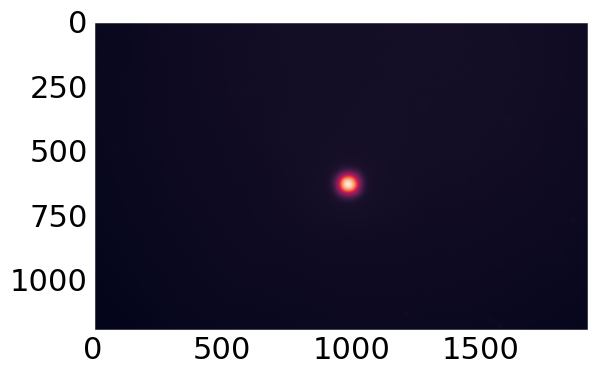

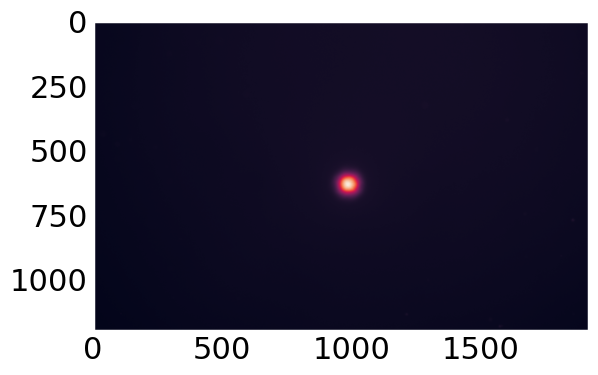

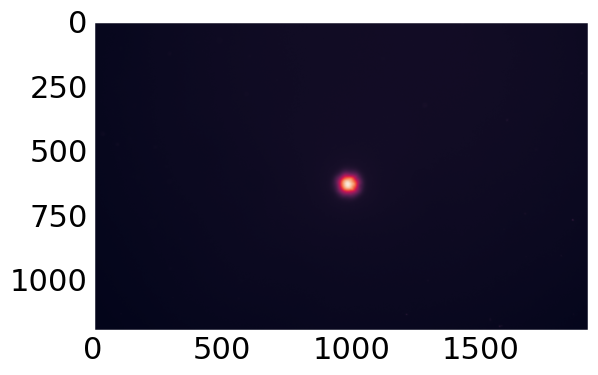

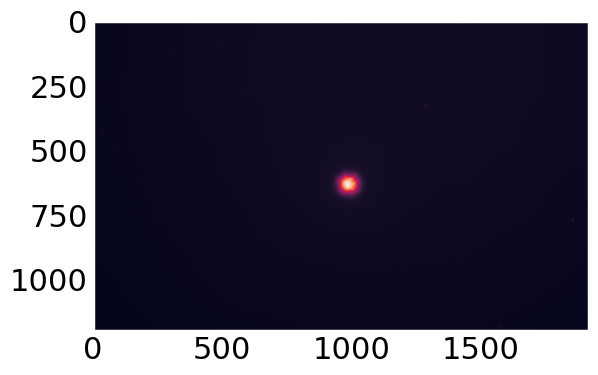

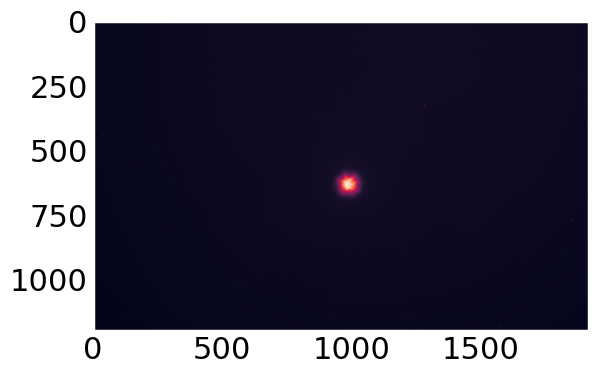

...

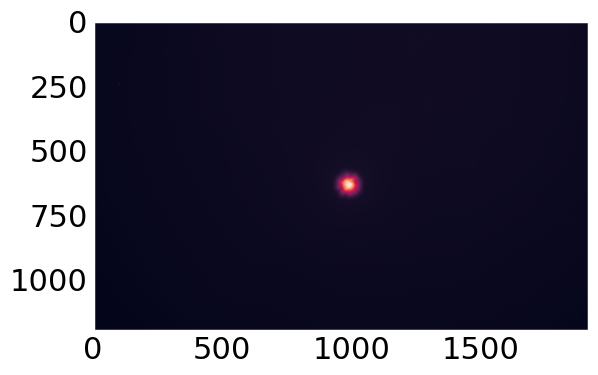

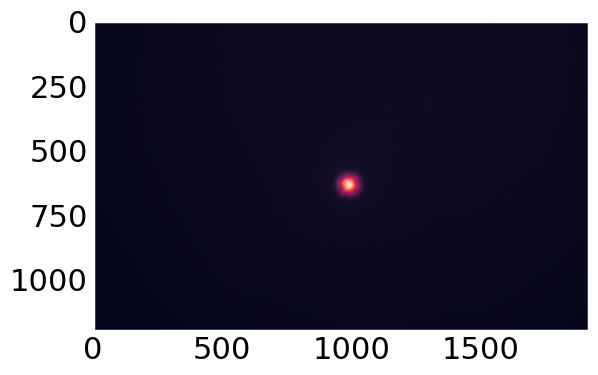

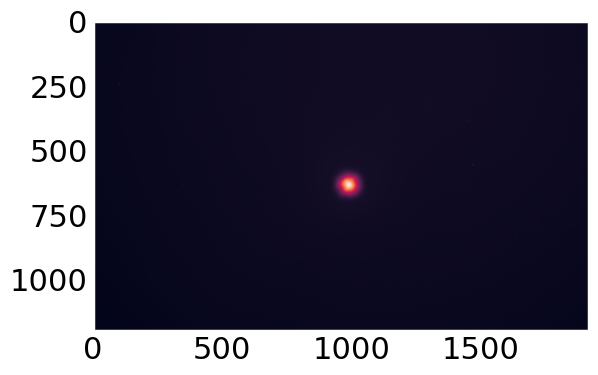

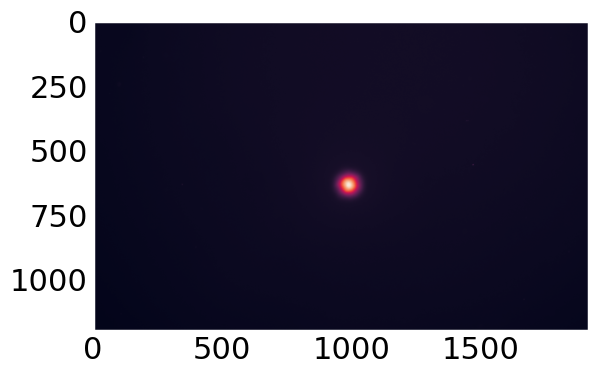

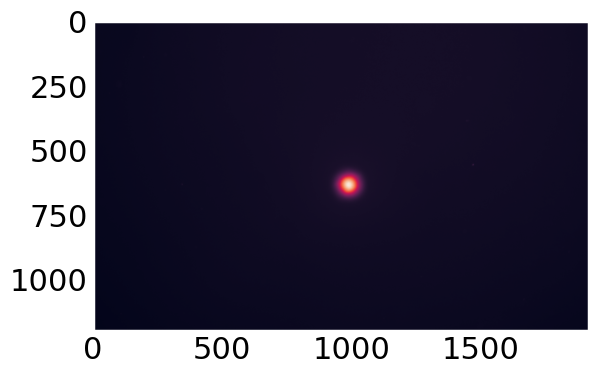

In [622]:
for f in range(0, 160, 10):
    fig, ax = plt.subplots()
    plt.imshow(nov7Zstack_bs[f])

In [ ]:
imageio.imwrite('20250804Nov7MotorsbsSlice80.tif', nov7Zstack_bs[80])

In [598]:
imageio.imwrite('20250804Nov7MotorsbsSlice80.tif', nov7Zstack_bs[80])

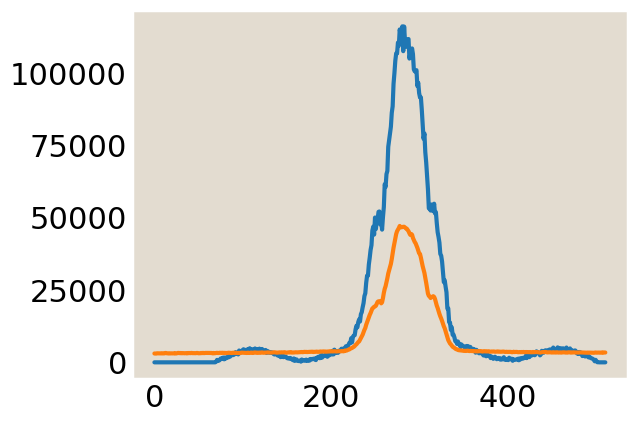

In [632]:
temp = skimage.io.imread('../../data/aster/zstacks/Decovolution/Nov7_2022/ADbgsubplus/20250804Nov7MotorRL1000Slice80crop.tif')
temptemp = skimage.io.imread('../../data/aster/zstacks/Decovolution/Nov7_2022/ADbgsubplus/20250804Nov7Motorsbs_crop512.tif')

plt.plot(temp[300,:])
plt.plot(temptemp[300,:])

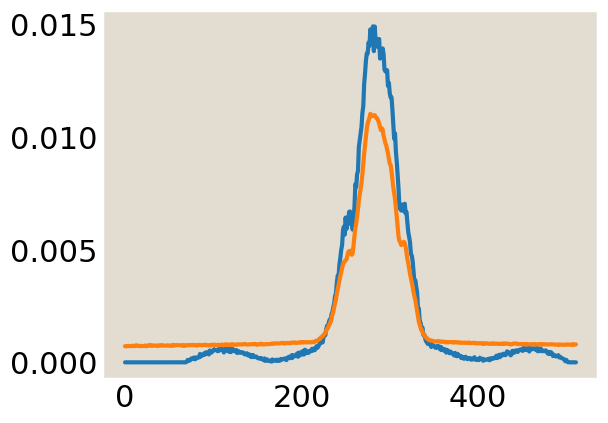

In [633]:
# approximate normalized 
plt.plot(temp[300,:]/np.sum(temp[300,:]))
plt.plot(temptemp[300,:]/np.sum(temptemp[300,:]))

In [677]:
# read in tif stacks from nov 7
fpathnov7 = '../../data/aster/zstacks/Decovolution/Nov7_2022/'
psfairynov7cropz = tifffile.imread(fpathnov7+'ADbgsubplus/20250804PSFBWnov7dimCrop.tif')
psfairynov7xy = tifffile.imread(fpathnov7+'ADbgsubplus/20250804PSFBWnov7dimSlice80.tif')
psfairynov7full = tifffile.imread(fpathnov7+'ADbgsubplus/20250804PSFBWnov7dim.tif')

Text(0, 0.5, 'Norm I')

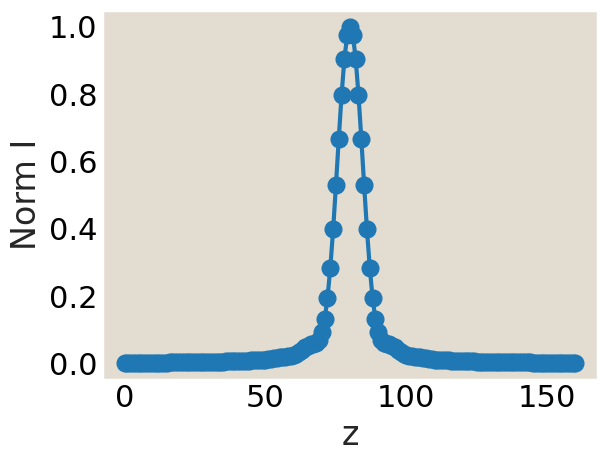

In [678]:
plt.plot(psfairynov7full[:, len(psfairynov7full[0])//2, len(psfairynov7full[0][0])//2], 'o-')

plt.xlabel('z')
plt.ylabel('Norm I')

Text(0, 0.5, 'Norm I')

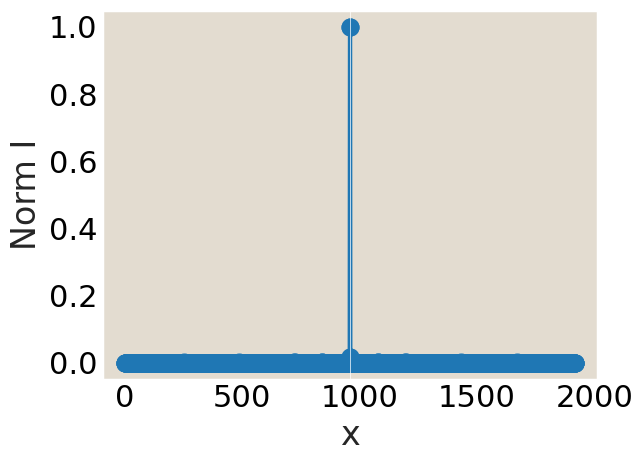

In [682]:
plt.plot(psfairynov7full[len(psfairynov7full)//2, psfairynov7full.shape[1]//2, :], 'o-')
plt.axvline(960, color='w', lw=0.5)
#plt.xlim(900, 1000)

plt.xlabel('x')
plt.ylabel('Norm I')

Text(0, 0.5, 'Norm I')

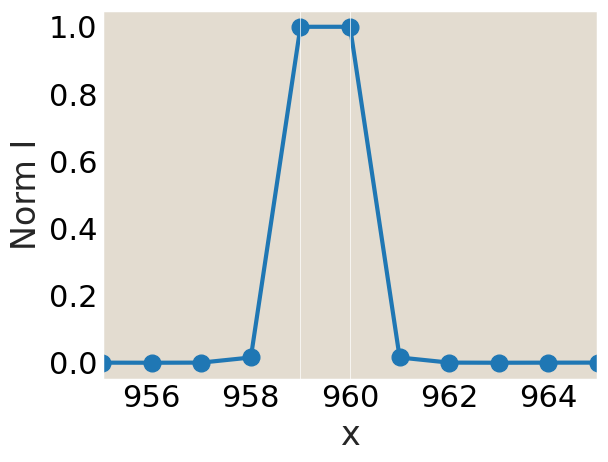

In [685]:
plt.plot(psfairynov7full[len(psfairynov7full)//2, psfairynov7full.shape[1]//2, :], 'o-')
plt.axvline(960, color='w', lw=0.5)
plt.axvline(959, color='w', lw=0.5)

plt.xlim(955, 965)

plt.xlabel('x')
plt.ylabel('Norm I')

Text(0, 0.5, 'Norm I')

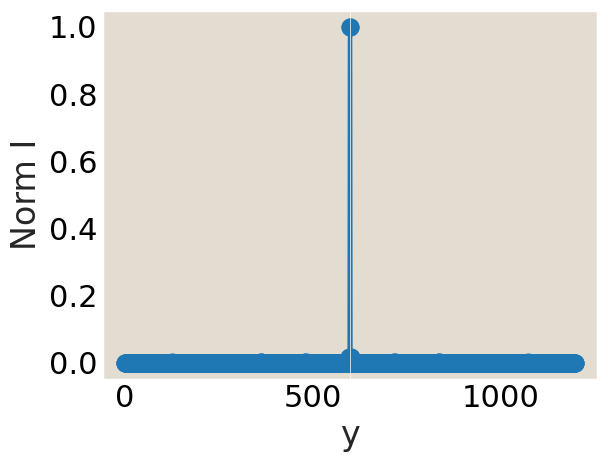

In [687]:
plt.plot(psfairynov7full[psfairynov7full.shape[0]//2, :, psfairynov7full.shape[2]//2], 'o-')
plt.axvline(600, color='w', lw=0.5)
plt.xlabel('y')
plt.ylabel('Norm I')

fit the psf widths

In [543]:
def airyGauss(u, I0, sig):
    return I0*np.exp(-u**2/(2*sig**2))

In [689]:
imxaxnov7 = psfairynov7full.shape[2]
xaxumnov7 = np.linspace(imxaxnov7//2*-1+0.5, imxaxnov7//2-0.5, imxaxnov7)*umperpxXYnov7

imyaxnov7 = psfairynov7full.shape[1]
yaxumnov7 = np.linspace(imyaxnov7//2*-1+0.5, imyaxnov7//2-0.5, imyaxnov7)*umperpxXYnov7

imzaxnov7 = psfairynov7full.shape[0]
zaxumnov7 = np.linspace(imzaxnov7//2*-1, imzaxnov7//2, imzaxnov7)*umperpxZnov7

xGaussFitnov7airy = scipy.optimize.curve_fit(airyGauss, xaxumnov7, psfairynov7full[psfairynov7full.shape[0]//2, psfairynov7full.shape[1]//2, :], [1, 2] )
yGaussFitnov7airy = scipy.optimize.curve_fit(airyGauss, yaxumnov7, psfairynov7full[psfairynov7full.shape[0]//2, :, psfairynov7full.shape[2]//2], [1, 2] )
zGaussFitnov7airy = scipy.optimize.curve_fit(airyGauss, zaxumnov7,psfairynov7full[:, psfairynov7full.shape[1]//2, psfairynov7full.shape[2]//2], [1, 2] )


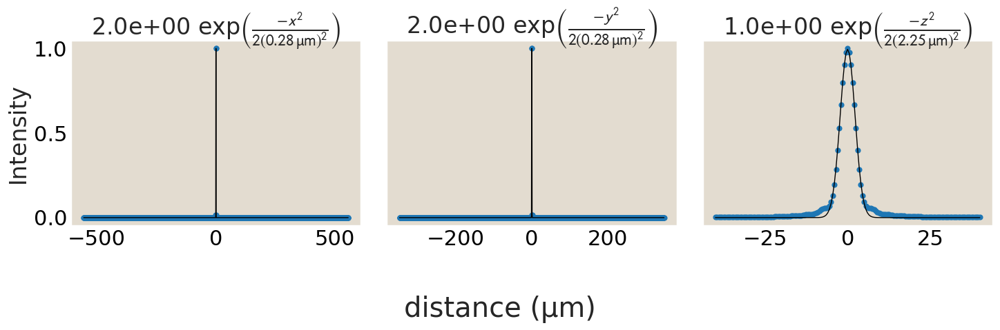

In [690]:
fig, ax = plt.subplots(1,3, figsize=(15, 5), sharey=True)
ax[0].scatter(xaxumnov7, psfairynov7full[psfairynov7full.shape[0]//2, psfairynov7full.shape[1]//2, :], s=15)
ax[0].plot(xaxumnov7, airyGauss(xaxumnov7, xGaussFitnov7airy[0][0], xGaussFitnov7airy[0][1]), 'k-', lw=1)
ax[0].set_title(f'{round(xGaussFitnov7airy[0][0]):.1e}'+rf' exp$\left( \frac{{-x^2}}{{2({round(xGaussFitnov7airy[0][1],2)}\mathrm{{\, \mu m}})^2}} \right)$')
#ax[0].set_title(rf'{round(xGaussFitnov2[0][0])}$e^{{-x^2/{round(xGaussFitnov2[0][1]*umperpxXYnov2,2)}}}$')
#ax[0].set_ylim(-10, 100)

ax[1].scatter(yaxumnov7, psfairynov7full[psfairynov7full.shape[0]//2, :, psfairynov7full.shape[2]//2], s=15)
ax[1].plot(yaxumnov7, airyGauss(yaxumnov7, yGaussFitnov7airy[0][0], yGaussFitnov7airy[0][1]), 'k-', lw=1)
ax[1].set_title(f'{round(yGaussFitnov7airy[0][0]):.1e}'+rf' exp$\left( \frac{{-y^2}}{{2({round(yGaussFitnov7airy[0][1],2)}\mathrm{{\, \mu m}})^2}} \right)$')

ax[2].scatter(zaxumnov7, psfairynov7full[:, psfairynov7full.shape[1]//2, psfairynov7full.shape[2]//2], s=15)
ax[2].plot(zaxumnov7, airyGauss(zaxumnov7, zGaussFitnov7airy[0][0], zGaussFitnov7airy[0][1]), 'k-', lw=1)
ax[2].set_title(f'{round(zGaussFitnov7airy[0][0]):.1e}'+rf' exp$\left( \frac{{-z^2}}{{2({round(zGaussFitnov7airy[0][1],2)} \mathrm{{\, \mu m}})^2}} \right)$')
#ax[2].set_title(rf'{round(zGaussFitnov2[0][0])}$e^{{-z^2/{round(zGaussFitnov2[0][1]*umperpxZnov2,2)}}}$')

fig.supxlabel('distance (µm)')
ax[0].set_ylabel('Intensity')
plt.tight_layout()

#plt.savefig('../../analyzed_data/aster/zstacks/20250727_nov2SigmaFits.pdf', bbox_inches='tight')

In [694]:
#GaussPSFairysettingsnov7 = np.zeros_like(psfairynov7full)

zmin=-umperpxZnov7*len(psfairynov7full)/2
zmax=umperpxZnov7*len(psfairynov7full)/2
xmin=-umperpxXYnov7*len(psfairynov7full[0,0])/2
xmax=umperpxXYnov7*len(psfairynov7full[0,0])/2
ymin=-umperpxXYnov7*len(psfairynov7full[0])/2
ymax=umperpxXYnov7*len(psfairynov7full[0])/2
numz=len(psfairynov7full)
numx=len(psfairynov7full[0,0])
numy=len(psfairynov7full[0])

xvals = np.linspace(xmin, xmax, numx)
yvals = np.linspace(ymin, ymax, numy)
zvals = np.linspace(zmin, zmax, numz)

sigmaTr=0.28;
sigmaAx=2.25; #mu m fixed

# make psf
GaussPSFairysettingsnov7= np.zeros((numx, numy, numz))
for ii in tqdm(range(len(xvals))):
  for j in range(len(yvals)):
    for k in range(len(zvals)):
      GaussPSFairysettingsnov7[ii, j, k]= gaussPSF_tot(xvals[ii], yvals[j], zvals[k], sigmaTr, sigmaAx)


  0%|          | 0/1920 [00:00<?, ?it/s]

In [704]:
GaussPSFairysettingsnov7trans = np.transpose(GaussPSFairysettingsnov7 , (2, 1, 0))

In [698]:
np.max(GaussPSFairysettingsnov7)

np.float64(0.12368110821918883)

In [718]:
imageio.mimwrite('20250805GaussPSFairysettingsnov7480nm.tif', GaussPSFairysettingsnov7trans)

In [714]:
np.where(GaussPSFairysettingsnov7trans[len(GaussPSFairysettingsnov7trans)//2] == GaussPSFairysettingsnov7trans[len(GaussPSFairysettingsnov7trans)//2].max())

(array([599, 599]), array([959, 960]))

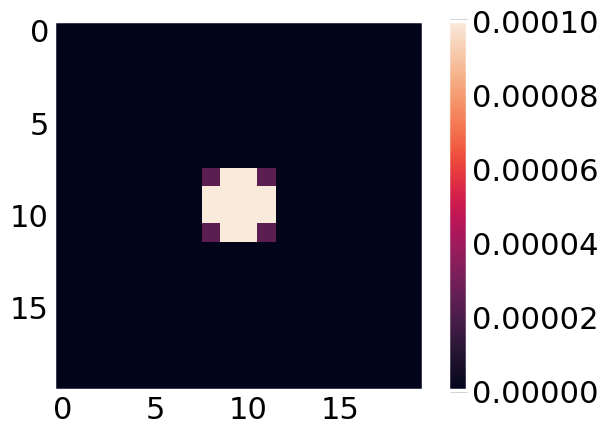

In [717]:
plt.imshow(GaussPSFairysettingsnov7trans[len(GaussPSFairysettingsnov7trans)//2][590:610, 950:970], vmin=0, vmax=0.0001)
plt.colorbar()

In [725]:
nov7Zstack_bs.shape

(161, 1200, 1920)

In [782]:
print(datetime.datetime.now())
deconvtemp = restoration.richardson_lucy(nov7Zstack_bs[len(nov7Zstack_bs)//2], GaussPSFairysettingsnov7trans[len(GaussPSFairysettingsnov7trans)//2]/np.sum(GaussPSFairysettingsnov7trans[len(GaussPSFairysettingsnov7trans)//2]), num_iter=50, clip=False)
print(datetime.datetime.now())

2025-08-05 15:19:40.078479
2025-08-05 15:21:02.479272


In [793]:
print(datetime.datetime.now())
deconvtempairy = restoration.richardson_lucy(nov7Zstack_bs[len(nov7Zstack_bs)//2], psfairynov7full[psfairynov7full.shape[0]//2], num_iter=50, clip=False)
print(datetime.datetime.now())

2025-08-05 16:00:40.088482
2025-08-05 16:01:52.468521


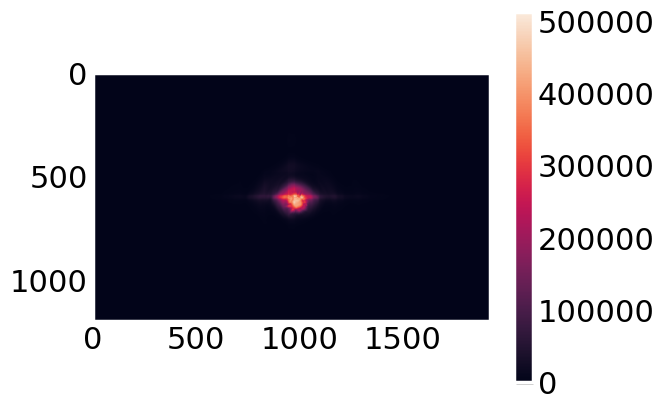

In [794]:
plt.imshow(deconvtempairy)
plt.colorbar()

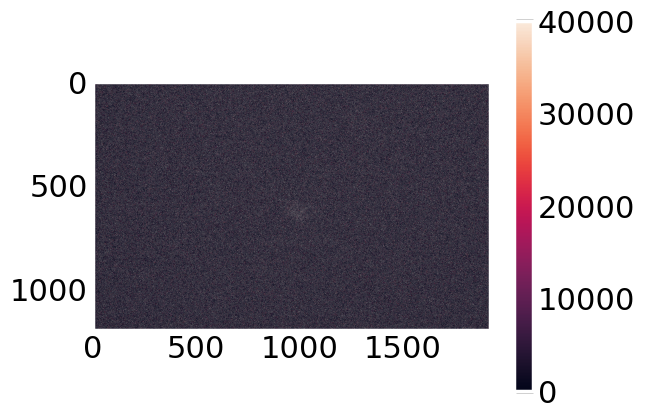

In [783]:
plt.imshow(deconvtemp, vmax=40000)
plt.colorbar()

In [750]:
deconvtemp.min(), np.percentile(deconvtemp, 99)

(np.float64(4.6285727605460246e-76), np.float64(14473126.842371766))

bg sub image

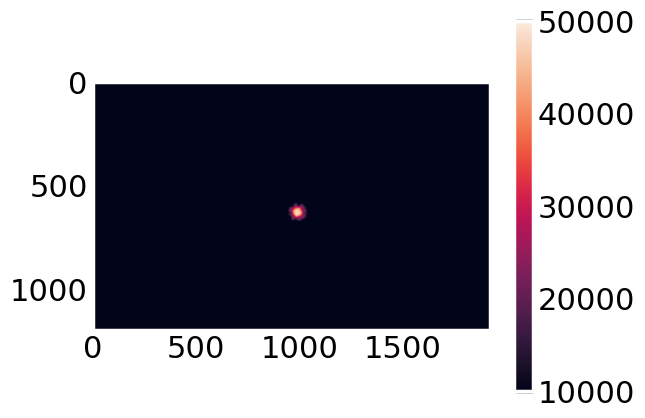

In [910]:
plt.imshow(nov7Zstack_bs[len(nov7Zstack_bs)//2], vmin=10000, vmax=50000)
plt.colorbar()

In [765]:
rl50fiji2d = tifffile.imread(fpathnov7+'ADbgsubplus/20250805GaussPSFairysettingsnov7480nm-Slice81infijRL50i.tif')

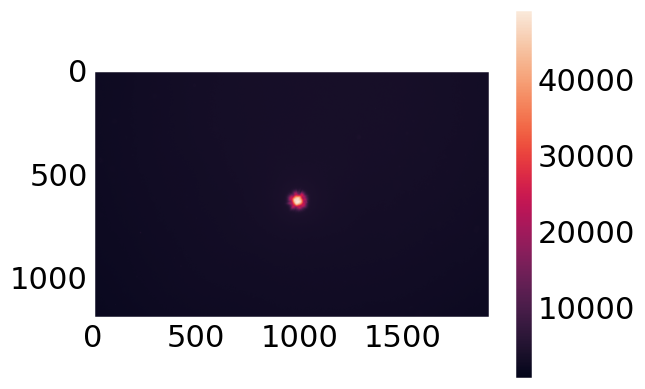

In [833]:
plt.imshow(rl50fiji2d)
plt.colorbar()

Fiji version - it overlaps

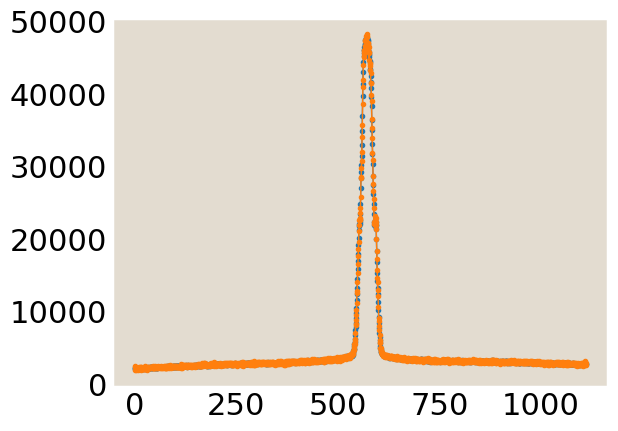

In [843]:
plt.plot(np.arange(len(rl50fiji2d[628]))*umperpxXYnov7, nov7Zstack_bs[len(nov7Zstack_bs)//2][628],'o-',  ms=3, lw=1)
plt.plot(np.arange(len(rl50fiji2d[628]))*umperpxXYnov7, rl50fiji2d[628], 'o-', lw=1, ms=3)

same thing but in python...

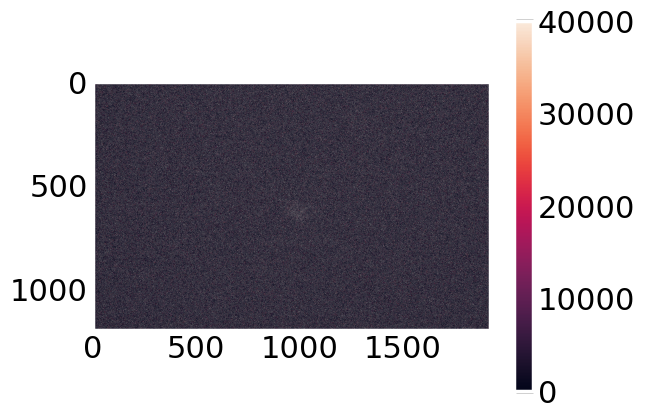

In [792]:
plt.imshow(deconvtemp, vmax=40000)
plt.colorbar()

airy shows something.. quite different - and it didnt matter divided by sum or not

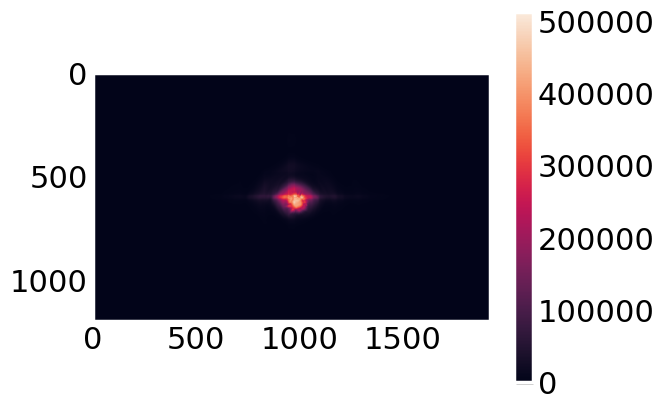

In [795]:
plt.imshow(deconvtempairy)
plt.colorbar()

what if we crop it

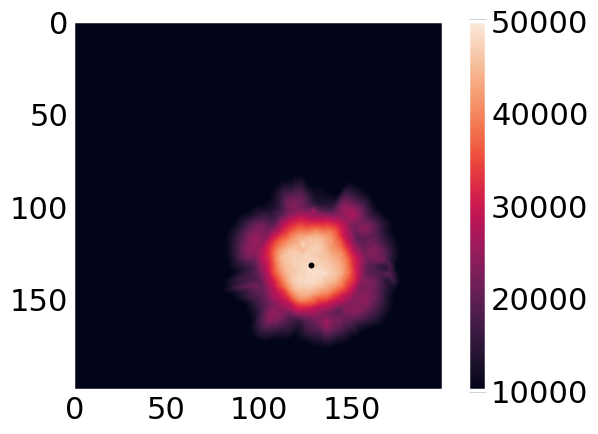

In [842]:
plt.imshow(nov7Zstack_bs[len(nov7Zstack_bs)//2][500:700, 860:1060], vmin=10000, vmax=50000)
plt.colorbar()
plt.scatter(628-500, 992-860, s=5, c='k')

and crop the psf

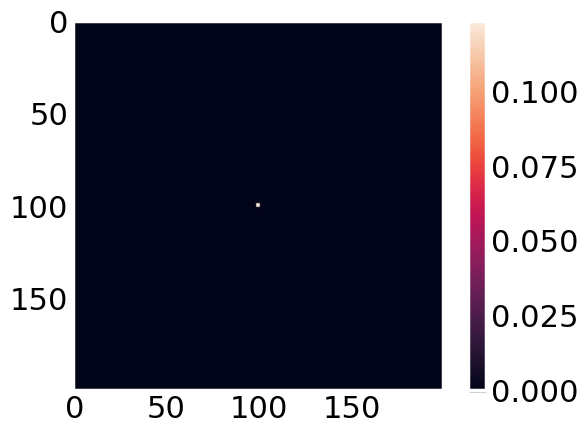

In [807]:
plt.imshow(GaussPSFairysettingsnov7trans[len(GaussPSFairysettingsnov7trans)//2][500:700, 860:1060])#, vmin=10000, vmax=50000)
plt.colorbar()

deconvolve

In [801]:
print(datetime.datetime.now())
deconvtempcrop = restoration.richardson_lucy(nov7Zstack_bs[len(nov7Zstack_bs)//2][500:700, 860:1060], GaussPSFairysettingsnov7trans[len(GaussPSFairysettingsnov7trans)//2][500:700, 860:1060], num_iter=50, clip=False)
print(datetime.datetime.now())

2025-08-05 16:30:55.851401
2025-08-05 16:30:56.859403


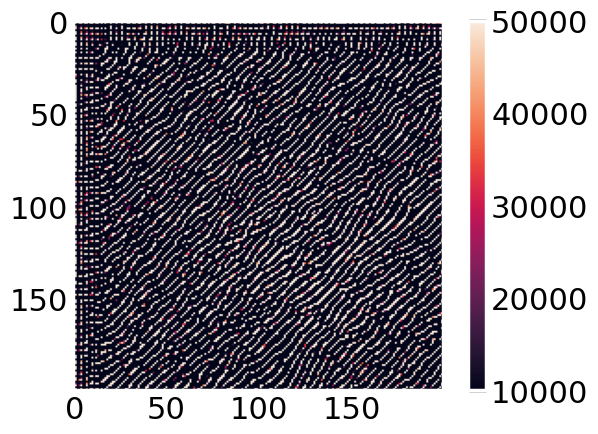

In [806]:
plt.imshow(deconvtempcrop, vmin=10000, vmax=50000)
plt.colorbar()

i cry. ok lets do the more points thing

In [798]:
#GaussPSFairysettingsnov7 = np.zeros_like(psfairynov7full)

xmin=-umperpxXYnov7*len(psfairynov7full[0,0])/2
xmax=umperpxXYnov7*len(psfairynov7full[0,0])/2
ymin=-umperpxXYnov7*len(psfairynov7full[0])/2
ymax=umperpxXYnov7*len(psfairynov7full[0])/2

xvals = np.linspace(xmin, xmax, numx)
yvals = np.linspace(ymin, ymax, numy)
zvals = np.linspace(zmin, zmax, numz)

sigmaTr=0.28;
sigmaAx=2.25; #mu m fixed

# make psf
psf2DMorePoints= np.zeros((numx*5, numy*5))
for ii, xval in enumerate(tqdm(np.linspace(xmin, xmax, numx*5))):
  for j, yval in enumerate(np.linspace(ymin, ymax, numy*5)):
    psf2DMorePoints[ii, j]= gaussPSF_transverse(xval, yval, sigmaTr)


  0%|          | 0/9600 [00:00<?, ?it/s]

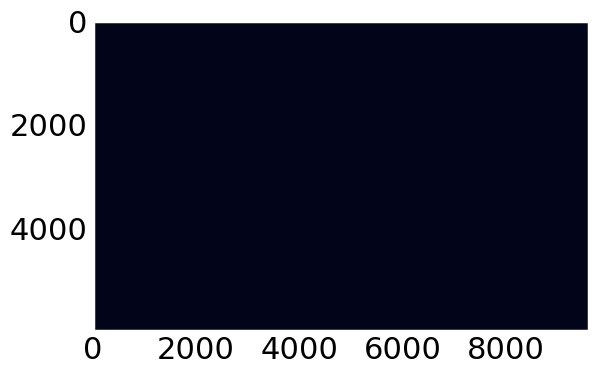

In [809]:
plt.imshow(psf2DMorePoints.T)

will it accept different siz matrices?

In [963]:
print(datetime.datetime.now())
deconvtempcropmorepts = restoration.richardson_lucy(nov7Zstack_bs[len(nov7Zstack_bs)//2], psf2DMorePoints.T, num_iter=50, clip=False)
print(datetime.datetime.now())

2025-08-06 16:49:48.225483
2025-08-06 17:03:11.879495


well maybe this worked?

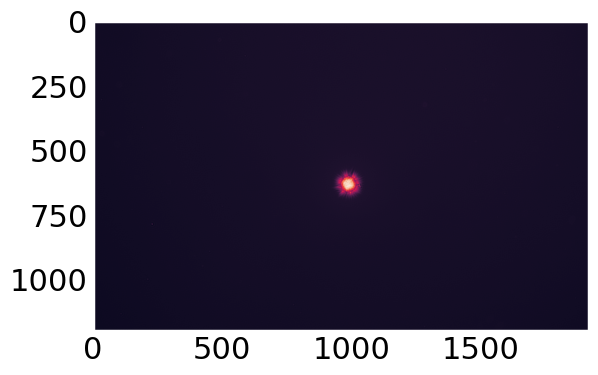

In [964]:
plt.imshow(deconvtempcropmorepts)

compare with the fiji deconv

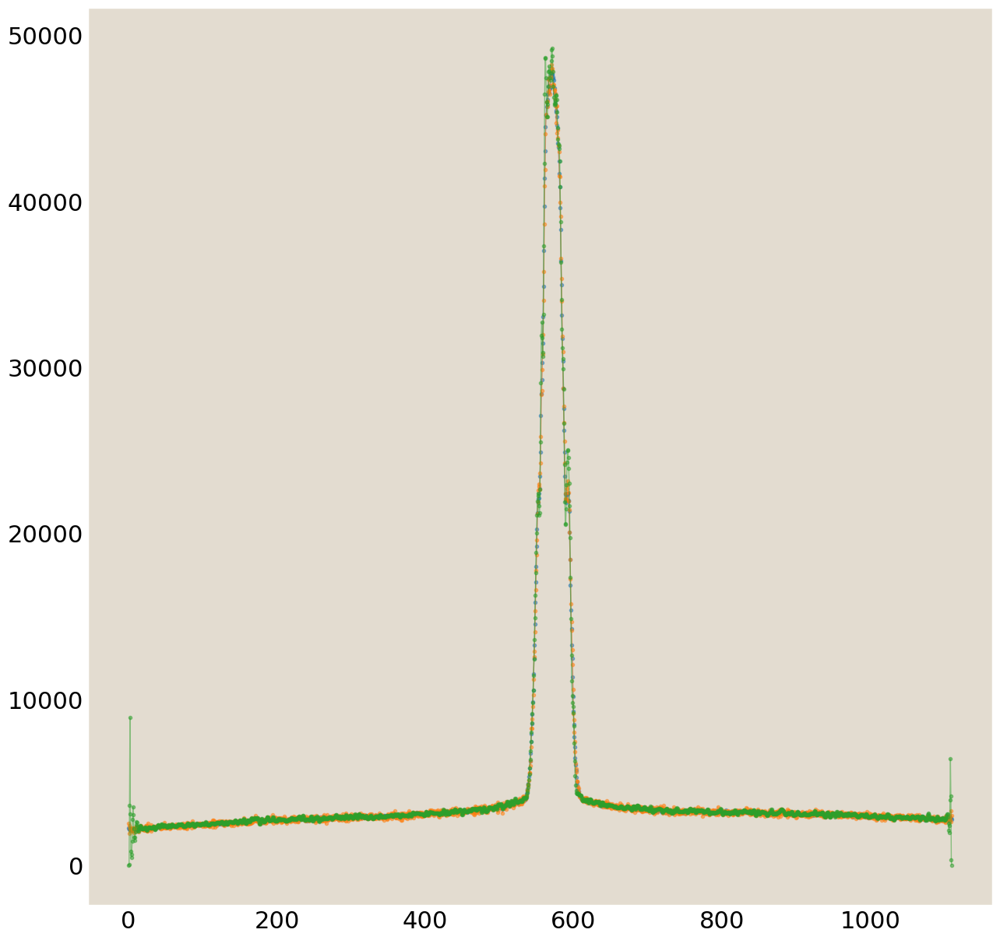

In [965]:
fig, ax = plt.subplots(figsize=(15,15))
plt.plot(np.arange(len(nov7Zstack_bs[len(nov7Zstack_bs)//2][628]))*umperpxXYnov7, nov7Zstack_bs[len(nov7Zstack_bs)//2][628],'o-',  ms=3, lw=1, label='raw', alpha=.5)
plt.plot(np.arange(len(rl50fiji2d[628]))*umperpxXYnov7, rl50fiji2d[628], 'o-', lw=1, ms=3, label='fiji 50it gauss from airy', alpha=.5)
plt.plot(np.arange(len(deconvtempcropmorepts[628]))*umperpxXYnov7, deconvtempcropmorepts[628], 'o-', lw=1, ms=3, label='in python bigger psf', alpha=.5)
#plt.legend()

# 20250806

test image

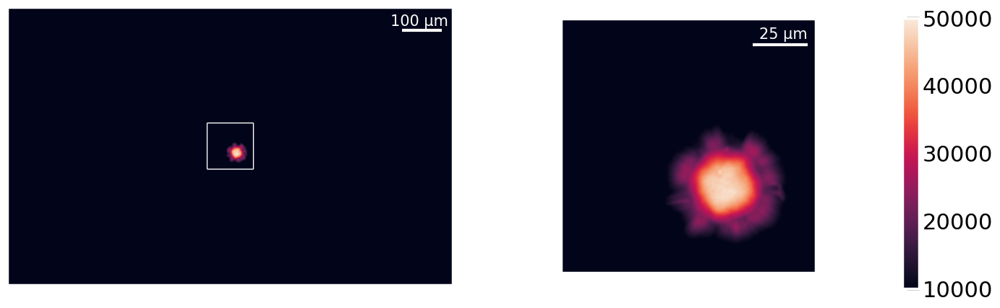

In [916]:
Nov7MotorsbsSlice81infiji_ = tifffile.imread(fpathnov7+'ADbgsubplus/20250804Nov7MotorsbsSlice81infiji_.tif')

fig, ax = plt.subplots(1,2, figsize=(15, 5), gridspec_kw={'width_ratios': [2, 1]})
ax[0].imshow(Nov7MotorsbsSlice81infiji_, vmin=10000, vmax=50000)
ax[0].vlines([860, 1060], 500, 700, color='w', lw=1)
ax[0].hlines([500, 700], 860, 1060, color='w', lw=1)
ax[0].plot([1700, 1700+(100/umperpxXYnov7)], [100, 100], color='w', solid_capstyle='butt')
ax[0].text(1650, 80, '100 µm', color='w', fontsize='15')


ax[1].imshow(Nov7MotorsbsSlice81infiji_[500:700, 860:1060], vmin=10000, vmax=50000)
ax[1].plot([150, 150+(25/umperpxXYnov7)], [20, 20], color='w', solid_capstyle='butt')
ax[1].text(155, 15, '25 µm', color='w', fontsize='15')

ax[0].set_xticklabels([])
ax[1].set_xticklabels([])
ax[0].set_yticklabels([])
ax[1].set_yticklabels([])
#### colorbar ####
cax = fig.add_axes([0.98, 0.1, 0.015, 0.75])  # horizontal [left, bottom, width, height]
cbar = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=10000, vmax=50000)),
                    cax=cax, 
                    orientation='vertical')
cbarbot.ax.tick_params(labelsize=20)

#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806nov7asterbs.pdf', bbox_inches='tight')

import psf slice from 3D airy generation. Motor channel full size stack

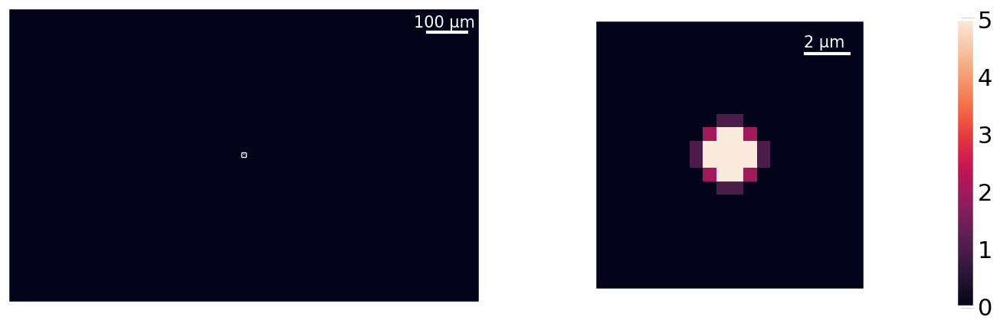

In [992]:
PSFBW513nmSlice81 = tifffile.imread(fpathnov7+'ADbgsubplus/20250806PSFBW513nmSlice81Fiji.tif')
#plt.imshow(PSFBW513nmSlice81[590:610, 950:970], vmin=0, vmax=5)


fig, ax = plt.subplots(1,2, figsize=(15, 5), gridspec_kw={'width_ratios': [2, 1]})
ax[0].imshow(PSFBW513nmSlice81, vmin=0, vmax=5)
ax[0].vlines([950, 970], 590, 610, color='w', lw=1)
ax[0].hlines([590, 610], 950, 970, color='w', lw=1)
ax[0].plot([1700, 1700+(100/umperpxXYnov7)], [100, 100], color='w', solid_capstyle='butt')
ax[0].text(1650, 80, '100 µm', color='w', fontsize='15')


ax[1].imshow(PSFBW513nmSlice81[590:610, 950:970], vmin=0, vmax=5)
ax[1].plot([15, 15+(2/umperpxXYnov7)], [2, 2], color='w', solid_capstyle='butt')
ax[1].text(15, 1.5, '2 µm', color='w', fontsize='15')

ax[0].set_xticklabels([])
ax[1].set_xticklabels([])
ax[0].set_yticklabels([])
ax[1].set_yticklabels([])
#### colorbar ####
cax = fig.add_axes([0.98, 0.1, 0.015, 0.75])  # horizontal [left, bottom, width, height]
cbar = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=0, vmax=5)),
                    cax=cax, 
                    orientation='vertical')
cbarbot.ax.tick_params(labelsize=20)
#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806PSFBW513nmSlice81.pdf', bbox_inches='tight')

import the deconvolved 2D airy image in fiji

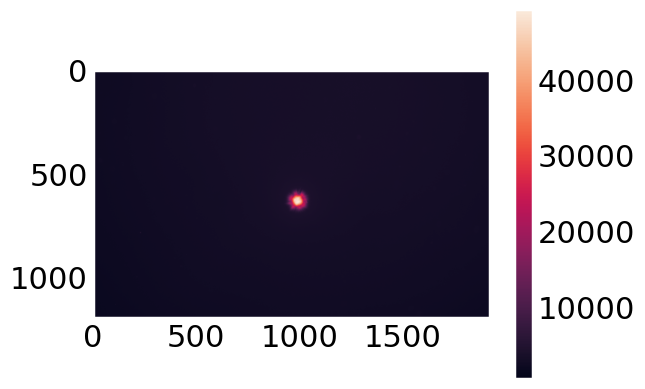

In [907]:
RL50_513nmSlice81 = tifffile.imread(fpathnov7+'ADbgsubplus/20250806RL50_513nmSlice81Fiji.tif')
plt.imshow(RL50_513nmSlice81)
plt.colorbar()

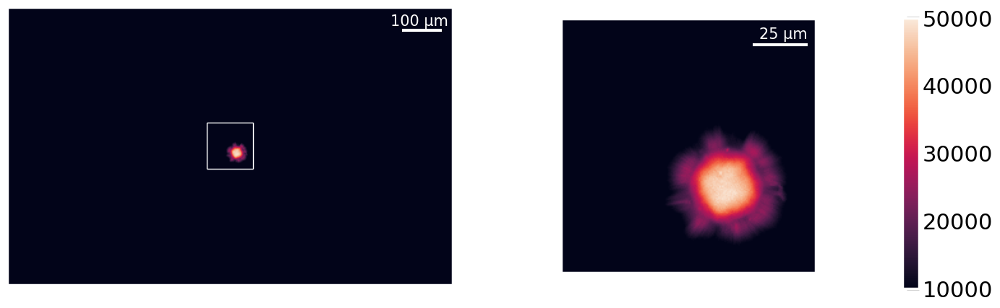

In [998]:
fig, ax = plt.subplots(1,2, figsize=(15, 5), gridspec_kw={'width_ratios': [2, 1]})
ax[0].imshow(RL50_513nmSlice81, vmin=10000, vmax=50000)
ax[0].vlines([860, 1060], 500, 700, color='w', lw=1)
ax[0].hlines([500, 700], 860, 1060, color='w', lw=1)
ax[0].plot([1700, 1700+(100/umperpxXYnov7)], [100, 100], color='w', solid_capstyle='butt')
ax[0].text(1650, 80, '100 µm', color='w', fontsize='15')


ax[1].imshow(RL50_513nmSlice81[500:700, 860:1060], vmin=10000, vmax=50000)
ax[1].plot([150, 150+(25/umperpxXYnov7)], [20, 20], color='w', solid_capstyle='butt')
ax[1].text(155, 15, '25 µm', color='w', fontsize='15')

ax[0].set_xticklabels([])
ax[1].set_xticklabels([])
ax[0].set_yticklabels([])
ax[1].set_yticklabels([])
#### colorbar ####
cax = fig.add_axes([0.98, 0.1, 0.015, 0.75])  # horizontal [left, bottom, width, height]
cbar = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=10000, vmax=50000)),
                    cax=cax, 
                    orientation='vertical')
cbarbot.ax.tick_params(labelsize=20)

#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806FijiRL50BW_513nmSlice81.pdf', bbox_inches='tight')

take the traces - did this work because of the bit depth?

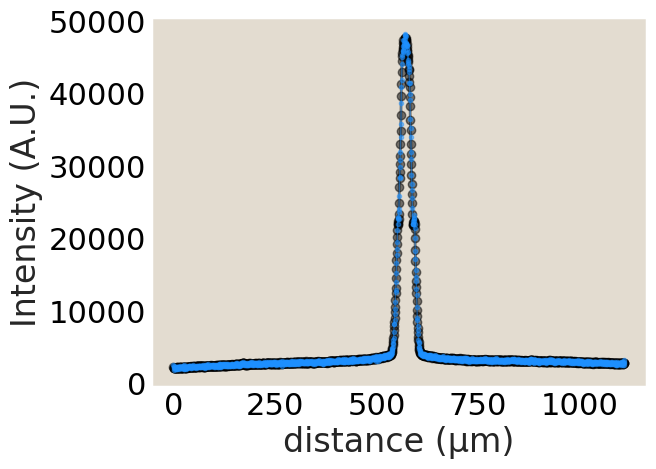

In [1002]:
yslice =628
fig, ax = plt.subplots()
plt.plot(np.arange(len(Nov7MotorsbsSlice81infiji_[yslice]))*umperpxXYnov7, Nov7MotorsbsSlice81infiji_[yslice],'o-',  ms=6, lw=2, label='raw', alpha=.5, color='k')
plt.plot(np.arange(len(RL50_513nmSlice81[yslice]))*umperpxXYnov7, RL50_513nmSlice81[yslice], 'o-', lw=1, ms=3, label='fiji 50it airy deconv', alpha=.5, color='dodgerblue')
plt.xlabel('distance (µm)')
plt.ylabel('Intensity (A.U.)')

#plt.legend()
#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806FijiRL50BW_513nmSlice81slice628.pdf', bbox_inches='tight')

do the deconvolution using python

In [934]:
print(datetime.datetime.now())
pyRL50BW513nmSlice81 = restoration.richardson_lucy(Nov7MotorsbsSlice81infiji_, PSFBW513nmSlice81, num_iter=50, clip=False)
print(datetime.datetime.now())

2025-08-06 14:53:30.832787
2025-08-06 14:54:48.783684


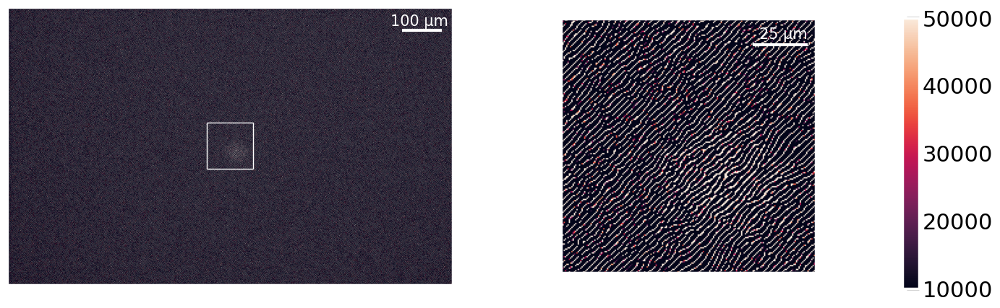

In [993]:
fig, ax = plt.subplots(1,2, figsize=(15, 5), gridspec_kw={'width_ratios': [2, 1]})
ax[0].imshow(pyRL50BW513nmSlice81, vmin=10000, vmax=50000)
ax[0].vlines([860, 1060], 500, 700, color='w', lw=1)
ax[0].hlines([500, 700], 860, 1060, color='w', lw=1)
ax[0].plot([1700, 1700+(100/umperpxXYnov7)], [100, 100], color='w', solid_capstyle='butt')
ax[0].text(1650, 80, '100 µm', color='w', fontsize='15')


ax[1].imshow(pyRL50BW513nmSlice81[500:700, 860:1060], vmin=10000, vmax=50000)
ax[1].plot([150, 150+(25/umperpxXYnov7)], [20, 20], color='w', solid_capstyle='butt')
ax[1].text(155, 15, '25 µm', color='w', fontsize='15')

ax[0].set_xticklabels([])
ax[1].set_xticklabels([])
ax[0].set_yticklabels([])
ax[1].set_yticklabels([])
#### colorbar ####
cax = fig.add_axes([0.98, 0.1, 0.015, 0.75])  # horizontal [left, bottom, width, height]
cbar = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=10000, vmax=50000)),
                    cax=cax, 
                    orientation='vertical')
cbarbot.ax.tick_params(labelsize=20)

#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806pyRL50BW513nmSlice81.pdf', bbox_inches='tight')

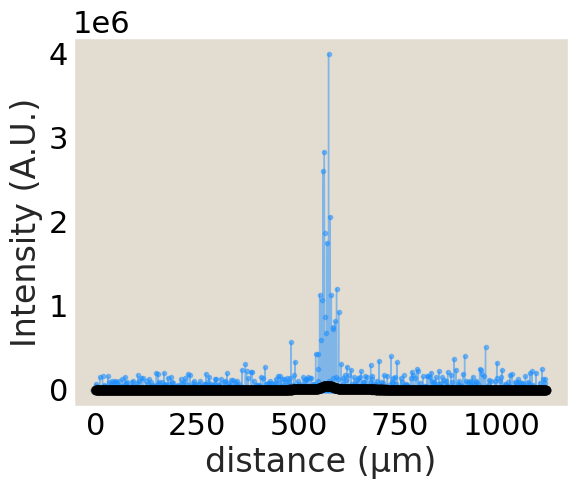

In [1004]:
yslice =628
fig, ax = plt.subplots()
plt.plot(np.arange(len(Nov7MotorsbsSlice81infiji_[yslice]))*umperpxXYnov7, Nov7MotorsbsSlice81infiji_[yslice],'o-',  ms=6, lw=1, label='raw', alpha=.5, color='k')
#plt.plot(np.arange(len(RL50_513nmSlice81[yslice]))*umperpxXYnov7, RL50_513nmSlice81[yslice], 'o-', lw=1, ms=3, label='fiji 50it airy deconv', alpha=.5)
plt.plot(np.arange(len(pyRL50BW513nmSlice81[yslice]))*umperpxXYnov7, pyRL50BW513nmSlice81[yslice], 'o-', lw=1, ms=3, label='python 50it airy deconv', alpha=.5, zorder=0, color='dodgerblue')
#plt.legend()
plt.xlabel('distance (µm)')
plt.ylabel('Intensity (A.U.)')
#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806pyRL50BW513nmSlice81slice628.pdf', bbox_inches='tight')

normalize the airy firwswt?

In [942]:
print(datetime.datetime.now())
pyRL50BW513nmSlice81normed = restoration.richardson_lucy(Nov7MotorsbsSlice81infiji_, PSFBW513nmSlice81/np.sum(PSFBW513nmSlice81), num_iter=50, clip=False)
print(datetime.datetime.now())

2025-08-06 15:35:35.707699
2025-08-06 15:36:53.334302


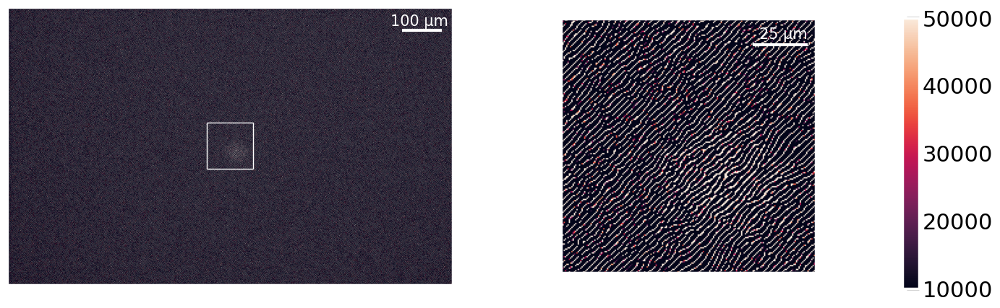

In [943]:
fig, ax = plt.subplots(1,2, figsize=(15, 5), gridspec_kw={'width_ratios': [2, 1]})
ax[0].imshow(pyRL50BW513nmSlice81normed, vmin=10000, vmax=50000)
ax[0].vlines([860, 1060], 500, 700, color='w', lw=1)
ax[0].hlines([500, 700], 860, 1060, color='w', lw=1)
ax[0].plot([1700, 1700+(100/umperpxXYnov7)], [100, 100], color='w', solid_capstyle='butt')
ax[0].text(1650, 80, '100 µm', color='w', fontsize='15')


ax[1].imshow(pyRL50BW513nmSlice81normed[500:700, 860:1060], vmin=10000, vmax=50000)
ax[1].plot([150, 150+(25/umperpxXYnov7)], [20, 20], color='w', solid_capstyle='butt')
ax[1].text(155, 15, '25 µm', color='w', fontsize='15')

ax[0].set_xticklabels([])
ax[1].set_xticklabels([])
ax[0].set_yticklabels([])
ax[1].set_yticklabels([])
#### colorbar ####
cax = fig.add_axes([0.98, 0.1, 0.015, 0.75])  # horizontal [left, bottom, width, height]
cbar = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=10000, vmax=50000)),
                    cax=cax, 
                    orientation='vertical')
cbarbot.ax.tick_params(labelsize=20)

#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806pyRL50BW513nmSlice81normed.pdf', bbox_inches='tight')

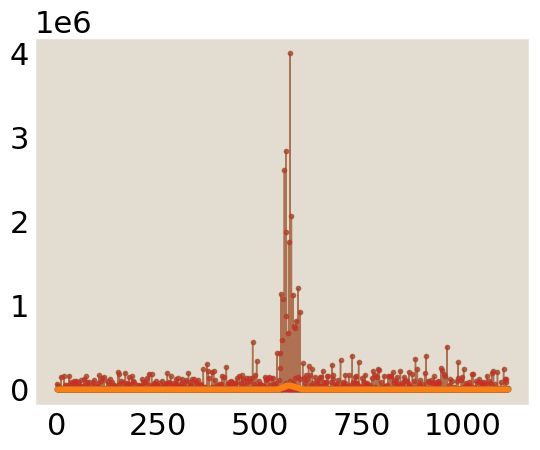

In [945]:
yslice =628
fig, ax = plt.subplots()
plt.plot(np.arange(len(Nov7MotorsbsSlice81infiji_[yslice]))*umperpxXYnov7, Nov7MotorsbsSlice81infiji_[yslice],'o-',  ms=3, lw=1, label='raw', alpha=.5)
plt.plot(np.arange(len(RL50_513nmSlice81[yslice]))*umperpxXYnov7, RL50_513nmSlice81[yslice], 'o-', lw=1, ms=3, label='fiji 50it airy deconv', alpha=.5)
plt.plot(np.arange(len(pyRL50BW513nmSlice81[yslice]))*umperpxXYnov7, pyRL50BW513nmSlice81[yslice], 'o-', lw=1, ms=3, label='python 50it airy deconv', alpha=.5, zorder=0)
plt.plot(np.arange(len(pyRL50BW513nmSlice81normed[yslice]))*umperpxXYnov7, pyRL50BW513nmSlice81normed[yslice], 'o-', lw=1, ms=3, label='python 50it airy deconv', alpha=.5, zorder=0)
#plt.legend()

wow yikes - ok gauss time - first fit the airy

In [948]:
PSF513nmfull = tifffile.imread(fpathnov7+'ADbgsubplus/20250806PSFBW513nm.tif')

imxaxnov7 = PSF513nmfull.shape[2]
xaxumnov7 = np.linspace(imxaxnov7//2*-1+0.5, imxaxnov7//2-0.5, imxaxnov7)*umperpxXYnov7

imyaxnov7 = PSF513nmfull.shape[1]
yaxumnov7 = np.linspace(imyaxnov7//2*-1+0.5, imyaxnov7//2-0.5, imyaxnov7)*umperpxXYnov7

imzaxnov7 = PSF513nmfull.shape[0]
zaxumnov7 = np.linspace(imzaxnov7//2*-1, imzaxnov7//2, imzaxnov7)*umperpxZnov7

xGauss513nmSlice81 = scipy.optimize.curve_fit(airyGauss, xaxumnov7, PSF513nmfull[PSF513nmfull.shape[0]//2, PSF513nmfull.shape[1]//2, :], [1, 2] )
yGauss513nmSlice81 = scipy.optimize.curve_fit(airyGauss, yaxumnov7, PSF513nmfull[PSF513nmfull.shape[0]//2, :, PSF513nmfull.shape[2]//2], [1, 2] )
zGauss513nmSlice81 = scipy.optimize.curve_fit(airyGauss, zaxumnov7,PSF513nmfull[:, PSF513nmfull.shape[1]//2, PSF513nmfull.shape[2]//2], [1, 2] )


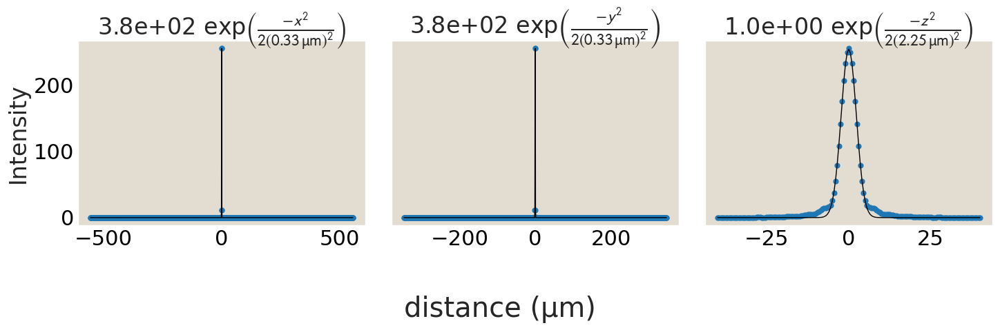

In [994]:
fig, ax = plt.subplots(1,3, figsize=(15, 5), sharey=True)
ax[0].scatter(xaxumnov7, PSF513nmfull[PSF513nmfull.shape[0]//2, PSF513nmfull.shape[1]//2, :], s=15)
ax[0].plot(xaxumnov7, airyGauss(xaxumnov7, xGauss513nmSlice81[0][0], xGauss513nmSlice81[0][1]), 'k-', lw=1)
ax[0].set_title(f'{round(xGauss513nmSlice81[0][0]):.1e}'+rf' exp$\left( \frac{{-x^2}}{{2({round(xGauss513nmSlice81[0][1],2)}\mathrm{{\, \mu m}})^2}} \right)$')
#ax[0].set_title(rf'{round(xGaussFitnov2[0][0])}$e^{{-x^2/{round(xGaussFitnov2[0][1]*umperpxXYnov2,2)}}}$')
#ax[0].set_ylim(-10, 100)

ax[1].scatter(yaxumnov7, PSF513nmfull[PSF513nmfull.shape[0]//2, :, PSF513nmfull.shape[2]//2], s=15)
ax[1].plot(yaxumnov7, airyGauss(yaxumnov7, yGauss513nmSlice81[0][0], yGauss513nmSlice81[0][1]), 'k-', lw=1)
ax[1].set_title(f'{round(yGauss513nmSlice81[0][0]):.1e}'+rf' exp$\left( \frac{{-y^2}}{{2({round(yGauss513nmSlice81[0][1],2)}\mathrm{{\, \mu m}})^2}} \right)$')

ax[2].scatter(zaxumnov7, PSF513nmfull[:, PSF513nmfull.shape[1]//2, PSF513nmfull.shape[2]//2], s=15)
ax[2].plot(zaxumnov7, airyGauss(zaxumnov7, zGauss513nmSlice81[0][0], zGauss513nmSlice81[0][1]), 'k-', lw=1)
ax[2].set_title(f'{round(zGaussFitnov7airy[0][0]):.1e}'+rf' exp$\left( \frac{{-z^2}}{{2({round(zGaussFitnov7airy[0][1],2)} \mathrm{{\, \mu m}})^2}} \right)$')
#ax[2].set_title(rf'{round(zGaussFitnov2[0][0])}$e^{{-z^2/{round(zGaussFitnov2[0][1]*umperpxZnov2,2)}}}$')

fig.supxlabel('distance (µm)')
ax[0].set_ylabel('Intensity')
plt.tight_layout()

#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806PSF513nmfullFits.pdf', bbox_inches='tight')

make center gauss psf based on airy

In [955]:
#GaussPSFairysettingsnov7 = np.zeros_like(psfairynov7full)

xmin=-umperpxXYnov7*len(PSF513nmfull[0,0])/2
xmax=umperpxXYnov7*len(PSF513nmfull[0,0])/2
ymin=-umperpxXYnov7*len(PSF513nmfull[0])/2
ymax=umperpxXYnov7*len(PSF513nmfull[0])/2
numx=len(PSF513nmfull[0,0])
numy=len(PSF513nmfull[0])

xvals = np.linspace(xmin, xmax, numx)
yvals = np.linspace(ymin, ymax, numy)

sigmaTr=0.33;
sigmaAx=2.25; #mu m fixed

# make psf
PSFGauss513nmSlice81= np.zeros((numx, numy))
for ii in tqdm(range(len(xvals))):
  for j in range(len(yvals)):
      PSFGauss513nmSlice81[ii, j]= gaussPSF_tot(xvals[ii], yvals[j], 0, sigmaTr, sigmaAx)
PSFGauss513nmSlice81 = PSFGauss513nmSlice81.T

  0%|          | 0/1920 [00:00<?, ?it/s]

save psf for fiji quickly

In [966]:
imageio.imwrite('20250806PSFGauss513nmSlice81_0p33xy2.25z.tif', PSFGauss513nmSlice81)

ok look at the psf

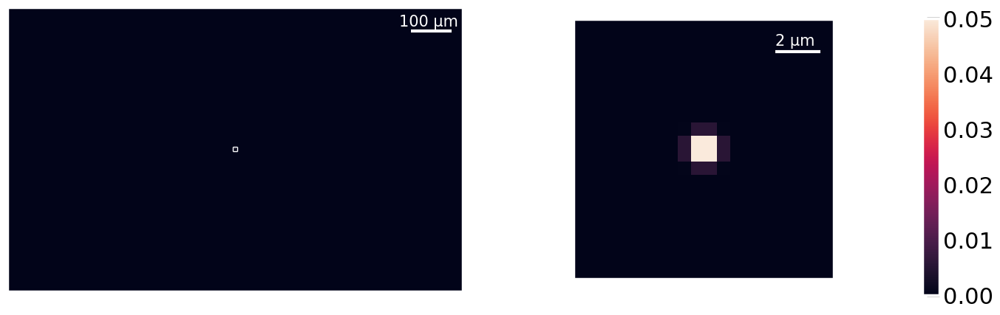

In [995]:

fig, ax = plt.subplots(1,2, figsize=(15, 5), gridspec_kw={'width_ratios': [2, 1]})
ax[0].imshow(PSFGauss513nmSlice81, vmin=0, vmax=0.05)
ax[0].vlines([950, 970], 590, 610, color='w', lw=1)
ax[0].hlines([590, 610], 950, 970, color='w', lw=1)
ax[0].plot([1700, 1700+(100/umperpxXYnov7)], [100, 100], color='w', solid_capstyle='butt')
ax[0].text(1650, 80, '100 µm', color='w', fontsize='15')


ax[1].imshow(PSFGauss513nmSlice81[590:610, 950:970], vmin=0, vmax=0.05)
ax[1].plot([15, 15+(2/umperpxXYnov7)], [2, 2], color='w', solid_capstyle='butt')
ax[1].text(15, 1.5, '2 µm', color='w', fontsize='15')

ax[0].set_xticklabels([])
ax[1].set_xticklabels([])
ax[0].set_yticklabels([])
ax[1].set_yticklabels([])
#### colorbar ####
cax = fig.add_axes([0.98, 0.1, 0.015, 0.75])  # horizontal [left, bottom, width, height]
cbar = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=0, vmax=0.05)),
                    cax=cax, 
                    orientation='vertical')
cbarbot.ax.tick_params(labelsize=20)
#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806PSFGauss513nmSlice81.pdf', bbox_inches='tight')

Try it in python

In [961]:
print(datetime.datetime.now())
pyRL50Gauss513nmSlice81 = restoration.richardson_lucy(Nov7MotorsbsSlice81infiji_, PSFGauss513nmSlice81, num_iter=50, clip=False)
print(datetime.datetime.now())

2025-08-06 16:44:04.207792
2025-08-06 16:45:32.065326


gauss also looks weird when put through python

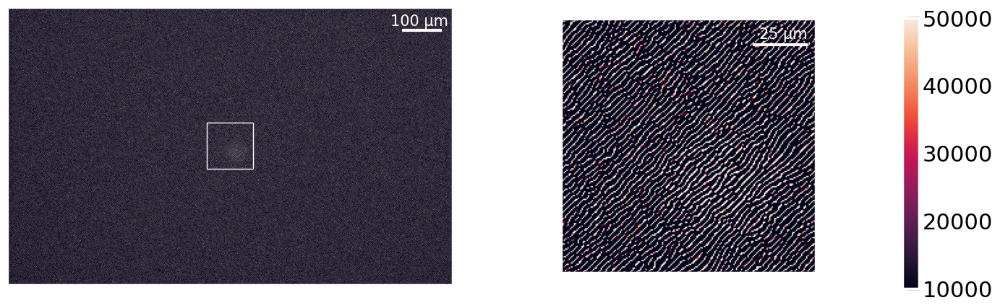

In [996]:
fig, ax = plt.subplots(1,2, figsize=(15, 5), gridspec_kw={'width_ratios': [2, 1]})
ax[0].imshow(pyRL50Gauss513nmSlice81, vmin=10000, vmax=50000)
ax[0].vlines([860, 1060], 500, 700, color='w', lw=1)
ax[0].hlines([500, 700], 860, 1060, color='w', lw=1)
ax[0].plot([1700, 1700+(100/umperpxXYnov7)], [100, 100], color='w', solid_capstyle='butt')
ax[0].text(1650, 80, '100 µm', color='w', fontsize='15')


ax[1].imshow(pyRL50Gauss513nmSlice81[500:700, 860:1060], vmin=10000, vmax=50000)
ax[1].plot([150, 150+(25/umperpxXYnov7)], [20, 20], color='w', solid_capstyle='butt')
ax[1].text(155, 15, '25 µm', color='w', fontsize='15')

ax[0].set_xticklabels([])
ax[1].set_xticklabels([])
ax[0].set_yticklabels([])
ax[1].set_yticklabels([])
#### colorbar ####
cax = fig.add_axes([0.98, 0.1, 0.015, 0.75])  # horizontal [left, bottom, width, height]
cbar = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=10000, vmax=50000)),
                    cax=cax, 
                    orientation='vertical')
cbarbot.ax.tick_params(labelsize=20)

#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806pyRL50Gauss513nmSlice81.pdf', bbox_inches='tight')

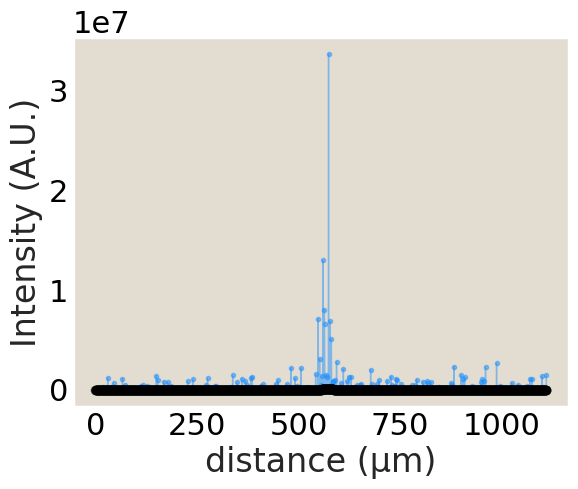

In [1006]:
yslice =628
fig, ax = plt.subplots()
plt.plot(np.arange(len(Nov7MotorsbsSlice81infiji_[yslice]))*umperpxXYnov7, Nov7MotorsbsSlice81infiji_[yslice],'o-',  ms=6, lw=1, label='raw', alpha=.5, color='k')
#plt.plot(np.arange(len(RL50_513nmSlice81[yslice]))*umperpxXYnov7, RL50_513nmSlice81[yslice], 'o-', lw=1, ms=3, label='fiji 50it airy deconv', alpha=.5)
plt.plot(np.arange(len(pyRL50Gauss513nmSlice81[yslice]))*umperpxXYnov7, pyRL50Gauss513nmSlice81[yslice], 'o-', lw=1, ms=3, label='py 50it airy deconv', alpha=.5, zorder=0, color='dodgerblue')
#plt.legend()

plt.xlabel('distance (µm)')
plt.ylabel('Intensity (A.U.)')
#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806pyRL50Gauss513nmSlice81slice628.pdf', bbox_inches='tight')

import the gauss run version in fiji

In [967]:
RL50_Gauss513nmSlice81Fiji_0p33xy2p25z = tifffile.imread(fpathnov7+'ADbgsubplus/20250806RL50_Gauss513nmSlice81Fiji_0p33xy2p25z.tif')


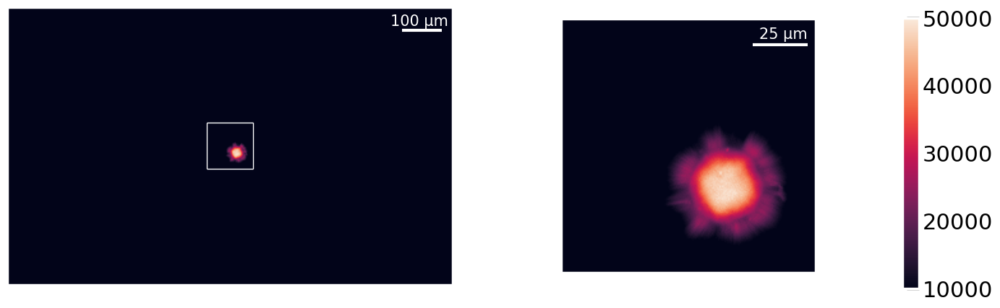

In [1000]:
fig, ax = plt.subplots(1,2, figsize=(15, 5), gridspec_kw={'width_ratios': [2, 1]})
ax[0].imshow(RL50_Gauss513nmSlice81Fiji_0p33xy2p25z, vmin=10000, vmax=50000)
ax[0].vlines([860, 1060], 500, 700, color='w', lw=1)
ax[0].hlines([500, 700], 860, 1060, color='w', lw=1)
ax[0].plot([1700, 1700+(100/umperpxXYnov7)], [100, 100], color='w', solid_capstyle='butt')
ax[0].text(1650, 80, '100 µm', color='w', fontsize='15')


ax[1].imshow(RL50_Gauss513nmSlice81Fiji_0p33xy2p25z[500:700, 860:1060], vmin=10000, vmax=50000)
ax[1].plot([150, 150+(25/umperpxXYnov7)], [20, 20], color='w', solid_capstyle='butt')
ax[1].text(155, 15, '25 µm', color='w', fontsize='15')

ax[0].set_xticklabels([])
ax[1].set_xticklabels([])
ax[0].set_yticklabels([])
ax[1].set_yticklabels([])
#### colorbar ####
cax = fig.add_axes([0.98, 0.1, 0.015, 0.75])  # horizontal [left, bottom, width, height]
cbar = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=10000, vmax=50000)),
                    cax=cax, 
                    orientation='vertical')
cbarbot.ax.tick_params(labelsize=20)

#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806FijiRL50_Gauss513nmSlice81Fiji_0p33xy2p25z.pdf', bbox_inches='tight')

look all the fiji run things overlap

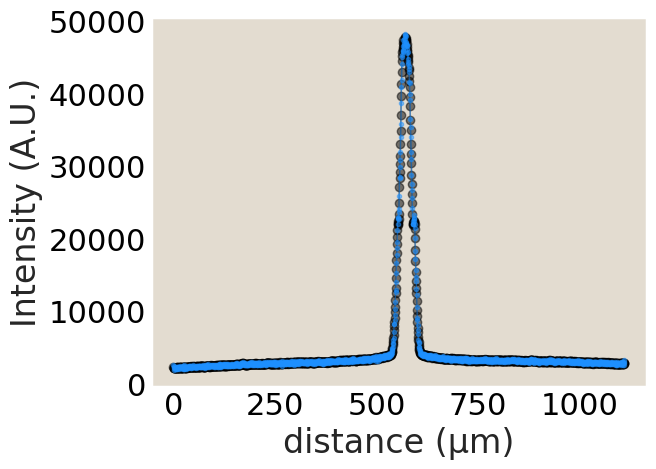

In [1008]:
yslice =628
fig, ax = plt.subplots()
plt.plot(np.arange(len(Nov7MotorsbsSlice81infiji_[yslice]))*umperpxXYnov7, Nov7MotorsbsSlice81infiji_[yslice],'o-',  ms=6, lw=1, label='raw', alpha=.5, color='k')
#plt.plot(np.arange(len(RL50_513nmSlice81[yslice]))*umperpxXYnov7, RL50_513nmSlice81[yslice], 'o-', lw=1, ms=3, label='fiji 50it airy deconv', alpha=.5)
plt.plot(np.arange(len(RL50_Gauss513nmSlice81Fiji_0p33xy2p25z[yslice]))*umperpxXYnov7, RL50_Gauss513nmSlice81Fiji_0p33xy2p25z[yslice], 'o-', lw=1, ms=3, label='fiji 50it airy deconv', alpha=.5, color='dodgerblue')
#plt.legend()
plt.xlabel('distance (µm)')
plt.ylabel('Intensity (A.U.)')
#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806RL50_Gauss513nmSlice81Fiji_0p33xy2p25zslice628.pdf', bbox_inches='tight')

ran the 3D airy in fiji for 100 iterations check out the trace

In [971]:
RL100_Airyfiji513nm = tifffile.imread(fpathnov7+'ADbgsubplus/20250806RL100_Airyfiji513nm.tif')

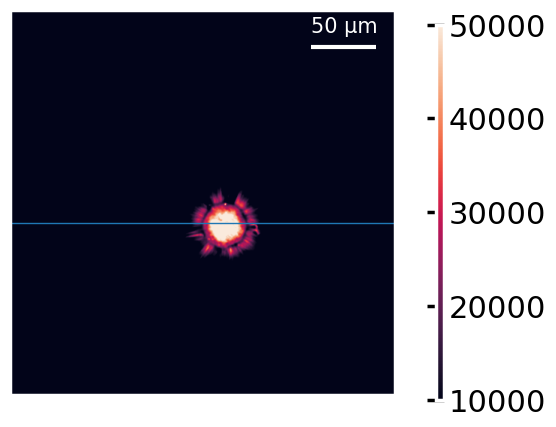

In [990]:
fig, ax = plt.subplots(figsize=(5, 5))
ax.imshow(RL100_Airyfiji513nm[len(RL100_Airyfiji513nm)//2], vmin=10000, vmax=50000)
# ax.plot([1700, 1700+(100/umperpxXYnov7)], [100, 100], color='w', solid_capstyle='butt')
# ax.text(1650, 80, '100 µm', color='w', fontsize='15')
ax.axhline(628-(600-512//2), lw=1)

# ax[1].imshow(RL100_Airyfiji513nm[500:700, 860:1060], vmin=10000, vmax=50000)
ax.plot([400, 400+(50/umperpxXYnov7)], [50, 50], color='w', solid_capstyle='butt')
ax.text(400, 30, '50 µm', color='w', fontsize='15')

ax.set_xticklabels([])
ax.set_yticklabels([])

#### colorbar ####
cax = fig.add_axes([0.98, 0.1, 0.015, 0.75])  # horizontal [left, bottom, width, height]
cbar = fig.colorbar(plt.cm.ScalarMappable(norm=mcolors.Normalize(vmin=10000, vmax=50000)),
                    cax=cax, 
                    orientation='vertical')
cbarbot.ax.tick_params(labelsize=20)

#plt.savefig('../../analyzed_data/aster/zstacks/20250806Analysis/20250806nov7asterbs.pdf', bbox_inches='tight')

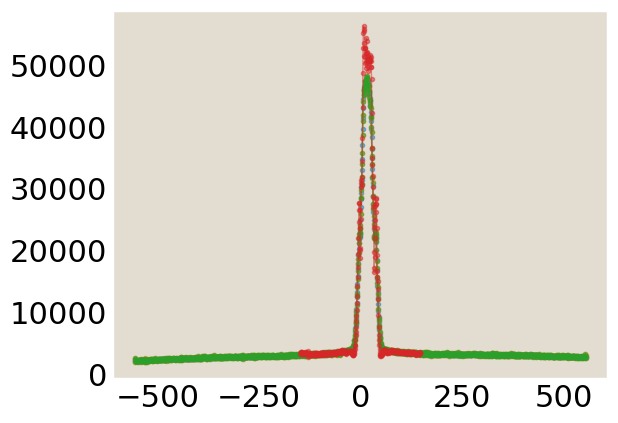

In [991]:
yslice =628
fig, ax = plt.subplots()
plt.plot((np.arange(len(Nov7MotorsbsSlice81infiji_[yslice]))-len(Nov7MotorsbsSlice81infiji_[yslice])//2)*umperpxXYnov7, 
         Nov7MotorsbsSlice81infiji_[yslice],
         'o-',  ms=3, lw=1, label='raw', alpha=.5)
plt.plot((np.arange(len(RL50_513nmSlice81[yslice]))-len(RL50_513nmSlice81[yslice])//2)*umperpxXYnov7, 
         RL50_513nmSlice81[yslice], 
         'o-', lw=1, ms=3, label='fiji 50it airy deconv', alpha=.5)
plt.plot((np.arange(len(RL50_Gauss513nmSlice81Fiji_0p33xy2p25z[yslice]))-len(RL50_Gauss513nmSlice81Fiji_0p33xy2p25z[yslice])//2)*umperpxXYnov7, 
         RL50_Gauss513nmSlice81Fiji_0p33xy2p25z[yslice], 
         'o-', lw=1, ms=3, label='fiji 50it airy deconv', alpha=.5)
plt.plot((np.arange(len(RL100_Airyfiji513nm[0, 0]))-len(RL100_Airyfiji513nm[0, 0])//2)*umperpxXYnov7, 
         RL100_Airyfiji513nm[len(RL100_Airyfiji513nm)//2, yslice-(600-512//2)], 
         'o-', lw=1, ms=3, label='fiji 100it airy deconv 3d', alpha=.5)
#plt.legend()